# FINAL NOTEBOOK G2
This notebook is part of Business challenge for Hult International Business School. As a team we analyzed natural disasters through various sources and made some key insights. We leveraged previous experiences to automate processes to extract run the file with one click of a button. We also extracted and plotted SHP and TIF files on a map.

# SCRAPPING

## Install & Import libraries
For best practices, we have here first all the pip and import libraries needed.

In [ ]:
# Install necessary libraries if not already installed (uncomment and run if needed)
!pip install pandas
!pip install numpy
!pip install seaborn
!pip install matplotlib
!pip install geopandas
!pip install adjustText
!pip install geopandas contextily
!pip install rasterio
!pip install cartopy
!pip install matplotlib numpy rasterio
!pip install cartopy rasterio matplotlib
!pip install contextily


In [ ]:
import pandas as pd            # Data handling and analysis
import numpy as np             # Numerical operations
import seaborn as sns           # Statistical data visualization
import matplotlib.pyplot as plt  # Creating plots and charts
import geopandas as gpd         # Working with geospatial data
import os                      # Interacting with the operating system
import glob                    # Finding files matching a pattern
import matplotlib.colors as mcolors  # Color management for plots
import matplotlib.patches as mpatches # Creating shapes for plots
from mpl_toolkits.axes_grid1 import make_axes_locatable  # Plot layout adjustments
import contextily as ctx       # Adding basemaps to maps
import requests                # Making HTTP requests
from bs4 import BeautifulSoup   # Parsing HTML and XML
from requests.adapters import HTTPAdapter # HTTP connection management
from urllib3.util.retry import Retry     # Retrying failed HTTP requests
import zipfile                 # Working with ZIP archives
import re                      # Regular expressions for text processing
import time                    # Time-related functions
from rasterio.plot import show
from shapely.geometry import Point
from matplotlib.patches import Patch, Rectangle
from rasterio.mask import mask
from scipy.stats import gaussian_kde
from shapely.geometry import box
import random  # Shuffle colors for better distinction

from google.colab import drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import re
import rasterio
import geopandas as gpd
from rasterio.plot import show
from shapely.geometry import Point
import contextily as ctx
from shapely.geometry import box


Then we conncect to our group drive

In [ ]:
import geopandas as gpd

from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## Scrapping data from the Copernico




We developed an API request that automates gathering disaster data, cutting the time from 6 hours to just 1 hour. This tool pulls data from the Copernicus Emergency Management Service website, which tracks natural disasters globally.

The API request targets the latest available data for specific countries and hazards (which can be adjusted).

In [ ]:
# ✅ API URL
API_URL = "https://mapping.emergency.copernicus.eu/activations/api/activations/"

# ✅ European Countries prone to floods/wildfires
COUNTRIES = {
    "FR": "France",
    "DE": "Germany",
    "IT": "Italy"
}

# ✅ Output folder for CSVs
OUTPUT_DIR = "/content/ESMR_Info_CSVs"
os.makedirs(OUTPUT_DIR, exist_ok=True)

def fetch_esmr_info(country_code, country_name):
    """
    Fetches ESMR data for a given country and saves it as a CSV.
    """
    params = {
        "categories": "storm", #Change this for the hazards you decide :) Available inputs: fire,volcan,earthquake,mass,storm,flood,humanitarian,industrial,environment,other\",\n
        "activationTime": "2012-01,2025-2",
        "countries": country_code,
        "services": "",
        "closed": "",
        "limit": 5000,
        "q": ""
    }

    response = requests.get(API_URL, params=params)
    response.raise_for_status()  # Raises an error for failed requests
    data = response.json()

    esmr_info = []

    for item in data.get("results", []):
        esmr_id = item.get("code", "N/A")
        event_name = item.get("name", "N/A")
        category_slug = item.get("category", {}).get("slug", "N/A")
        category_name = item.get("category", {}).get("name", "N/A")

        esmr_info.append({
            "ESMR_ID": esmr_id,
            "Event_Name": event_name,
            "Category_Slug": category_slug,
            "Category_Name": category_name
        })

    # Convert to DataFrame
    df = pd.DataFrame(esmr_info)

    # Save CSV
    file_path = os.path.join(OUTPUT_DIR, f"{country_name}_ESMR_Info.csv")
    df.to_csv(file_path, index=False)

    print(f"✅ Saved {len(df)} records for {country_name} to {file_path}")

# ✅ Loop through all selected countries
for code, name in COUNTRIES.items():
    fetch_esmr_info(code, name)

print("🎯 All country data saved successfully!")


✅ Saved 9 records for France to /content/ESMR_Info_CSVs/France_ESMR_Info.csv
✅ Saved 5 records for Germany to /content/ESMR_Info_CSVs/Germany_ESMR_Info.csv
✅ Saved 3 records for Italy to /content/ESMR_Info_CSVs/Italy_ESMR_Info.csv
🎯 All country data saved successfully!


In [ ]:
# ✅ Base URL for activations
BASE_URL = "https://mapping.emergency.copernicus.eu/activations/"

# ✅ Path where ESMR Info CSVs are stored
DATA_PATH = "/content/ESMR_Info_CSVs"

# ✅ Path where ZIP files will be saved
DOWNLOAD_BASE_PATH = "/content/Copernicus_Downloads"

# ✅ Path to save missing EMSR IDs
MISSING_AWS_CSV = "missing_aws_emsr_ids.csv"

# ✅ Ensure download folder exists
os.makedirs(DOWNLOAD_BASE_PATH, exist_ok=True)

# ✅ Get all CSV files (each country)
csv_files = [f for f in os.listdir(DATA_PATH) if f.endswith("_ESMR_Info.csv")]

# ✅ List to store EMSR IDs missing AWS vector ZIP
missing_aws_emsr_ids = []

def create_folder_structure(country, category):
    """
    Creates a structured folder for each country-category combination.
    """
    folder_name = f"{country}_{category.replace(' ', '_')}_SHP_Zip"
    folder_path = os.path.join(DOWNLOAD_BASE_PATH, folder_name)
    os.makedirs(folder_path, exist_ok=True)
    return folder_path

def download_zip_file(file_url, save_path):
    """
    Handles downloading of ZIP files and saving to disk.
    """
    try:
        response = requests.get(file_url, stream=True, timeout=15)
        response.raise_for_status()

        with open(save_path, "wb") as f:
            for chunk in response.iter_content(chunk_size=1024):
                f.write(chunk)
        print(f"✅ Downloaded: {save_path}")

    except requests.RequestException as e:
        print(f"❌ Failed to download {file_url}: {e}")

def fetch_and_save_zip_files(emsr_code, folder_path):
    """
    Fetches relevant ZIP files from Copernicus and Rapid Mapping.
    """
    activation_url = f"{BASE_URL}{emsr_code}/"
    print(f"🔎 Checking: {activation_url}")

    try:
        # Request the activation page
        response = requests.get(activation_url, timeout=10)
        response.raise_for_status()

        # Parse HTML for links
        soup = BeautifulSoup(response.text, "html.parser")
        links = soup.find_all("a", href=True)

        found_vector_zip = False  # Flag to track if we find a vector ZIP

        # ✅ Primary Method: Fetch Amazon S3 vector.zip files
        for link in links:
            file_url = link["href"]
            file_url_lower = file_url.lower()

            if "gra" in file_url_lower and "vector.zip" in file_url_lower and "delineation" not in file_url_lower:
                full_url = file_url if file_url.startswith("http") else f"https://cems-mapping-website.s3.eu-west-1.amazonaws.com{file_url}"
                file_name = os.path.join(folder_path, full_url.split("/")[-1])

                print(f"📥 Downloading: {full_url}")
                download_zip_file(full_url, file_name)
                found_vector_zip = True  # ✅ Vector ZIP found, no need for fallback

        # ✅ If AWS vector.zip is missing, log EMSR ID for later processing
        if not found_vector_zip:
            print(f"⚠️ No AWS vector ZIP found for {emsr_code}, adding to missing list...")
            missing_aws_emsr_ids.append(emsr_code)

    except requests.RequestException as e:
        print(f"❌ Error accessing {activation_url}: {e}")

# ✅ Process each country's CSV
for csv_file in csv_files:
    country_name = csv_file.replace("_ESMR_Info.csv", "")  # Extract country name
    file_path = os.path.join(DATA_PATH, csv_file)

    # Load data
    df = pd.read_csv(file_path)

    # ✅ Group by category
    for category_name in df["Category_Name"].unique():
        category_df = df[df["Category_Name"] == category_name]

        # ✅ Create folder for this country & category
        folder_path = create_folder_structure(country_name, category_name)

        # ✅ Loop through ESMR IDs and fetch ZIP files
        for _, row in category_df.iterrows():
            emsr_code = row["ESMR_ID"].strip()
            fetch_and_save_zip_files(emsr_code, folder_path)

# ✅ Save missing AWS EMSR IDs to CSV
if missing_aws_emsr_ids:
    missing_df = pd.DataFrame(missing_aws_emsr_ids, columns=["EMSR_ID"])
    missing_df.to_csv(MISSING_AWS_CSV, index=False)
    print(f"⚠️ Missing AWS EMSR IDs saved to {MISSING_AWS_CSV}")

print("🎯 All downloads completed successfully!")

🔎 Checking: https://mapping.emergency.copernicus.eu/activations/EMSR642/
⚠️ No AWS vector ZIP found for EMSR642, adding to missing list...
🔎 Checking: https://mapping.emergency.copernicus.eu/activations/EMSR334/
⚠️ No AWS vector ZIP found for EMSR334, adding to missing list...
🔎 Checking: https://mapping.emergency.copernicus.eu/activations/EMSR225/
📥 Downloading: https://cems-mapping-website.s3.eu-west-1.amazonaws.com/static/activations/EMSR225/EMSR225_01SANVITO_02GRADING_MAP_v1_vector.zip
✅ Downloaded: /content/Copernicus_Downloads/Italy_Storm_SHP_Zip/EMSR225_01SANVITO_02GRADING_MAP_v1_vector.zip
📥 Downloading: https://cems-mapping-website.s3.eu-west-1.amazonaws.com/static/activations/EMSR225/EMSR225_02PONTEBBA_02GRADING_MAP_v2_vector.zip
✅ Downloaded: /content/Copernicus_Downloads/Italy_Storm_SHP_Zip/EMSR225_02PONTEBBA_02GRADING_MAP_v2_vector.zip
📥 Downloading: https://cems-mapping-website.s3.eu-west-1.amazonaws.com/static/activations/EMSR225/EMSR225_03CODROIPO_02GRADING_MAP_v1_vecto

In [ ]:
# ✅ Base Paths
DATA_PATH = "/content/ESMR_Info_CSVs"  # Where CSVs are stored
DOWNLOAD_BASE_PATH = "/content/Copernicus_Downloads"
MISSING_AWS_CSV = "missing_aws_emsr_ids.csv"

# ✅ Load missing AWS EMSR IDs
if os.path.exists(MISSING_AWS_CSV):
    missing_df = pd.read_csv(MISSING_AWS_CSV)
    missing_emsr_ids = missing_df["EMSR_ID"].tolist()
else:
    missing_emsr_ids = []

# ✅ List of Random User-Agents
USER_AGENTS = [
    "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/110.0.0.0 Safari/537.36",
    "Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/100.0.4896.127 Safari/537.36",
    "Mozilla/5.0 (Windows NT 10.0; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Firefox/95.0",
    "Mozilla/5.0 (Linux; Android 11) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/103.0.5060.71 Mobile Safari/537.36",
]

# ✅ Optional: List of Proxies (Use if needed)
PROXIES = [
    "http://proxy1.example.com:8080",
    "http://proxy2.example.com:8080",
]
USE_PROXIES = False  # Set to True if using proxies

# ✅ Mapping of EMSR IDs to Country & Category
emsr_to_country_category = {}

# ✅ Load all country CSVs and extract EMSR mappings
csv_files = [f for f in os.listdir(DATA_PATH) if f.endswith("_ESMR_Info.csv")]

for csv_file in csv_files:
    country_name = csv_file.replace("_ESMR_Info.csv", "")  # Extract country name
    df = pd.read_csv(os.path.join(DATA_PATH, csv_file))

    for _, row in df.iterrows():
        emsr_code = row["ESMR_ID"].strip()
        category = row["Category_Name"].strip()
        folder_name = f"{country_name}_{category.replace(' ', '_')}_SHP_Zip"
        emsr_to_country_category[emsr_code] = os.path.join(DOWNLOAD_BASE_PATH, folder_name)

# ✅ Function to create structured folder
def create_folder_structure(emsr_code):
    """Creates a structured folder based on country and category."""
    folder_path = emsr_to_country_category.get(emsr_code, os.path.join(DOWNLOAD_BASE_PATH, f"{emsr_code}_Unknown_SHP_Zip"))
    os.makedirs(folder_path, exist_ok=True)
    return folder_path

# ✅ Function to fetch ZIP files
def fetch_grading_zip_files(emsr_code, folder_path):
    """
    Tries to download Grading ZIP files for missing AWS vector.zip files.
    Implements:
    - Random User-Agent rotation
    - Proxy support (optional)
    - Exponential backoff + jitter for 429 errors
    - Respects `Retry-After` header if provided
    """

    base_url = f"https://rapidmapping.emergency.copernicus.eu/backend/{emsr_code}"
    print(f"⚠️ No AWS vector ZIP for {emsr_code}, trying AOI-based ZIPs...")

    session = requests.Session()

    for aoi_num in range(1, 11):  # Try AOI01 to AOI50
        aoi_id = f"AOI{str(aoi_num).zfill(2)}"

        zip_urls = [
            f"{base_url}/{aoi_id}/GRA_PRODUCT/{emsr_code}_{aoi_id}_GRA_PRODUCT_v2.zip",
            f"{base_url}/{aoi_id}/GRA_PRODUCT/{emsr_code}_{aoi_id}_GRA_PRODUCT_v1.zip"
        ]

        file_names = [
            os.path.join(folder_path, f"{emsr_code}_{aoi_id}_GRA_PRODUCT_v2.zip"),
            os.path.join(folder_path, f"{emsr_code}_{aoi_id}_GRA_PRODUCT_v1.zip")
        ]

        for zip_url, file_name in zip(zip_urls, file_names):
            print(f"🔄 Trying AOI ZIP: {zip_url}")

            attempt = 0
            while attempt < 5:  # Retry up to 5 times per URL
                try:
                    headers = {"User-Agent": random.choice(USER_AGENTS)}
                    proxies = {"http": random.choice(PROXIES), "https": random.choice(PROXIES)} if USE_PROXIES else None

                    response = session.get(zip_url, headers=headers, proxies=proxies, stream=True, timeout=10)

                    if response.status_code == 200:
                        with open(file_name, "wb") as f:
                            for chunk in response.iter_content(chunk_size=1024):
                                f.write(chunk)
                        print(f"✅ Downloaded: {file_name}")
                        break  # Stop trying this AOI after successful download

                    elif response.status_code == 404:
                        print(f"⚠️ AOI {aoi_id} not found for {emsr_code}, trying next AOI...")
                        break  # No need to retry a 404 error

                    elif response.status_code == 429:
                        retry_after = response.headers.get("Retry-After")
                        wait_time = int(retry_after) if retry_after else random.uniform(10, 60)  # Random wait
                        print(f"🚧 Rate limited (429). Retrying in {int(wait_time)} seconds...")
                        time.sleep(wait_time)
                        attempt += 1

                    else:
                        print(f"⚠️ Unexpected status ({response.status_code}) for {zip_url}, retrying...")
                        time.sleep(random.uniform(2, 8))  # Small random delay before retrying
                        attempt += 1

                except requests.RequestException as e:
                    print(f"❌ Error fetching {zip_url}: {e}")
                    time.sleep(random.uniform(2, 8))  # Small random delay before retrying
                    attempt += 1  # Retry this URL

# ✅ Process missing EMSR IDs with extra delay between each
for emsr_code in missing_emsr_ids:
    folder_path = create_folder_structure(emsr_code)
    fetch_grading_zip_files(emsr_code, folder_path)

print("🎯 **All AOI Grading ZIP downloads completed!**")

⚠️ No AWS vector ZIP for EMSR642, trying AOI-based ZIPs...
🔄 Trying AOI ZIP: https://rapidmapping.emergency.copernicus.eu/backend/EMSR642/AOI01/GRA_PRODUCT/EMSR642_AOI01_GRA_PRODUCT_v2.zip
⚠️ AOI AOI01 not found for EMSR642, trying next AOI...
🔄 Trying AOI ZIP: https://rapidmapping.emergency.copernicus.eu/backend/EMSR642/AOI01/GRA_PRODUCT/EMSR642_AOI01_GRA_PRODUCT_v1.zip
⚠️ AOI AOI01 not found for EMSR642, trying next AOI...
🔄 Trying AOI ZIP: https://rapidmapping.emergency.copernicus.eu/backend/EMSR642/AOI02/GRA_PRODUCT/EMSR642_AOI02_GRA_PRODUCT_v2.zip
⚠️ AOI AOI02 not found for EMSR642, trying next AOI...
🔄 Trying AOI ZIP: https://rapidmapping.emergency.copernicus.eu/backend/EMSR642/AOI02/GRA_PRODUCT/EMSR642_AOI02_GRA_PRODUCT_v1.zip
⚠️ AOI AOI02 not found for EMSR642, trying next AOI...
🔄 Trying AOI ZIP: https://rapidmapping.emergency.copernicus.eu/backend/EMSR642/AOI03/GRA_PRODUCT/EMSR642_AOI03_GRA_PRODUCT_v2.zip
⚠️ AOI AOI03 not found for EMSR642, trying next AOI...
🔄 Trying AOI ZIP

In [ ]:
# Define source and destination directories
source_dir = "/content/Copernicus_Downloads"  # The directory containing downloaded ZIPs
dest_dir = "/content/Copernicus_Downloads_Unzipped"  # Directory for extracted files

# Ensure the destination directory exists
os.makedirs(dest_dir, exist_ok=True)

# Regex pattern to extract EMSR ID (e.g., "EMSR139")
emsr_pattern = re.compile(r"(EMSR\d+)")

# Loop through each country-category folder
for country_category in os.listdir(source_dir):
    country_category_path = os.path.join(source_dir, country_category)

    # Ensure it's a directory (skip files)
    if not os.path.isdir(country_category_path):
        continue

    print(f"📂 Processing: {country_category}")

    # Create corresponding unzipped folder
    unzipped_folder = os.path.join(dest_dir, f"{country_category}_Unzipped")
    os.makedirs(unzipped_folder, exist_ok=True)

    # Process each ZIP file inside the folder
    for file in os.listdir(country_category_path):
        if file.endswith(".zip"):
            file_path = os.path.join(country_category_path, file)

            # Extract EMSR ID
            emsr_match = emsr_pattern.search(file)
            if emsr_match:
                emsr_id = emsr_match.group(1)
            else:
                print(f"⚠️ Skipping {file} (No EMSR ID found)")
                continue

            # Create EMSR-specific extraction folder
            emsr_unzipped_path = os.path.join(unzipped_folder, emsr_id)
            os.makedirs(emsr_unzipped_path, exist_ok=True)

            print(f"📤 Extracting {file} to {emsr_unzipped_path}")

            # Extract ZIP file
            try:
                with zipfile.ZipFile(file_path, "r") as zip_ref:
                    zip_ref.extractall(emsr_unzipped_path)
                print(f"✅ Successfully extracted {file} to {emsr_unzipped_path}")
            except zipfile.BadZipFile:
                print(f"❌ Corrupt ZIP file: {file}")
            except Exception as e:
                print(f"❌ Error extracting {file}: {e}")

print("🎉 All files extracted and organized successfully!")


📂 Processing: Italy_Storm_SHP_Zip
📤 Extracting EMSR225_03CODROIPO_02GRADING_MAP_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/Italy_Storm_SHP_Zip_Unzipped/EMSR225
✅ Successfully extracted EMSR225_03CODROIPO_02GRADING_MAP_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/Italy_Storm_SHP_Zip_Unzipped/EMSR225
📤 Extracting EMSR225_01SANVITO_02GRADING_MAP_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/Italy_Storm_SHP_Zip_Unzipped/EMSR225
✅ Successfully extracted EMSR225_01SANVITO_02GRADING_MAP_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/Italy_Storm_SHP_Zip_Unzipped/EMSR225
📤 Extracting EMSR225_02PONTEBBA_02GRADING_MAP_v2_vector.zip to /content/Copernicus_Downloads_Unzipped/Italy_Storm_SHP_Zip_Unzipped/EMSR225
✅ Successfully extracted EMSR225_02PONTEBBA_02GRADING_MAP_v2_vector.zip to /content/Copernicus_Downloads_Unzipped/Italy_Storm_SHP_Zip_Unzipped/EMSR225
📤 Extracting EMSR225_04MORSANO_02GRADING_MAP_v2_vector.zip to /content/Copernicus_Downloads_Unzipp

To see everyting unzipped we plotted in this case the flood information for the european countries

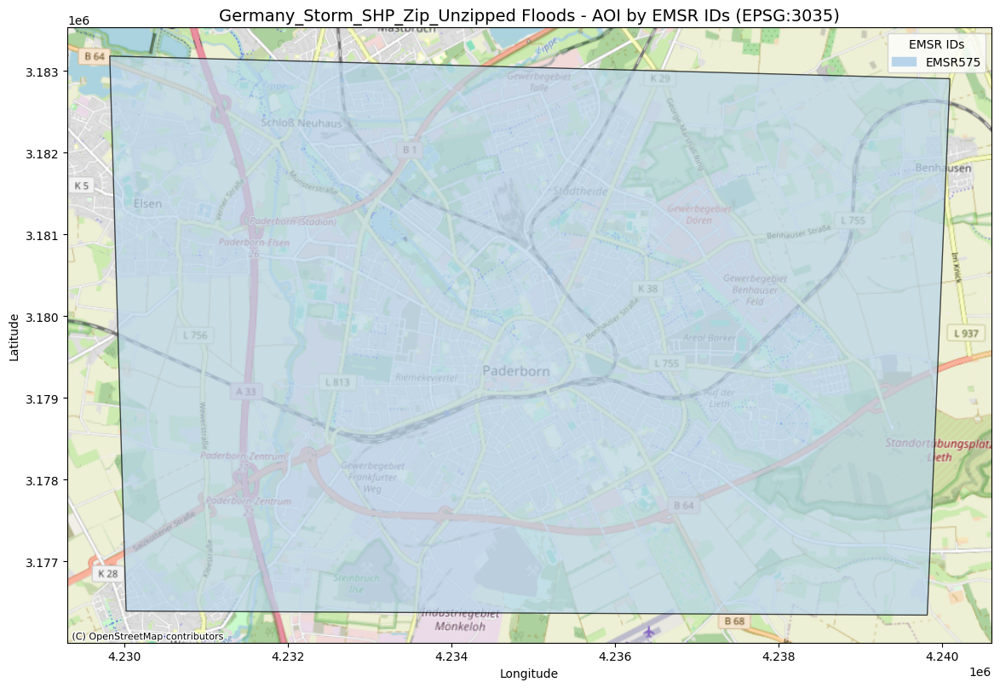

Plot saved for Germany_Storm_SHP_Zip_Unzipped in plot_images/Germany_Storm_SHP_Zip_Unzipped/flood


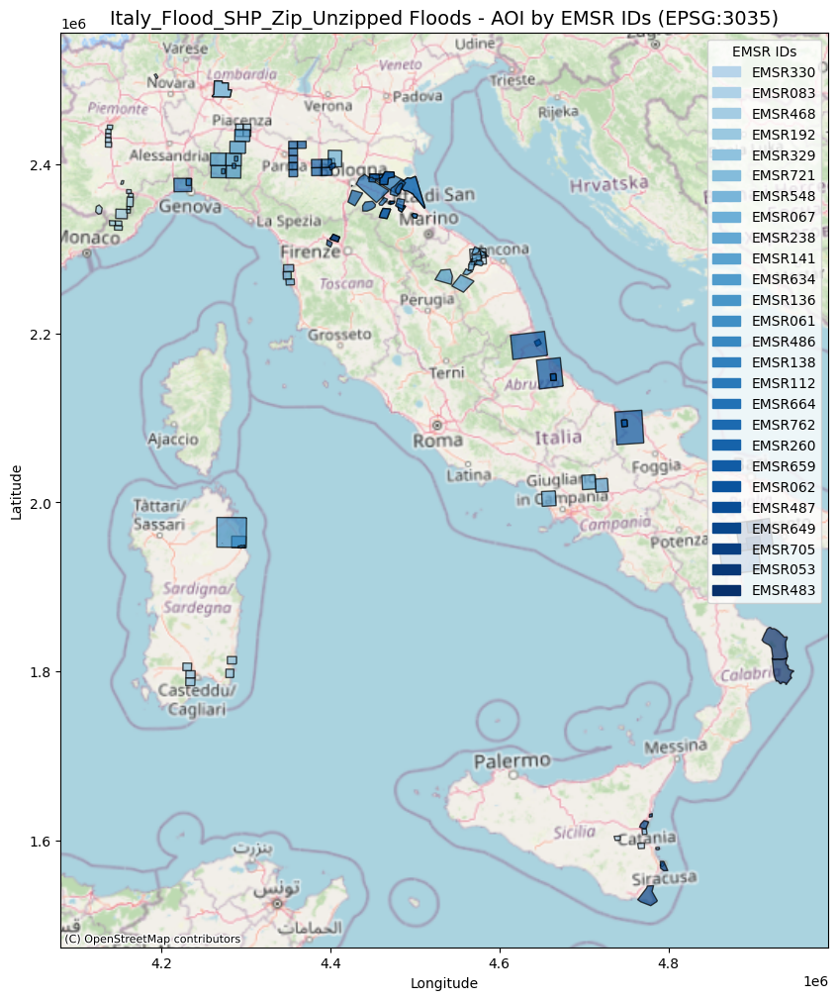

Plot saved for Italy_Flood_SHP_Zip_Unzipped in plot_images/Italy_Flood_SHP_Zip_Unzipped/flood


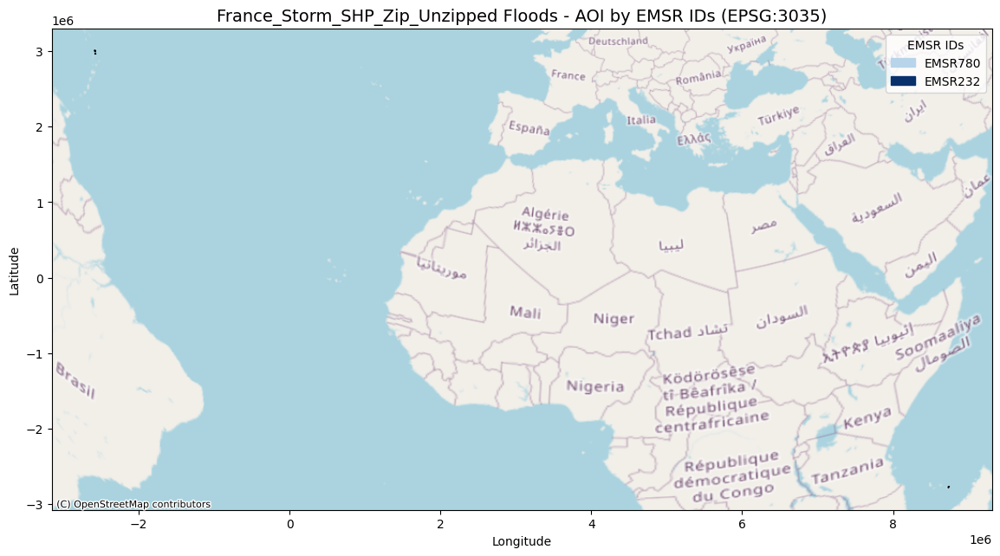

Plot saved for France_Storm_SHP_Zip_Unzipped in plot_images/France_Storm_SHP_Zip_Unzipped/flood


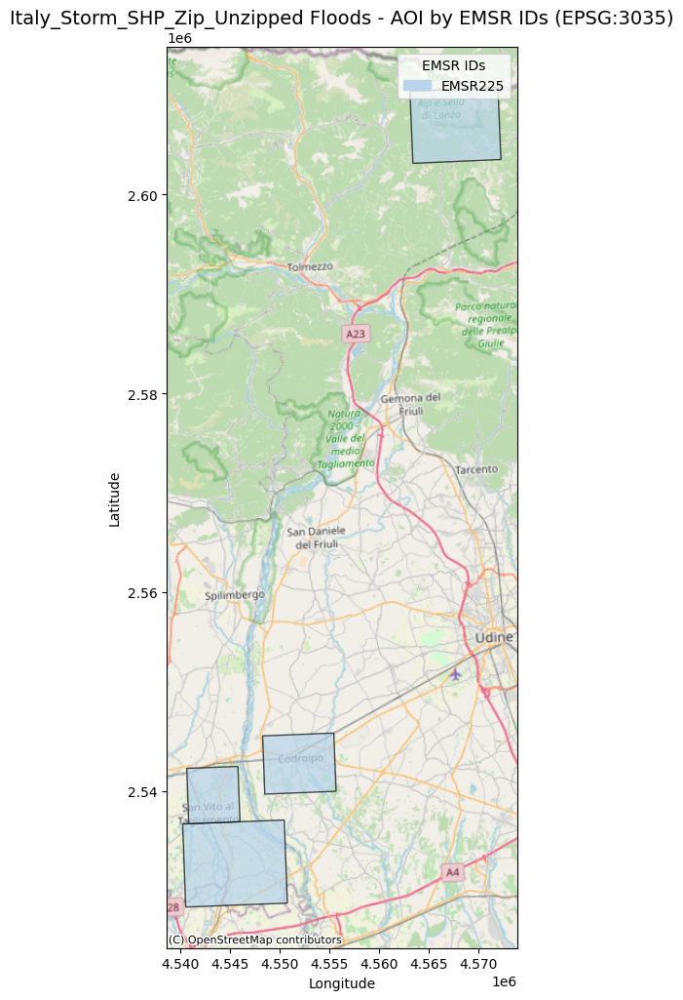

Plot saved for Italy_Storm_SHP_Zip_Unzipped in plot_images/Italy_Storm_SHP_Zip_Unzipped/flood


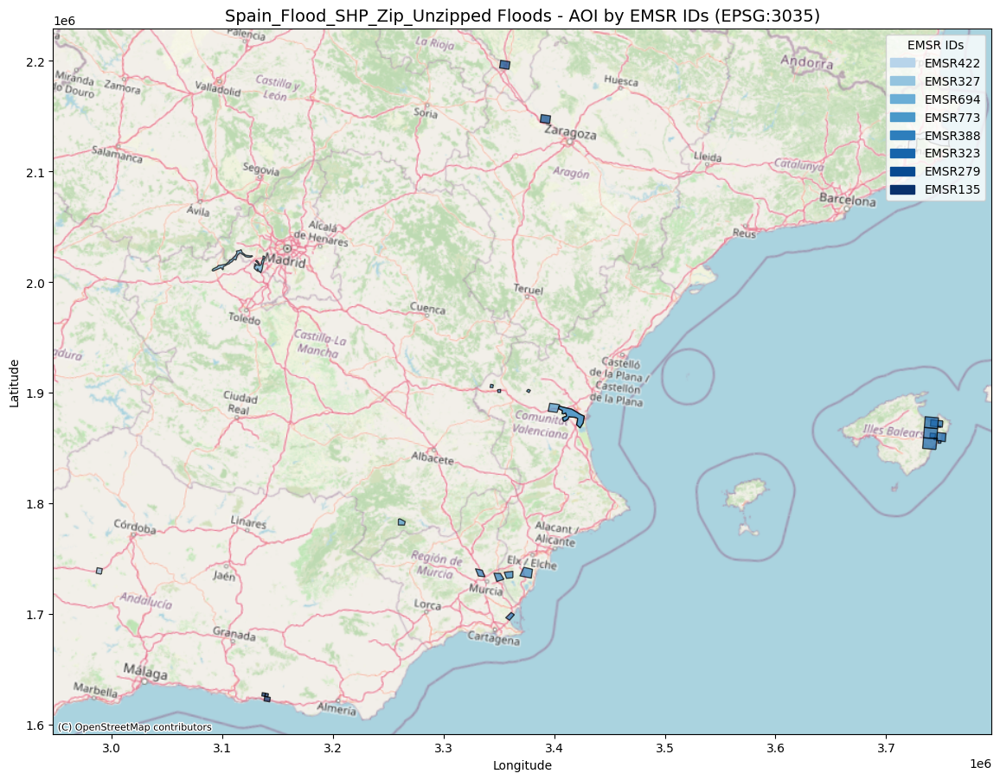

Plot saved for Spain_Flood_SHP_Zip_Unzipped in plot_images/Spain_Flood_SHP_Zip_Unzipped/flood


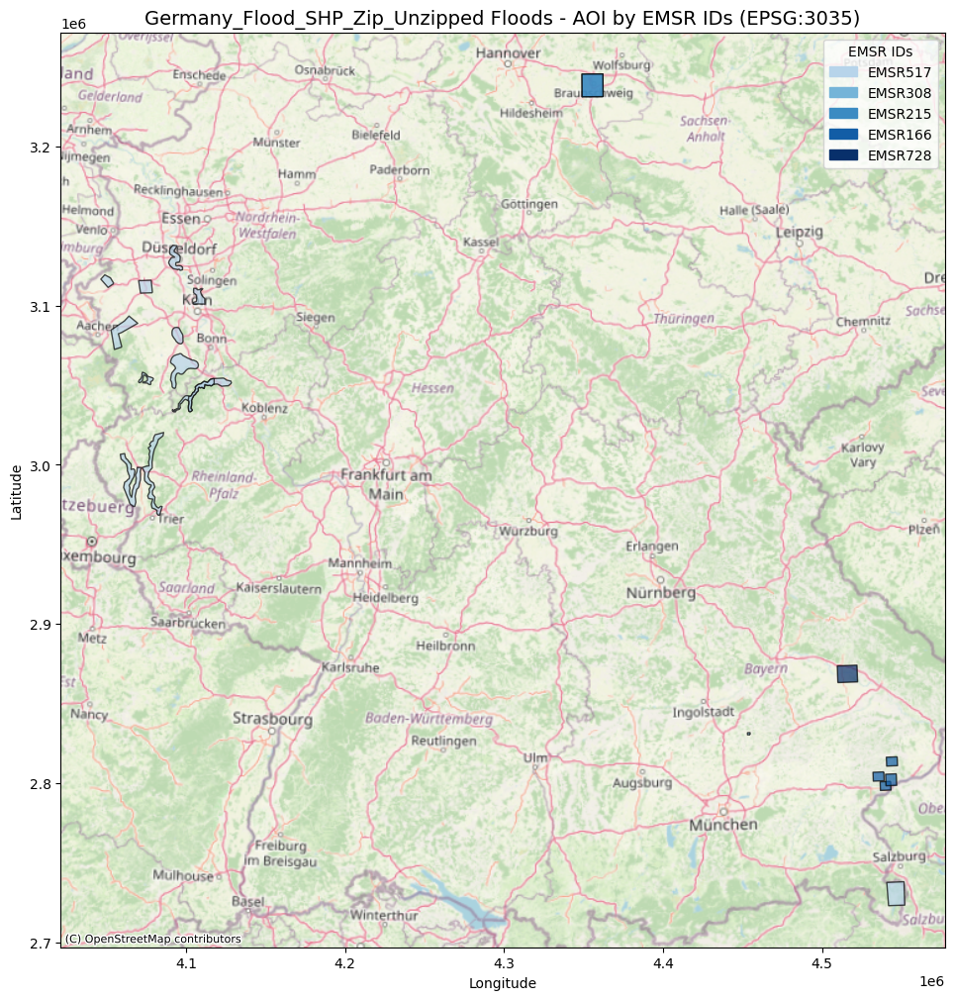

Plot saved for Germany_Flood_SHP_Zip_Unzipped in plot_images/Germany_Flood_SHP_Zip_Unzipped/flood


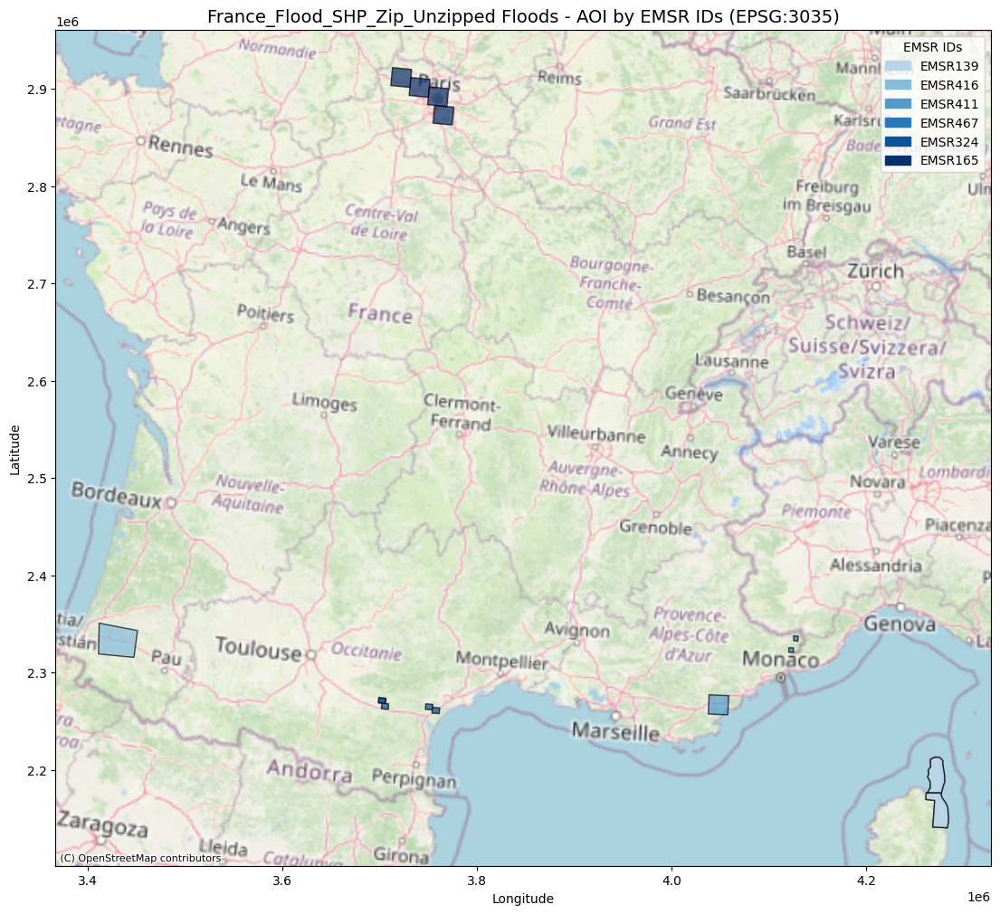

Plot saved for France_Flood_SHP_Zip_Unzipped in plot_images/France_Flood_SHP_Zip_Unzipped/flood


In [ ]:

# Define the base directory where country folders are stored
base_path = "/content/Copernicus_Downloads_Unzipped"

# Get all country folders inside base_path
country_folders = [f for f in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, f))]

for country in country_folders:
    country_path = os.path.join(base_path, country)
    emsr_ids = [folder for folder in os.listdir(country_path) if folder.startswith("EMSR")]

    shapefiles = []
    emsr_mapping = {}  # Store EMSR ID for each shapefile

    for emsr_id in emsr_ids:
        shp_files = glob.glob(os.path.join(country_path, emsr_id, "**", "*area*.shp"), recursive=True)
        for shp in shp_files:
            shapefiles.append(shp)
            emsr_mapping[shp] = emsr_id

    if not shapefiles:
        print(f"No shapefiles found for {country}!")
        continue

    # Load all shapefiles into a GeoDataFrame
    gdfs = []
    for shp in shapefiles:
        gdf = gpd.read_file(shp)
        if gdf.crs is not None and gdf.crs.to_epsg() != 3035:
            gdf = gdf.to_crs(epsg=3035)
        gdf["EMSR_ID"] = emsr_mapping[shp]
        gdfs.append(gdf)

    full_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))
    full_gdf = full_gdf.to_crs(epsg=3035)

    # Create a color map based on EMSR IDs
    unique_ids = full_gdf["EMSR_ID"].unique()
    colors = plt.cm.Blues(np.linspace(0.3, 1, len(unique_ids)))
    color_map = dict(zip(unique_ids, colors))

    # Plot the AOIs colored by EMSR ID
    fig, ax = plt.subplots(figsize=(14, 12))
    for emsr_id in unique_ids:
        subset = full_gdf[full_gdf["EMSR_ID"] == emsr_id]
        subset.plot(ax=ax, color=color_map[emsr_id], edgecolor="black", label=emsr_id, alpha=0.7)

    # Add basemap
    ctx.add_basemap(ax, crs=full_gdf.crs.to_string(), source=ctx.providers.OpenStreetMap.Mapnik)

    # Add legend
    legend_patches = [mpatches.Patch(color=color_map[emsr_id], label=emsr_id) for emsr_id in unique_ids]
    ax.legend(handles=legend_patches, title="EMSR IDs", loc="upper right")

    ax.set_title(f"{country} Floods - AOI by EMSR IDs (EPSG:3035)", fontsize=14)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

    # Save plot
    save_path = f"plot_images/{country}/flood"
    os.makedirs(save_path, exist_ok=True)
    plt.savefig(os.path.join(save_path, "flood_map.png"), dpi=300, bbox_inches='tight')
    plt.show()
    print(f"Plot saved for {country} in {save_path}")

Finally merge all the shp downloaded files to get a cleaned dataframe

In [ ]:
import os
import geopandas as gpd
import pandas as pd

def find_shp_files(directory):
    """Recursively finds all .shp files in the given directory and subdirectories."""
    shp_files = []
    for root, _, files in os.walk(directory):
        for file in files:
            if file.lower().endswith(".shp"):  # Look for .shp instead of .shx
                shp_files.append(os.path.join(root, file))
    return shp_files

def merge_shp_files(shp_files):
    """Merges all valid .shp files into a single GeoDataFrame."""
    all_gdfs = []

    for shp_path in shp_files:
        try:
            gdf = gpd.read_file(shp_path)  # Load the shapefile
            # Reproject to a common CRS (e.g., 'EPSG:4326' for WGS 84)
            gdf = gdf.to_crs("EPSG:4326")
            all_gdfs.append(gdf)
            print(f"✅ Loaded: {shp_path} ({len(gdf)} records)")
        except Exception as e:
            print(f"❌ Error reading {shp_path}: {e}")

    if all_gdfs:
        merged_gdf = pd.concat(all_gdfs, ignore_index=True)
        print(f"\n🎯 Merged {len(all_gdfs)} shapefiles into a DataFrame with {len(merged_gdf)} records.")
        return merged_gdf
    else:
        print("⚠️ No valid SHP files found.")
        return None

# Set the main directory where extracted shapefiles are stored
shp_directory = "/content/Copernicus_Downloads_Unzipped"  # Corrected directory path

# Find all .shp files (including subdirectories)
shp_files = find_shp_files(shp_directory)

# Merge and store the result
if shp_files:
    merged_gdf = merge_shp_files(shp_files)
    # Convert GeoDataFrame to Pandas DataFrame if needed
    merged_df = pd.DataFrame(merged_gdf)  # Convert to Pandas DataFrame
    print("\n✅ Merged data stored in 'merged_df' as a Pandas DataFrame.")
else:
    print("🚨 No .shp files found in the directory.")

✅ Loaded: /content/Copernicus_Downloads_Unzipped/Germany_Storm_SHP_Zip_Unzipped/EMSR575/EMSR575_AOI01_GRA_PRODUCT_naturalLandUseA_r1_v1.shp (126 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Germany_Storm_SHP_Zip_Unzipped/EMSR575/EMSR575_AOI01_GRA_PRODUCT_imageFootprintA_r1_v1.shp (57 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Germany_Storm_SHP_Zip_Unzipped/EMSR575/EMSR575_AOI01_GRA_PRODUCT_builtUpP_r1_v1.shp (31739 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Germany_Storm_SHP_Zip_Unzipped/EMSR575/EMSR575_AOI01_GRA_PRODUCT_areaOfInterestA_r1_v1.shp (1 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Germany_Storm_SHP_Zip_Unzipped/EMSR575/EMSR575_AOI01_GRA_PRODUCT_hydrographyL_r1_v1.shp (129 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Germany_Storm_SHP_Zip_Unzipped/EMSR575/EMSR575_AOI01_GRA_PRODUCT_transportationL_r1_v1.shp (12660 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Germany_Storm_SHP_Zip_Unzipped/EMSR5

/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: RuntimeWarning: /content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped/EMSR192/EMSR192_18MONCALIERI_02GRADING_v1_10000_general_information_poly.shp contains polygon(s) with rings with invalid winding order. Autocorrecting them, but that shapefile should be corrected using ogr2ogr for example.
  return ogr_read(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: RuntimeWarning: organizePolygons() received an unexpected geometry.  Either a polygon with interior rings, or a polygon with less than 4 points, or a non-Polygon geometry.  Return arguments as a collection.
  return ogr_read(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: RuntimeWarning: Geometry of polygon of fid 42 cannot be translated to Simple Geometry. All polygons will be contained in a multipolygon.
  return ogr_read(


✅ Loaded: /content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped/EMSR192/EMSR192_18MONCALIERI_02GRADING_v1_10000_general_information_poly.shp (59 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped/EMSR192/EMSR192_20CEVASOUTH_02GRADING_v1_9000_physiography_line.shp (66 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped/EMSR192/EMSR192_29BAGNASCO_02GRADING_v2_19000_utilities_poly_grading.shp (17 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped/EMSR192/EMSR192_31MONESI_02GRADING_v1_11000_area_of_interest.shp (1 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped/EMSR192/EMSR192_21GARESSIONORTH_02GRADING_v2_7000_area_of_interest.shp (1 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped/EMSR192/EMSR192_17TORINOLINGOTTO_02GRADING_v2_10000_crisis_information_poly_grading.shp (22 records)
✅ Loaded: /con

/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: RuntimeWarning: organizePolygons() received an unexpected geometry.  Either a polygon with interior rings, or a polygon with less than 4 points, or a non-Polygon geometry.  Return arguments as a collection.
  return ogr_read(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: RuntimeWarning: Geometry of polygon of fid 14 cannot be translated to Simple Geometry. All polygons will be contained in a multipolygon.
  return ogr_read(


✅ Loaded: /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR324/EMSR324_05VILLALIER V1_GRA_v1_observed_event_a.shp (54 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR324/EMSR324_05VILLALIER V1_GRA_v1_transportation_l.shp (42 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR324/EMSR324_08COURSAN_GRA_v1_built_up_p.shp (45 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR324/EMSR324_05VILLALIER V1_GRA_v1_area_of_interest_a.shp (1 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR324/EMSR324_06TREBES_GRA_v1_image_footprint_a.shp (2 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR324/EMSR324_05VILLALIER V1_GRA_v1_transportation_p.shp (2 records)
✅ Loaded: /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR324/EMSR324_07CUXAC_GRA_v1_h

In [ ]:
merged_df

,obj_type,name,info,damage_gra,det_method,notation,or_src_id,dmg_src_id,cd_value,geometry,...,hctdesc,long,intrpdesc,imp_assdes,Id,OBJECTID,Shape_Leng,Shape_Area,area_ha,elem_count
0,3-Forests and Semi-natural Areas,Unknown,313-Mixed forest,Not Analysed,Not Applicable,Not Applicable,992.0,997.0,Not Applicable,"POLYGON ((8.73258 51.73598, 8.73228 51.73615, ...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3-Forests and Semi-natural Areas,Unknown,311-Broad-leaved forest,Not Analysed,Not Applicable,Not Applicable,992.0,997.0,Not Applicable,"POLYGON ((8.79092 51.71775, 8.79057 51.71744, ...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3-Forests and Semi-natural Areas,Unknown,311-Broad-leaved forest,Not Analysed,Not Applicable,Not Applicable,992.0,997.0,Not Applicable,"MULTIPOLYGON (((8.73244 51.73845, 8.73224 51.7...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3-Forests and Semi-natural Areas,Unknown,311-Broad-leaved forest,Not Analysed,Not Applicable,Not Applicable,992.0,997.0,Not Applicable,"POLYGON ((8.77075 51.75104, 8.76953 51.75022, ...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3-Forests and Semi-natural Areas,Unknown,311-Broad-leaved forest,Not Analysed,Not Applicable,Not Applicable,992.0,997.0,Not Applicable,"POLYGON ((8.81641 51.7183, 8.81659 51.71756, 8...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((1.79945 48.97321, 1.79938 48.97321, ...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1017301,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((1.6974 49.06511, 1.69854 49.06374, 1...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1017302,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((1.70417 49.01041, 1.70517 49.0101, 1...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1017303,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((1.79436 49.08112, 1.79305 49.08056, ...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Donwloading Harci information

In [ ]:
# Define the download URL and save location
download_url = "https://figshare.com/ndownloader/articles/7777301/versions/5"
download_dir = "/content/HARCI_EU_Download_Zip"
file_name = "HARCI_EU.zip"

# Create the directory if it doesn’t exist
os.makedirs(download_dir, exist_ok=True)

# Full path for saving the file
file_path = os.path.join(download_dir, file_name)

print(f"📥 Downloading HARCI-EU dataset...")

# Download the file
try:
    response = requests.get(download_url, stream=True)
    response.raise_for_status()  # Ensure request was successful

    # Save the file in chunks
    with open(file_path, "wb") as f:
        for chunk in response.iter_content(chunk_size=8192):
            f.write(chunk)

    print(f"✅ Download complete: {file_path}")

except requests.RequestException as e:
    print(f"❌ Error downloading file: {e}")


📥 Downloading HARCI-EU dataset...
✅ Download complete: /content/HARCI_EU_Download_Zip/HARCI_EU.zip


In [ ]:
# Define paths
zip_file_path = "/content/HARCI_EU_Download_Zip/HARCI_EU.zip"
extract_to_path = "/content/HARCI_EU_Download_Unzipped"

# Create the output directory if it doesn’t exist
os.makedirs(extract_to_path, exist_ok=True)

print(f"📂 Extracting contents of {zip_file_path}...")

# Unzip the file
try:
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to_path)
    print(f"✅ Extraction complete! Files saved in: {extract_to_path}")
except zipfile.BadZipFile:
    print("❌ Error: The ZIP file is corrupt or invalid.")


📂 Extracting contents of /content/HARCI_EU_Download_Zip/HARCI_EU.zip...
✅ Extraction complete! Files saved in: /content/HARCI_EU_Download_Unzipped


Plot an awesome graph!

Original CRS: IGNF:ETRS89LAEA


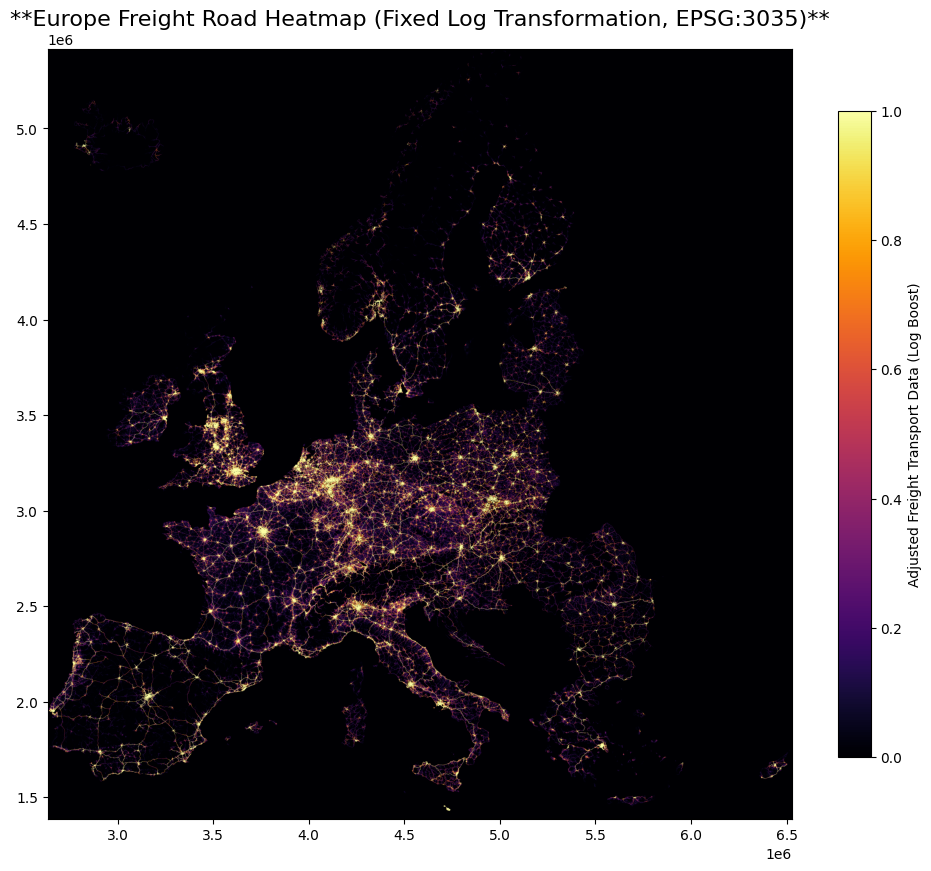

In [ ]:
# File path (Update this if needed)
file_path = "/content/HARCI_EU_Download_Unzipped/ci_tra01.tif"  # Change this to the correct file location

# Open the raster file
with rasterio.open(file_path) as src:
    print(f"Original CRS: {src.crs}")  # Should print EPSG:3035

    # Read raster data and mask NoData values
    data = src.read(1)
    data_masked = np.ma.masked_where(data == src.nodata, data)

    # Get full dataset extent
    xmin, xmax = src.bounds.left, src.bounds.right
    ymin, ymax = src.bounds.bottom, src.bounds.top

# Replace NaNs and negative values with 0 before log transformation
data_boosted = np.where(np.isnan(data_masked), 0, data_masked)
data_boosted = np.where(data_boosted < 0, 0, data_boosted)  # Ensure all values are non-negative

# Apply log transformation safely
data_boosted = np.log1p(data_boosted)

# Normalize between 5th and 99th percentile (stronger contrast)
valid_values = data_boosted[~np.isnan(data_boosted)]  # Only use valid (non-NaN) values
data_min, data_max = np.percentile(valid_values, [5, 99])
data_boosted = (data_boosted - data_min) / (data_max - data_min)
data_boosted = np.clip(data_boosted, 0, 1)  # Keep values within valid range

# Create a **high-contrast** Europe-wide plot
fig, ax = plt.subplots(figsize=(12, 12))

# Show the heatmap with better visibility
show(data_boosted, transform=src.transform, ax=ax, cmap="inferno", alpha=1.0)

# Set zoom limits for full dataset extent
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# Add colorbar
cbar = plt.colorbar(ax.images[0], ax=ax, orientation="vertical", shrink=0.7)
cbar.set_label("Adjusted Freight Transport Data (Log Boost)")

# Set title
ax.set_title("**Europe Freight Road Heatmap (Fixed Log Transformation, EPSG:3035)**", fontsize=16)

import os

# Define the save path
save_path = "plot_images/france/flood"
os.makedirs(save_path, exist_ok=True)  # Ensure the directory exists

# Save the plot as an image
plt.savefig(os.path.join(save_path, "1.png"), dpi=300, bbox_inches='tight')

# Show the plot
plt.show()


With this we are ready to analyze!

## In case you dont have in your content all the files open this section

Connect to the path were you have your zip files (Only change the paths for example in this case all the ESMR for spain)  

In [ ]:
# Define paths
zip_folder_path = "/content/drive/MyDrive/Business Challenge II - Team 2/data/wildfires/spain_wildfire/Spain_Wildfire_SHP_Zip"
extract_to_path = "/content/Wildfire_Unzipped"

# Create the output directory if it doesn't exist
os.makedirs(extract_to_path, exist_ok=True)

# Get a list of all zip files in the folder
zip_files = [f for f in os.listdir(zip_folder_path) if f.endswith(".zip")]

# Download and extract each zip file
for zip_file in zip_files:
    zip_file_path = os.path.join(zip_folder_path, zip_file)
    print(f"📂 Processing: {zip_file}")


    # Extract the zip file
    try:
        with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
            zip_ref.extractall(extract_to_path)
        print(f"✅ Extraction complete! Files saved in: {extract_to_path}")
    except zipfile.BadZipFile:
        print(f"❌ Error: The ZIP file '{zip_file}' is corrupt or invalid.")
    except FileNotFoundError:
        print(f"❌ Error: The ZIP file '{zip_file}' was not found.")

print("🎉 All files downloaded and extracted successfully!")

📂 Processing: EMSR719_AOI01_GRA_PRODUCT_v1.zip
✅ Extraction complete! Files saved in: /content/Wildfire_Unzipped
📂 Processing: EMSR704_AOI01_GRA_PRODUCT_v1.zip
✅ Extraction complete! Files saved in: /content/Wildfire_Unzipped
📂 Processing: EMSR685_AOI01_GRA_PRODUCT_v1.zip
✅ Extraction complete! Files saved in: /content/Wildfire_Unzipped
📂 Processing: EMSR682_AOI01_GRA_PRODUCT_v1.zip
✅ Extraction complete! Files saved in: /content/Wildfire_Unzipped
📂 Processing: EMSR671_AOI01_GRA_PRODUCT_v1.zip
✅ Extraction complete! Files saved in: /content/Wildfire_Unzipped
📂 Processing: EMSR667_AOI01_GRA_PRODUCT_v2.zip
✅ Extraction complete! Files saved in: /content/Wildfire_Unzipped
📂 Processing: EMSR667_AOI01_GRA_PRODUCT_v1.zip
✅ Extraction complete! Files saved in: /content/Wildfire_Unzipped
📂 Processing: EMSR656_AOI01_GRA_PRODUCT_v2.zip
✅ Extraction complete! Files saved in: /content/Wildfire_Unzipped
📂 Processing: EMSR656_AOI01_GRA_PRODUCT_v1.zip
✅ Extraction complete! Files saved in: /content/W

# WILDFIRES

In [ ]:
# File path
file_path = '/content/drive/MyDrive/Business Challenge II - Team 2/data/wildfires/emsr_wildfire_damage_data.csv'

# Read the CSV file into a Pandas DataFrame
wildfire = pd.read_csv(file_path)

<ipython-input-95-292c0398965f>:5: DtypeWarning: Columns (7,8,9,10,11,12,13,14) have mixed types. Specify dtype option on import or set low_memory=False.
  wildfire = pd.read_csv(file_path)


In [ ]:
damage = {
    'No visible damage': 'No Damage',
    'Not Affected': 'No Damage',
    'None': 'No Damage',
    'Not affected': 'No Damage',
    'Possibly Affected': 'Low Damage',
    'Negligible to slight damage': 'Low Damage',
    '2': 'Moderate Damage',
    '3': 'High Damage',
    '4': 'Very High Damage',
    '5': 'Destroyed',
    'Possibly damaged': 'Moderate Damage',
    'Moderately Damaged': 'Moderate Damage',
    'Moderately Affected': 'Moderate Damage',
    'Moderate damage': 'Moderate Damage',
    'Damaged': 'High Damage',
    'Highly Affected': 'High Damage',
    'High damage': 'High Damage',
    'Highly Damaged': 'High Damage',
    'Destroyed': 'Destroyed',
    'Completely Destroyed': 'Destroyed',
    'Very high damage': 'Very High Damage',
    'Totally Affected': 'High Damage',
    'Potentially Affected': 'Moderate Damage',
    'Affected': 'Moderate Damage',
    'Other': 'Other',
    'Unknown': 'Other',
    'Not Analysed': 'Other',
    'Unk': 'Other',
    '1': 'Other',
    '-128': 'Other'
}

wildfire['normalized_damage'] = wildfire['damage_gra'].map(damage)

damage_num = {
    'No Damage': 0,
    'Low Damage': 1,
    'Moderate Damage': 2,
    'High Damage': 3,
    'Very High Damage': 4,
    'Destroyed': 5,
    'Other': np.nan  # Use np.nan for missing values
}

wildfire['normalized_num_damage'] = wildfire['normalized_damage'].map(damage_num)



obj_type_mapping = {
    '3-Forests and Semi-natural Areas': 'Natural Areas',
    '362229': 'Natural Areas', # Assuming this is related to forests
    '2-Agricultural Areas': 'Agricultural Areas',
    'Agriculture': 'Agricultural Areas',
    '211-Highways, Streets and Roads': 'Transportation',
    'AP030 - Road': 'Transportation',
    '212-Railways': 'Transportation',
    'AN010 - Railway': 'Transportation',
    '22-Pipelines, Communication and Electricity Lines': 'Utilities',
    'AQ040 - Bridge': 'Transportation',
    '215-Harbours, waterways, dams and other waterworks': 'Water Infrastructure',
    'BH140 - River': 'Water Infrastructure',
    'BH130 - Reservoir': 'Water Infrastructure',
    'BI020 - Dam': 'Water Infrastructure',
    'BB005 - Harbour': 'Water Infrastructure',
    'river': 'Water Infrastructure',
    '11-Residential Buildings': 'Residential',
    'Residential': 'Residential',
    'AL020 - Built Up Area': 'Residential',
    'AL021 - Building Block': 'Residential',
    'AL015 - Building': 'Residential',
    '12-Non-residential Buildings': 'Non-residential Buildings',
    'Industrial': 'Non-residential Buildings',
    'Commercial': 'Non-residential Buildings',
    'Medical': 'Non-residential Buildings',
    'Religious': 'Non-residential Buildings',
    'Institutional': 'Non-residential Buildings',
    'Educational': 'Non-residential Buildings',
    'AC000 - Processing Facility': 'Industrial',
    'AD010 - Power Station': 'Utilities',
    'AD030 - Power Substation': 'Utilities',
    'AM010 - Storage Depot': 'Industrial',
    'AM070 - Storage Tank': 'Industrial',
    'AM070 - StorageTank': 'Industrial',
    'AA012 - Quarry': 'Industrial',
    'AA010 - Extraction Mine': 'Industrial',
    '4-Wetlands': 'Natural Areas',
    'Green Area': 'Natural Areas',
    '24-Other Civil Engineering Works': 'Other Infrastructure',
    '23-Complex Constructions on Industrial Sites': 'Industrial',
    'Sports Ground': 'Recreational',
    'Recreational': 'Recreational',
    'AK040 - Sports Ground': 'Recreational',
    '213-Airfield': 'Transportation',
    'GB055 - Runway': 'Transportation',
    'GB005 - Aerodrome': 'Transportation',
    'GB030 - Helipad': 'Transportation',
    'AQ130 - Tunnel': 'Transportation',
    '214-Bridges, Elevated Highways, Tunnels and Subways': 'Transportation',
    'Urbanized Multi-functional': 'Other', # Consider refining
    'Cemetery': 'Other',
    'Transportation': 'Transportation',
    'Military': 'Other',
    'SU001 - Military Site': 'Other',
    'restaurant': 'Non-residential Buildings',
    'AN060 - Railway Yard': 'Transportation',
    'Stadium': 'Recreational'
}

# Create a new column with normalized categories
wildfire['normalized_obj_type'] = wildfire['obj_type'].map(obj_type_mapping)

wildfire['event_time'] = pd.to_datetime(wildfire['event_time'])
wildfire['event_time'] = wildfire['event_time'].astype('datetime64[ns]')

# Verify the data type:
print(wildfire['event_time'].dtype)

# Group data by country and calculate the mean of 'normalized_num_damage'
average_damage_by_country = wildfire.groupby('country')['normalized_num_damage'].mean().reset_index()

# Rename the columns for clarity
average_damage_by_country.columns = ['country', 'average_damage']

# Display the calculated average damage per country
print(average_damage_by_country)

datetime64[ns]
            country  average_damage
0           Albania        2.528104
1          Bulgaria        2.626680
2           Croatia        0.665930
3            Cyprus        2.540198
4    Czech Republic        2.427811
5            France        2.261858
6           Germany        1.412545
7            Greece        2.037096
8           Hungary        1.508390
9             Italy        1.261198
10           Latvia        2.000000
11  North Macedonia        1.422504
12           Poland        0.708547
13         Portugal        1.892426
14         Slovenia        0.757803
15            Spain        2.337552
16           Sweden        3.310725
17          Ukraine        3.141607
18   United Kingdom        3.490244


<ipython-input-106-87f91093ea95>:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  bars = sns.barplot(


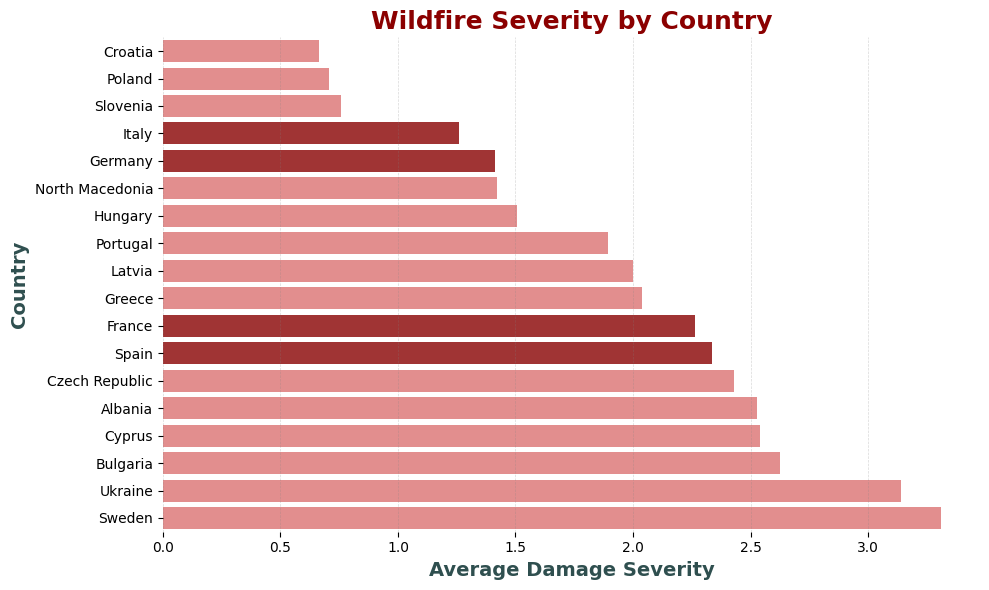

In [ ]:
# Group data by country and calculate the mean of 'normalized_num_damage'
average_damage_by_country = wildfire.groupby('country')['normalized_num_damage'].mean().reset_index()

# Rename the columns for clarity
average_damage_by_country.columns = ['country', 'average_damage']

# Remove the United Kingdom from the dataset
average_damage_by_country = average_damage_by_country[average_damage_by_country['country'] != 'United Kingdom']

# Define the countries to highlight
highlighted_countries = ['Spain', 'France', 'Germany', 'Italy']

# Sort data by average damage (ascending order)
average_damage_by_country = average_damage_by_country.sort_values(by='average_damage')

# Define color palette: highlighted countries in deep red, others in soft coral
colors = ['#B22222' if country in highlighted_countries else '#F08080'
          for country in average_damage_by_country['country']]

# Create the bar plot (horizontal)
plt.figure(figsize=(10, 6))

# Generate the bar plot with refined palette
bars = sns.barplot(
    y='country',
    x='average_damage',
    data=average_damage_by_country,
    palette=colors
)

# Title with refined styling
plt.title('Wildfire Severity by Country',
          fontsize=18, fontweight='bold', color='#8B0000', loc='center')

# Labels with modern styling
plt.xlabel('Average Damage Severity', fontsize=14, fontweight='bold', color='#2F4F4F')
plt.ylabel('Country', fontsize=14, fontweight='bold', color='#2F4F4F')

# Remove unnecessary spines for a clean look
sns.despine(left=True, bottom=True)

# Add gridlines for better visibility, but keep them subtle
plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.3, color='gray', axis='x')


# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


<ipython-input-109-d446f6ba204b>:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


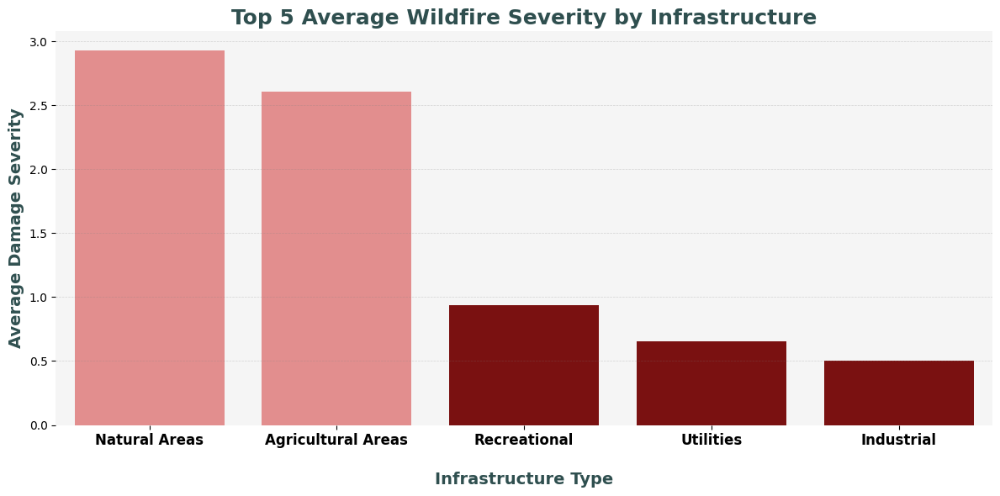

In [ ]:
# Calculate average damage by type
average_damage_by_type = wildfire.groupby('normalized_obj_type')['normalized_num_damage'].mean().reset_index()
average_damage_by_type.columns = ['infrastructure_type', 'average_damage']

# Get top 5 most impacted types
most_impacted_types = average_damage_by_type.sort_values(by='average_damage', ascending=False).head(5)

# Define colors: dark red for specified types, light red for others
colors = ['#8B0000' if infra in ['Recreational', 'Utilities', 'Industrial'] else '#F08080'
          for infra in most_impacted_types['infrastructure_type']]

# Visualization
plt.figure(figsize=(12, 6))

# Create bar plot with conditional coloring
sns.barplot(
    x='infrastructure_type',
    y='average_damage',
    data=most_impacted_types,
    palette=colors
)

# Title and axis labels
plt.title('Top 5 Average Wildfire Severity by Infrastructure',
          fontsize=18, fontweight='bold', color='#2F4F4F', loc='center')
plt.ylabel('Average Damage Severity', fontsize=14, fontweight='bold', color='#2F4F4F')

# X label with adjusted position
plt.xlabel('Infrastructure Type', fontsize=14, fontweight='bold', color='#2F4F4F', labelpad=20)

# Grid appearance
plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.3, color='gray', axis='y')

# Remove spines
sns.despine(left=True, bottom=True)

# Background color
plt.gca().set_facecolor('#F5F5F5')

# Centering the x-axis labels:
ax = plt.gca()
ax.set_xticks(ax.get_xticks())
ax.set_xticklabels(ax.get_xticklabels(), ha='center', fontsize=12, fontweight='bold', color='black')

# Layout adjustment
plt.tight_layout()

# Show plot
plt.show()


In [ ]:
wildfire_spain_filtered.normalized_obj_type.unique()
#

array([nan, 'Transportation', 'Water Infrastructure', 'Residential',
       'Recreational', 'Non-residential Buildings', 'Other', 'Industrial',
       'Other Infrastructure', 'Utilities'], dtype=object)

<ipython-input-141-89b7ae57dd8d>:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  bars = sns.barplot(


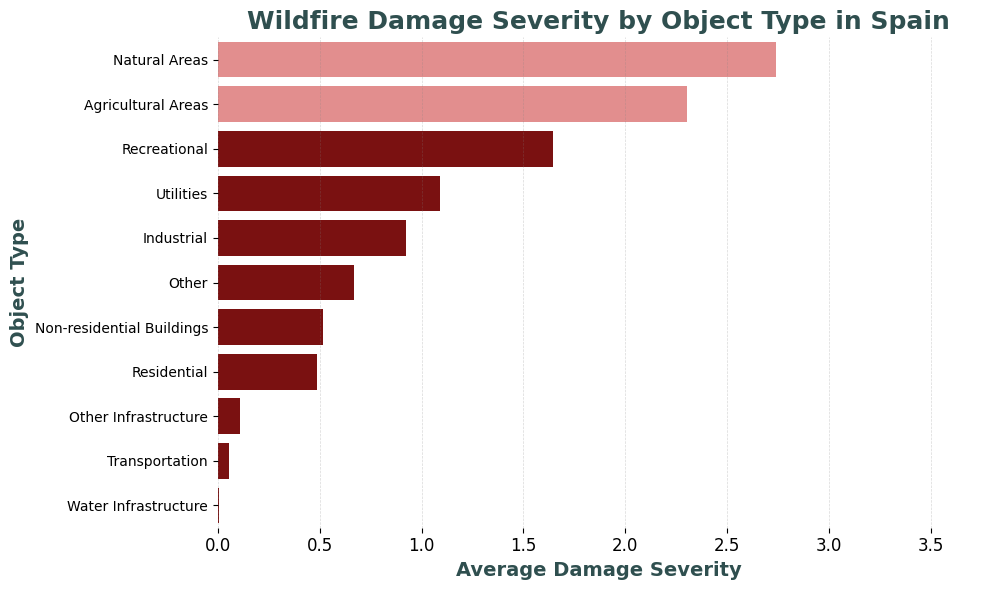

In [ ]:


# Filter for Spain
wildfire_spain = wildfire[wildfire['country'] == 'Spain']

# Group data by object type and calculate the average damage severity
grouped_data_spain = wildfire_spain.groupby('normalized_obj_type')['normalized_num_damage'].mean().reset_index()

# Sort by average damage severity in descending order
grouped_data_spain = grouped_data_spain.sort_values(by='normalized_num_damage', ascending=False)

# Normalize damage severity for color mapping
norm = plt.Normalize(grouped_data_spain['normalized_num_damage'].min(), grouped_data_spain['normalized_num_damage'].max())

colors = ['#F08080' if infra in ['Natural Areas', 'Agricultural Areas'] else '#8B0000'
          for infra in grouped_data_spain['normalized_obj_type']]

# Create a bar chart with sorted values and gradient coloring
plt.figure(figsize=(10, 6))
bars = sns.barplot(
    data=grouped_data_spain,
    y='normalized_obj_type',
    x='normalized_num_damage',
    palette=colors,
    orient='h'
)

# Titles and labels
plt.title('Wildfire Damage Severity by Object Type in Spain', fontsize=18, fontweight='bold', color='#2F4F4F')
plt.xlabel('Average Damage Severity', fontsize=14, fontweight='bold', color='#2F4F4F')
plt.ylabel('Object Type', fontsize=14, fontweight='bold', color='#2F4F4F')

# Customize x-axis
plt.xticks(fontsize=12, color='black')
plt.xlim(0, grouped_data_spain['normalized_num_damage'].max() + 1)  # Adjust limit dynamically

# Grid appearance
plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.3, color='gray', axis='x')

# Remove spines
sns.despine(left=True, bottom=True)

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()


📄 Original CRS: IGNF:ETRS89LAEA

--- Processing Spain ---
✅ Found 155 AOI SHP files.
Wildfires After Filtering: 146
✅ Filtered 8 Manufacturing Locations inside AOI.
✅ Filtered 2 Mining Locations inside AOI.
✅ Filtered 6 Construction Locations inside AOI.
✅ Filtered 0 Chemical Locations inside AOI.
✅ Filtered 15 Metal Locations inside AOI.


<ipython-input-142-8c1e51ea0bba>:133: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend(loc='lower right') # Legend at the bottom right.


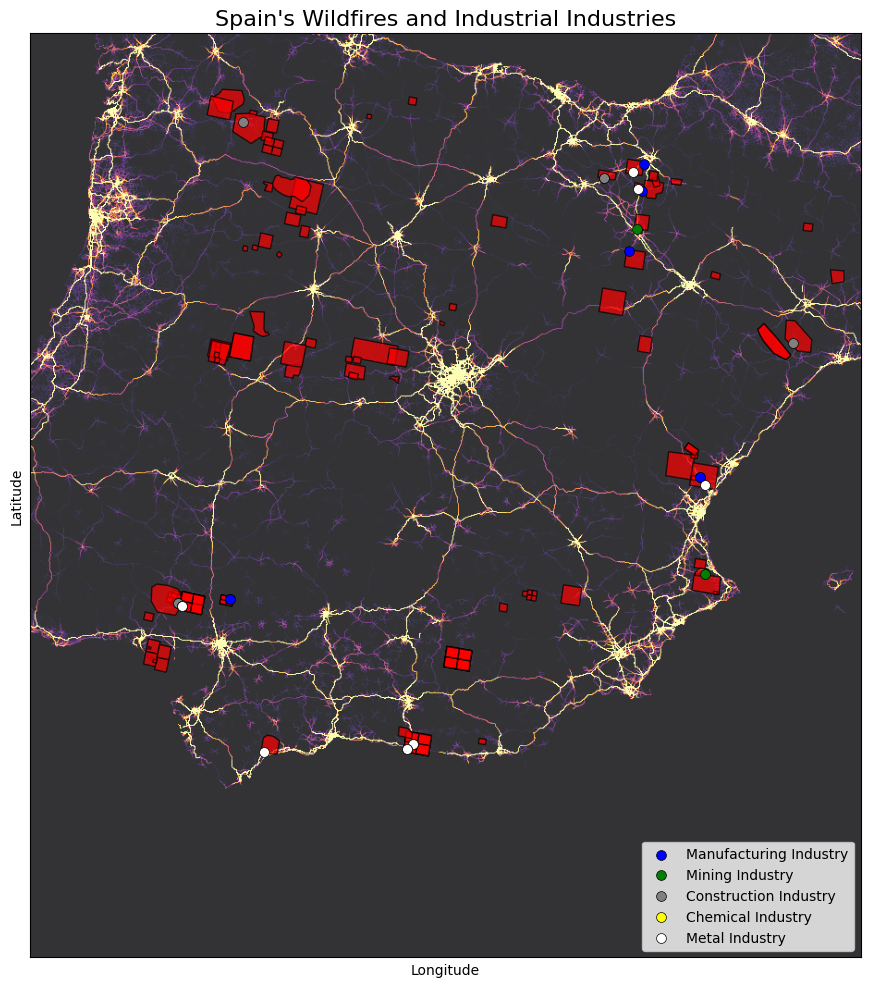

In [ ]:
import os
import re
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
import pandas as pd
from rasterio.plot import show
from shapely.geometry import Point

# 🚀 File Paths
freight_tif_path = "/content/HARCI_EU_Download_Unzipped/ci_tra01.tif"  # Freight road raster
wildfire_shp_folder = "/content/Wildfire_Unzipped"  # Spain AOI SHP folder

# ✅ Industry TIF Files
industry_tif_paths = {
    "Manufacturing": "/content/HARCI_EU_Download_Unzipped/ci_ind01.tif",
    "Mining": "/content/HARCI_EU_Download_Unzipped/ci_ind02.tif",
    "Construction": "/content/HARCI_EU_Download_Unzipped/ci_ind03.tif",
    "Chemical": "/content/HARCI_EU_Download_Unzipped/ci_ind04.tif",
    "Metal": "/content/HARCI_EU_Download_Unzipped/ci_ind05.tif",
}

# ✅ Marker Colors & Shapes for Each Industry Type
INDUSTRY_COLORS = {
    "Manufacturing": "blue",
    "Mining": "green",
    "Construction": "gray",
    "Chemical": "yellow",
    "Metal": "white",
}

INDUSTRY_SHAPES = {
    "Manufacturing": "o",  # Square
    "Mining": "o",  # Diamond
    "Construction": "o",  # Triangle
    "Chemical": "o",  # Circle
    "Metal": "o",  # Star
}

INDUSTRY_SIZE = 50  # Marker size

# ✅ Spain Bounding Box
SPAIN_BOUNDS = {"xmin": 2500000, "xmax": 3600000, "ymin": 1400000, "ymax": 2400000}  # Mainland Spain

# ✅ Load Freight Road Raster Data
with rasterio.open(freight_tif_path) as src:
    print(f"📄 Original CRS: {src.crs}")  # CRS should be EPSG:3035
    data = src.read(1)
    data_masked = np.ma.masked_where(data == src.nodata, data)
    transform = src.transform  # Affine transformation

# ✅ Normalize & Transform Raster Data
data_boosted = np.where(np.isnan(data_masked), 0, data_masked)
data_boosted = np.where(data_boosted < 0, 0, data_boosted)
data_boosted = np.log1p(data_boosted)  # Log transformation

valid_values = data_boosted[~np.isnan(data_boosted)]
data_min, data_max = np.percentile(valid_values, [5, 99])
data_boosted = np.clip((data_boosted - data_min) / (data_max - data_min), 0, 1)

# ✅ Process Spain
print("\n--- Processing Spain ---")

# ✅ Load & Merge AOI Wildfire Shapefiles for Spain
shp_files = [
    os.path.join(root, file)
    for root, _, files in os.walk(wildfire_shp_folder)
    for file in files if re.search(r".*area.*\.shp$", file, re.IGNORECASE)
]

if not shp_files:
    print("⚠️ No AOI SHP files found for Spain!")
    spain_gdf = None
else:
    print(f"✅ Found {len(shp_files)} AOI SHP files.")
    gdfs = [gpd.read_file(shp).to_crs(epsg=3035) for shp in shp_files]
    all_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

    # Filter to Spain bounding box
    spain_gdf = all_gdf.cx[SPAIN_BOUNDS["xmin"]:SPAIN_BOUNDS["xmax"], SPAIN_BOUNDS["ymin"]:SPAIN_BOUNDS["ymax"]]
    print(f"Wildfires After Filtering: {len(spain_gdf)}")

# ✅ Extract Industry Locations from Each Industry Raster & Filter to AOI
filtered_industry_locations = {}

for industry_type, tif_path in industry_tif_paths.items():
    if not os.path.exists(tif_path):
        print(f"⚠️ {industry_type} TIF file not found. Skipping...")
        continue

    with rasterio.open(tif_path) as src:
        industry_data = src.read(1)
        nodata_value = src.nodata

    valid_pixels = np.where((industry_data != nodata_value) & (industry_data > 0))
    x_coords, y_coords = rasterio.transform.xy(transform, valid_pixels[0], valid_pixels[1])
    industry_gdf = gpd.GeoDataFrame(geometry=[Point(x, y) for x, y in zip(x_coords, y_coords)], crs="EPSG:3035")

    if spain_gdf is not None:
        industry_gdf = gpd.sjoin(industry_gdf, spain_gdf, how="inner", predicate="within")

    filtered_industry_locations[industry_type] = list(industry_gdf.geometry.apply(lambda p: (p.x, p.y)))
    print(f"✅ Filtered {len(filtered_industry_locations[industry_type])} {industry_type} Locations inside AOI.")

# ✅ Plot Freight Road Heatmap with AOI Boundaries & Filtered Industry Locations
fig, ax = plt.subplots(figsize=(12, 12))

# Show raster heatmap
show(data_boosted, transform=transform, ax=ax, cmap="inferno", alpha=0.8)

# ✅ Plot Wildfires
if spain_gdf is not None:
    spain_gdf.plot(ax=ax, color="red", edgecolor="black", linewidth=1, alpha=0.7, label="Spain Wildfires")

# ✅ Overlay **Filtered** Industry Locations as Scatter Points
for industry_type, locations in filtered_industry_locations.items():
    ax.scatter(
        [p[0] for p in locations],
        [p[1] for p in locations],
        color=INDUSTRY_COLORS[industry_type], marker=INDUSTRY_SHAPES[industry_type], s=INDUSTRY_SIZE,
        edgecolor="black", linewidth=0.5, label=f"{industry_type} Industry"
    )

# ✅ Restrict plot zoom to **ONLY Spain bounding box**
ax.set_xlim(2700000, SPAIN_BOUNDS["xmax"])  # Set xmin to 2.7e6
ax.set_ylim(SPAIN_BOUNDS["ymin"], SPAIN_BOUNDS["ymax"])

# ✅ Set labels and title
ax.set_title("Spain's Wildfires and Industrial Industries", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.legend(loc='lower right') # Legend at the bottom right.
ax.set_xticks([])
ax.set_yticks([])
plt.show()



# FLOODS

In [ ]:
# Define source and destination directories
source_dir = "/content/drive/MyDrive/Business Challenge II - Team 2/data/flood/Unzipped_flood/"  # The directory containing downloaded ZIPs
dest_dir = "/content/Copernicus_Downloads_Unzipped"  # Directory for extracted files

# Ensure the destination directory exists
os.makedirs(dest_dir, exist_ok=True)

# Regex pattern to extract EMSR ID (e.g., "EMSR139")
emsr_pattern = re.compile(r"(EMSR\d+)")

# Loop through each country-category folder
for country_category in os.listdir(source_dir):
    country_category_path = os.path.join(source_dir, country_category)

    # Ensure it's a directory (skip files)
    if not os.path.isdir(country_category_path):
        continue

    print(f"📂 Processing: {country_category}")

    # Create corresponding unzipped folder
    unzipped_folder = os.path.join(dest_dir, f"{country_category}_Unzipped")
    os.makedirs(unzipped_folder, exist_ok=True)

    # Process each ZIP file inside the folder
    for file in os.listdir(country_category_path):
        if file.endswith(".zip"):
            file_path = os.path.join(country_category_path, file)

            # Extract EMSR ID
            emsr_match = emsr_pattern.search(file)
            if emsr_match:
                emsr_id = emsr_match.group(1)
            else:
                print(f"⚠️ Skipping {file} (No EMSR ID found)")
                continue

            # Create EMSR-specific extraction folder
            emsr_unzipped_path = os.path.join(unzipped_folder, emsr_id)
            os.makedirs(emsr_unzipped_path, exist_ok=True)

            print(f"📤 Extracting {file} to {emsr_unzipped_path}")

            # Extract ZIP file
            try:
                with zipfile.ZipFile(file_path, "r") as zip_ref:
                    zip_ref.extractall(emsr_unzipped_path)
                print(f"✅ Successfully extracted {file} to {emsr_unzipped_path}")
            except zipfile.BadZipFile:
                print(f"❌ Corrupt ZIP file: {file}")
            except Exception as e:
                print(f"❌ Error extracting {file}: {e}")

print("🎉 All files extracted and organized successfully!")

📂 Processing: France_Flood_SHP_Zip
📤 Extracting EMSR139_02CAPCORSEBASTIA_GRADING_OVERVIEW-MONIT01_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR139
✅ Successfully extracted EMSR139_02CAPCORSEBASTIA_GRADING_OVERVIEW-MONIT01_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR139
📤 Extracting EMSR165_04POISSY_GRADING_OVERVIEW_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR165
✅ Successfully extracted EMSR165_04POISSY_GRADING_OVERVIEW_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR165
📤 Extracting EMSR467_AOI05_GRA_PRODUCT_r1_RTP01_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR467
✅ Successfully extracted EMSR467_AOI05_GRA_PRODUCT_r1_RTP01_v1_vector.zip to /content/Copernicus_Downloads_Unzipped/France_Flood_SHP_Zip_Unzipped/EMSR467
📤 Extracting EMSR165_07YERRES_GRADING_OVERVIEW_v1

🌍 Processing Italy...
📐 Bounding box for Italy: (4134013.503401162, 1590740.8819670912, 4924043.76564379, 2447298.2014528275)
📄 Original raster CRS: IGNF:ETRS89LAEA
📄 Original raster shape: (4030, 3893)
🔄 Reprojecting raster to EPSG:3035...
✂️ Clipping raster to AOI bounds...
🔄 Reprojecting Coal raster to EPSG:3035...
🔄 Reprojecting Gas raster to EPSG:3035...
🔄 Reprojecting Oil raster to EPSG:3035...
🔄 Reprojecting Nuclear raster to EPSG:3035...
🔄 Reprojecting Biomass_Geothermal raster to EPSG:3035...


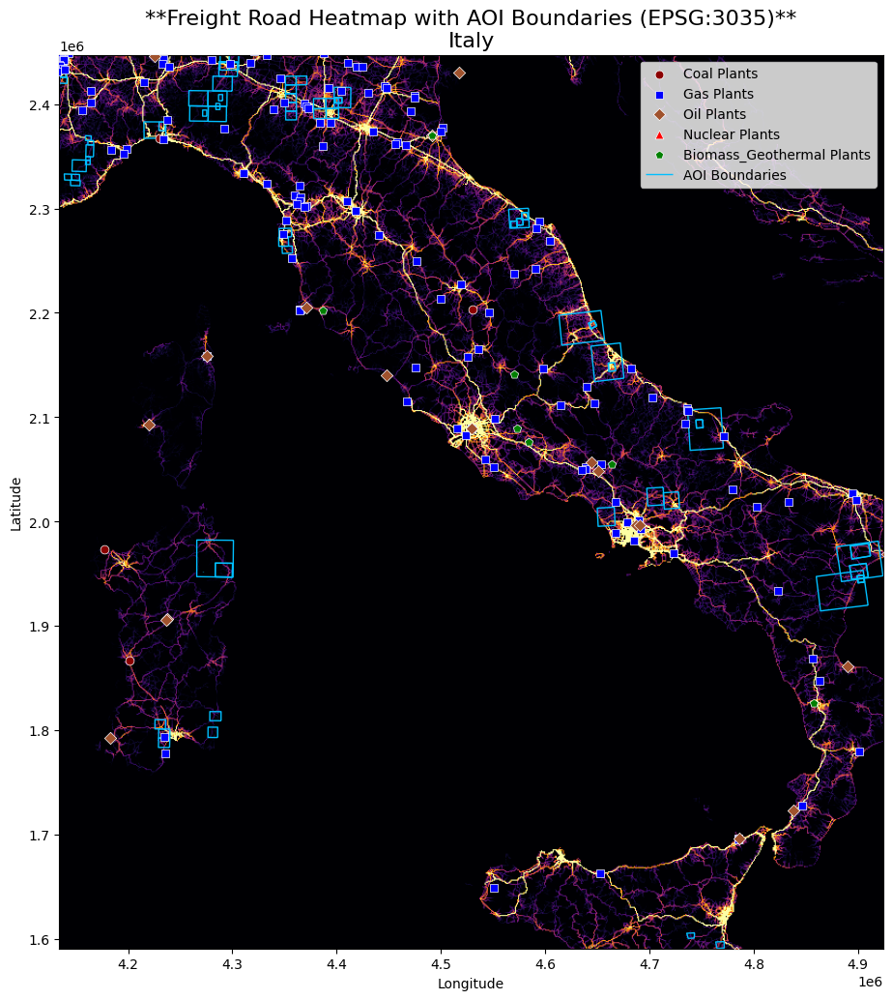

🌍 Processing Spain...
📐 Bounding box for Spain: (2985679.4991531363, 1620566.5448702527, 3754064.6699527325, 2200592.520487937)
📄 Original raster CRS: IGNF:ETRS89LAEA
📄 Original raster shape: (4030, 3893)
🔄 Reprojecting raster to EPSG:3035...
✂️ Clipping raster to AOI bounds...
🔄 Reprojecting Coal raster to EPSG:3035...
🔄 Reprojecting Gas raster to EPSG:3035...
🔄 Reprojecting Oil raster to EPSG:3035...
🔄 Reprojecting Nuclear raster to EPSG:3035...
🔄 Reprojecting Biomass_Geothermal raster to EPSG:3035...


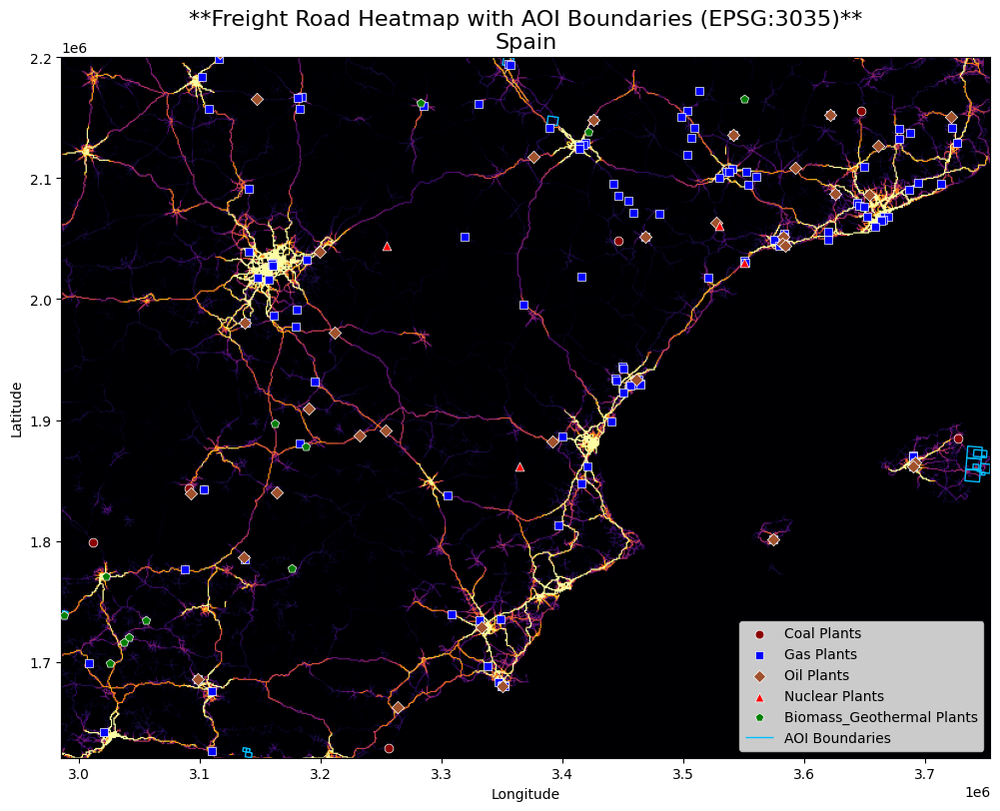

🌍 Processing Germany...
📐 Bounding box for Germany: (4349050.722800084, 2795315.5579071837, 4547486.224971902, 3245662.124211156)
📄 Original raster CRS: IGNF:ETRS89LAEA
📄 Original raster shape: (4030, 3893)
🔄 Reprojecting raster to EPSG:3035...
✂️ Clipping raster to AOI bounds...
🔄 Reprojecting Coal raster to EPSG:3035...
🔄 Reprojecting Gas raster to EPSG:3035...
🔄 Reprojecting Oil raster to EPSG:3035...
🔄 Reprojecting Nuclear raster to EPSG:3035...
🔄 Reprojecting Biomass_Geothermal raster to EPSG:3035...


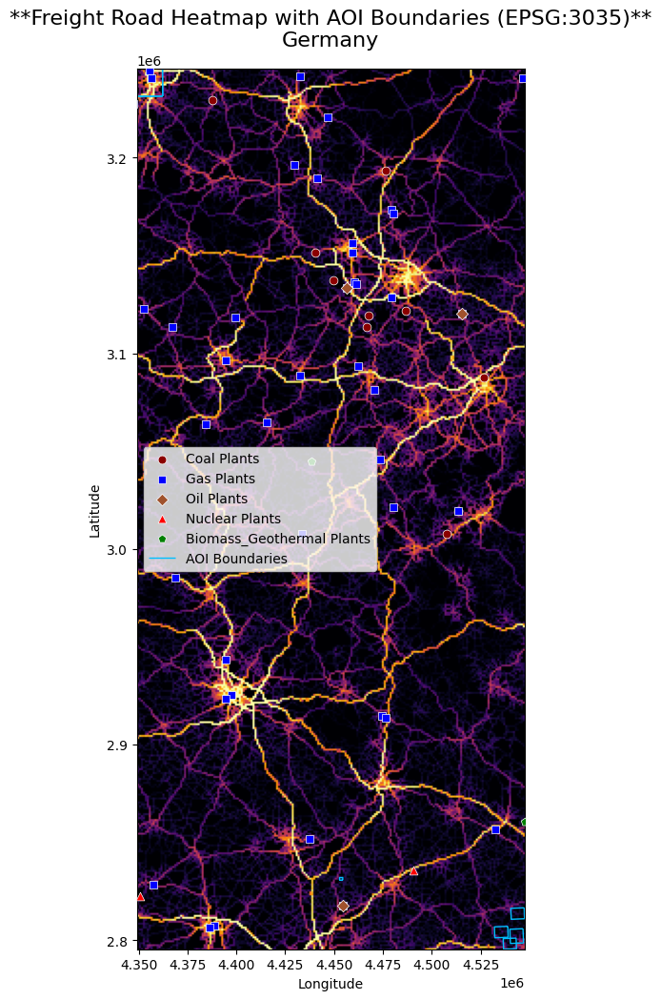

🌍 Processing France...
📐 Bounding box for France: (3698667.596385008, 2140531.7216830635, 4284575.141175582, 2921699.341582624)
📄 Original raster CRS: IGNF:ETRS89LAEA
📄 Original raster shape: (4030, 3893)
🔄 Reprojecting raster to EPSG:3035...
✂️ Clipping raster to AOI bounds...
🔄 Reprojecting Coal raster to EPSG:3035...
🔄 Reprojecting Gas raster to EPSG:3035...
🔄 Reprojecting Oil raster to EPSG:3035...
🔄 Reprojecting Nuclear raster to EPSG:3035...
🔄 Reprojecting Biomass_Geothermal raster to EPSG:3035...


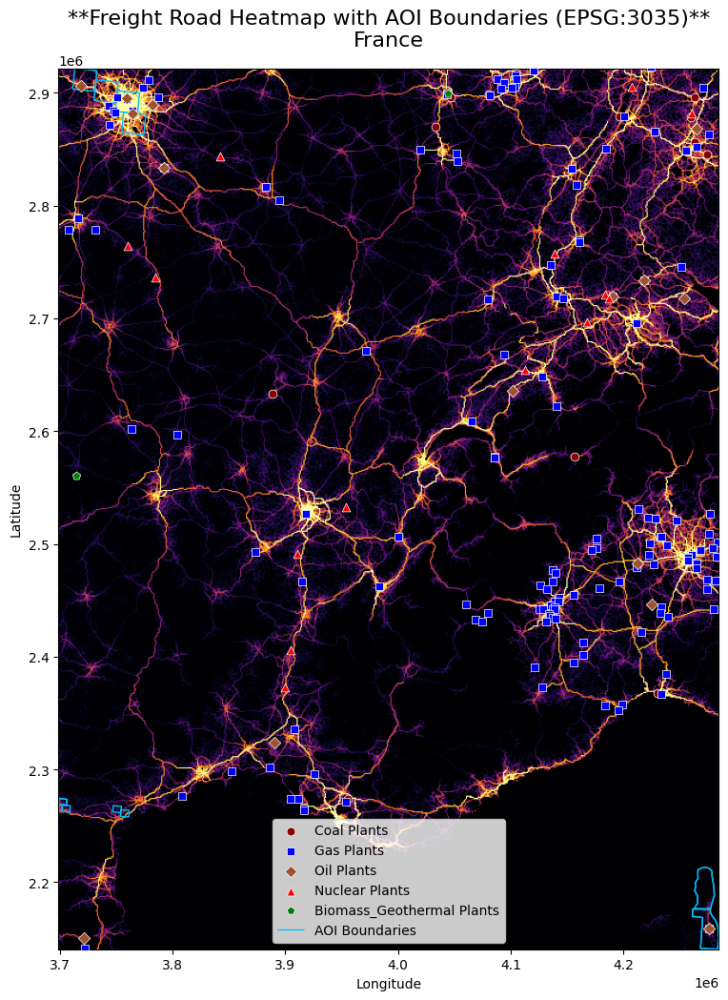

🎯 All heatmaps generated successfully!


In [ ]:
# 🚀 File paths (Update if needed)
tif_file_path = "/content/HARCI_EU_Download_Unzipped/ci_tra01.tif"  # Road transportation data (TIF)
energy_tif_paths = {
    "Coal": "/content/HARCI_EU_Download_Unzipped/ci_ene01.tif",
    "Gas": "/content/HARCI_EU_Download_Unzipped/ci_ene02.tif",
    "Oil": "/content/HARCI_EU_Download_Unzipped/ci_ene03.tif",
    "Nuclear": "/content/HARCI_EU_Download_Unzipped/ci_ene04.tif",
    "Biomass_Geothermal": "/content/HARCI_EU_Download_Unzipped/ci_ene05.tif"
}
base_shp_folder = "/content/Copernicus_Downloads_Unzipped"  # Base folder containing all unzipped SHP files

# Customization
ENERGY_COLORS = {
    "Coal": '#8B0000',  # Dark red
    "Gas": '#0000FF',   # Blue
    "Oil": '#A0522D',   # Sienna
    "Nuclear": '#FF0000',  # Red
    "Biomass_Geothermal": '#008000'  # Green
}
ENERGY_SHAPES = {
    "Coal": 'o',  # Circle
    "Gas": 's',   # Square
    "Oil": 'D',   # Diamond
    "Nuclear": '^',  # Triangle
    "Biomass_Geothermal": 'p'  # Pentagon
}
ENERGY_SIZE = 40  # Marker size

# 🔍 Step 1: Recursively fetch all country folders
country_folders = [f.path for f in os.scandir(base_shp_folder) if f.is_dir()]

# 🚀 Step 2: Process each country folder
for country_folder in country_folders:
    country_name = os.path.basename(country_folder).split("_")[0]  # Extract country name (e.g., "Italy")
    print(f"🌍 Processing {country_name}...")

    # 🔍 Step 3: Recursively fetch all "area_of_interest" SHP files inside the country folder
    shapefiles = []
    for root, _, files in os.walk(country_folder):
        for file in files:
            if "area_of_interest" in file.lower() and file.endswith(".shp"):
                shapefiles.append(os.path.join(root, file))

    # 🚨 Skip if no shapefiles are found
    if not shapefiles:
        print(f"⚠️ No shapefiles found in {country_folder}. Skipping...")
        continue

    # 📌 Read and merge all SHP files (Ensure CRS is EPSG:3035)
    gdfs = [gpd.read_file(shp).to_crs(epsg=3035) for shp in shapefiles]
    gdf_combined = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

    # Get bounding box from SHP data (xmin, ymin, xmax, ymax)
    xmin, ymin, xmax, ymax = gdf_combined.total_bounds
    print(f"📐 Bounding box for {country_name}: ({xmin}, {ymin}, {xmax}, {ymax})")

    # 🔥 Step 4: Load raster data
    with rasterio.open(tif_file_path) as src:
        print(f"📄 Original raster CRS: {src.crs}")
        print(f"📄 Original raster shape: {src.shape}")

        # Reproject raster to EPSG:3035 if necessary
        if src.crs != "EPSG:3035":
            print("🔄 Reprojecting raster to EPSG:3035...")
            from rasterio.warp import calculate_default_transform, reproject, Resampling

            transform, width, height = calculate_default_transform(
                src.crs, "EPSG:3035", src.width, src.height, *src.bounds
            )
            reprojected_data = np.zeros((src.count, height, width), dtype=src.dtypes[0])

            reproject(
                source=rasterio.band(src, 1),
                destination=reprojected_data[0],
                src_transform=src.transform,
                src_crs=src.crs,
                dst_transform=transform,
                dst_crs="EPSG:3035",
                resampling=Resampling.nearest
            )
            src = rasterio.open(tif_file_path)  # Reopen the original file
        else:
            reprojected_data = src.read(1)

        # Clip raster to the shapefile bounds
        print("✂️ Clipping raster to AOI bounds...")
        out_image, out_transform = mask(src, gdf_combined.geometry, crop=True, filled=False)
        out_image = np.ma.masked_where(out_image == src.nodata, out_image)

    # 🚀 Step 5: Apply log transformation and normalization
    data_boosted = np.where(np.isnan(out_image), 0, out_image)
    data_boosted = np.where(data_boosted < 0, 0, data_boosted)  # Ensure non-negative values
    data_boosted = np.log1p(data_boosted)  # Log transformation

    # Normalize between 5th and 99th percentile (better contrast)
    valid_values = data_boosted[~np.isnan(data_boosted)]
    data_min, data_max = np.percentile(valid_values, [5, 99])
    data_boosted = (data_boosted - data_min) / (data_max - data_min)
    data_boosted = np.clip(data_boosted, 0, 1)  # Clip to valid range

    # 🎨 Step 6: Plot heatmap restricted to SHP bounds
    fig, ax = plt.subplots(figsize=(12, 12))

    # Show raster heatmap
    show(data_boosted, transform=out_transform, ax=ax, cmap="inferno", alpha=1)

    # 🔥 Step 7: Load and process energy plant data
    for energy_type, tif_path in energy_tif_paths.items():
        with rasterio.open(tif_path) as energy_src:
            if energy_src.crs != "EPSG:3035":
                print(f"🔄 Reprojecting {energy_type} raster to EPSG:3035...")
                energy_transform, energy_width, energy_height = calculate_default_transform(
                    energy_src.crs, "EPSG:3035", energy_src.width, energy_src.height, *energy_src.bounds
                )
                energy_reprojected = np.zeros((energy_src.count, energy_height, energy_width), dtype=energy_src.dtypes[0])

                reproject(
                    source=rasterio.band(energy_src, 1),
                    destination=energy_reprojected[0],
                    src_transform=energy_src.transform,
                    src_crs=energy_src.crs,
                    dst_transform=energy_transform,
                    dst_crs="EPSG:3035",
                    resampling=Resampling.nearest
                )
            else:
                energy_reprojected = energy_src.read(1)

            # Extract the first band (2D array) for processing
            energy_data = energy_reprojected[0] if energy_reprojected.ndim == 3 else energy_reprojected

            # Get plant coordinates in EPSG:3035
            rows, cols = np.where(energy_data > 0)
            x_coords, y_coords = rasterio.transform.xy(energy_transform, rows, cols)

            # Plot energy plants if any exist
            if len(x_coords) > 0:
                ax.scatter(x_coords, y_coords, color=ENERGY_COLORS[energy_type], s=ENERGY_SIZE,
                          marker=ENERGY_SHAPES[energy_type], edgecolor='white', linewidth=0.5, zorder=3,
                          label=f'{energy_type} Plants')
            else:
                print(f"⚠️ No {energy_type} plants found in {country_name}")

    # Plot SHP boundaries
    gdf_combined.boundary.plot(ax=ax, color="#00BFFF", linewidth=1, alpha=1, label="AOI Boundaries")

    # Set zoom limits to match SHP bounding box
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)

    # Add labels
    ax.set_title(f"**Freight Road Heatmap with AOI Boundaries (EPSG:3035)**\n{country_name}", fontsize=16)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

    # Add legend
    ax.legend()

    # 🚀 Step 8: Save the plot
    save_path = os.path.join("plot_images", country_name)
    os.makedirs(save_path, exist_ok=True)  # Ensure the directory exists
    plt.savefig(os.path.join(save_path, f"{country_name}_heatmap.png"), dpi=300, bbox_inches='tight')

    # Show the plot
    plt.show()

    # Clear the figure to free memory
    plt.clf()
    plt.close()

print("🎯 All heatmaps generated successfully!")

📄 Original CRS: IGNF:ETRS89LAEA
✅ Found 123 AOI SHP files for Italy.
📐 AOI Bounding Box: (4122492.521452794, 1523349.844177997, 4948153.381645555, 2506469.770438795)
✅ Filtered 1 Coal Plants inside AOI.
✅ Filtered 24 Gas Plants inside AOI.
✅ Filtered 2 Oil Plants inside AOI.
✅ Filtered 0 Nuclear Plants inside AOI.
✅ Filtered 2 Biomass_Geothermal Plants inside AOI.
✅ Filtered 6 Hydro Plants inside AOI.
✅ Filtered 6 Solar Plants inside AOI.
✅ Filtered 12 Wind Plants inside AOI.


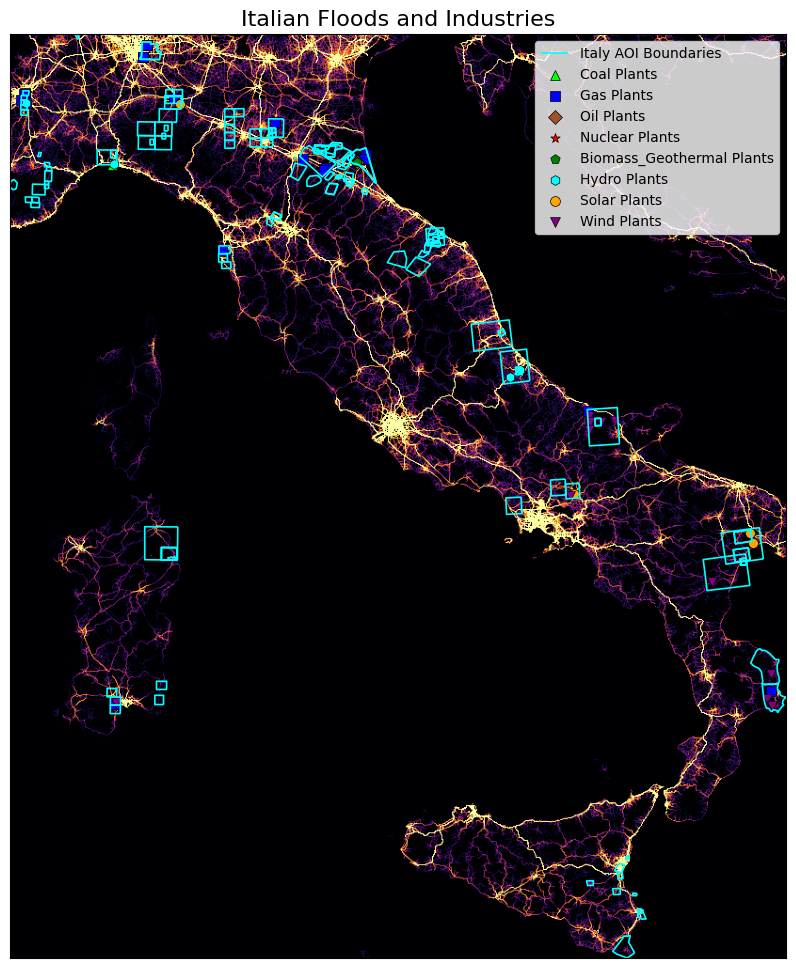

In [ ]:
import os
import re
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from rasterio.plot import show
from rasterio.mask import mask
from shapely.geometry import Point

# 🚀 File Paths
freight_tif_path = "/content/HARCI_EU_Download_Unzipped/ci_tra01.tif"  # Freight road raster
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"  # Italy AOI SHP folder

# ✅ Energy Plant TIF Files
energy_tif_paths = {
    "Coal": "/content/HARCI_EU_Download_Unzipped/ci_ene01.tif",
    "Gas": "/content/HARCI_EU_Download_Unzipped/ci_ene02.tif",
    "Oil": "/content/HARCI_EU_Download_Unzipped/ci_ene03.tif",
    "Nuclear": "/content/HARCI_EU_Download_Unzipped/ci_ene04.tif",
    "Biomass_Geothermal": "/content/HARCI_EU_Download_Unzipped/ci_ene05.tif",
    "Hydro": "/content/HARCI_EU_Download_Unzipped/ci_ene06.tif",
    "Solar": "/content/HARCI_EU_Download_Unzipped/ci_ene07.tif",
    "Wind": "/content/HARCI_EU_Download_Unzipped/ci_ene08.tif",
}

# ✅ Marker Colors & Shapes for Each Energy Type
ENERGY_COLORS = {
    "Coal": "lime",
    "Gas": "blue",
    "Oil": "sienna",
    "Nuclear": "red",
    "Biomass_Geothermal": "green",
    "Hydro": "cyan",
    "Solar": "orange",
    "Wind": "purple",
}

ENERGY_SHAPES = {
    "Coal": "^",  # Triangle
    "Gas": "s",   # Square
    "Oil": "D",   # Diamond
    "Nuclear": "*",  # Star
    "Biomass_Geothermal": "p",  # Pentagon
    "Hydro": "h",  # Hexagon
    "Solar": "o",  # Circle
    "Wind": "v",  # Downward Triangle
}

ENERGY_SIZE = 50  # Marker size

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load Freight Road Raster Data
with rasterio.open(freight_tif_path) as src:
    print(f"📄 Original CRS: {src.crs}")  # Should be EPSG:3035

    # Read raster data
    data = src.read(1)
    data_masked = np.ma.masked_where(data == src.nodata, data)
    transform = src.transform  # Affine transformation

# ✅ Normalize & Transform Raster Data
data_boosted = np.where(np.isnan(data_masked), 0, data_masked)
data_boosted = np.where(data_boosted < 0, 0, data_boosted)  # Ensure non-negative values
data_boosted = np.log1p(data_boosted)  # Log transformation

# Normalize between 5th and 99th percentile
valid_values = data_boosted[~np.isnan(data_boosted)]
data_min, data_max = np.percentile(valid_values, [5, 99])
data_boosted = np.clip((data_boosted - data_min) / (data_max - data_min), 0, 1)

# ✅ Load & Merge Only SHP Files Matching "area"
italy_shp_files = [
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)  # ✅ Only SHP files with "area" in name
]

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3035)
    gdfs = [gpd.read_file(shp).to_crs(epsg=3035) for shp in italy_shp_files]
    italy_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Compute AOI Bounding Box
if italy_gdf is not None:
    xmin, ymin, xmax, ymax = italy_gdf.total_bounds  # ✅ Restrict zoom to AOI boundary
    print(f"📐 AOI Bounding Box: ({xmin}, {ymin}, {xmax}, {ymax})")
else:
    with rasterio.open(freight_tif_path) as src:
        xmin, xmax = src.bounds.left, src.bounds.right
        ymin, ymax = src.bounds.bottom, src.bounds.top

# ✅ Extract Power Plant Locations from Each Energy Raster & Filter to AOI
filtered_energy_locations = {}

for energy_type, tif_path in energy_tif_paths.items():
    if not os.path.exists(tif_path):
        print(f"⚠️ {energy_type} TIF file not found. Skipping...")
        continue

    with rasterio.open(tif_path) as src:
        plant_data = src.read(1)  # Read first band
        nodata_value = src.nodata  # Get NoData value

    # Mask NoData values and find non-zero locations
    valid_pixels = np.where((plant_data != nodata_value) & (plant_data > 0))

    # Convert pixel locations to real-world coordinates (EPSG:3035)
    x_coords, y_coords = rasterio.transform.xy(transform, valid_pixels[0], valid_pixels[1])

    # Convert to GeoDataFrame for spatial filtering
    energy_gdf = gpd.GeoDataFrame(geometry=[Point(x, y) for x, y in zip(x_coords, y_coords)], crs="EPSG:3035")

    # ✅ Spatial Join: Filter only energy plants inside AOI
    if italy_gdf is not None:
        energy_gdf = gpd.sjoin(energy_gdf, italy_gdf, how="inner", predicate="within")

    filtered_energy_locations[energy_type] = list(energy_gdf.geometry.apply(lambda p: (p.x, p.y)))
    print(f"✅ Filtered {len(filtered_energy_locations[energy_type])} {energy_type} Plants inside AOI.")

# ✅ Plot Freight Road Heatmap with Italy AOI Boundaries & Filtered Power Plants
fig, ax = plt.subplots(figsize=(12, 12))

# Show raster heatmap
show(data_boosted, transform=transform, ax=ax, cmap="inferno", alpha=1)

# ✅ Plot AOI Boundaries (as lines only, no filled polygons)
if italy_gdf is not None:
    italy_gdf.boundary.plot(ax=ax, color="cyan", linewidth=1.2, alpha=1, label="Italy AOI Boundaries")

# ✅ Overlay **Filtered** Power Plant Locations as Scatter Points
for energy_type, locations in filtered_energy_locations.items():
    ax.scatter(
        [p[0] for p in locations],  # X coordinates
        [p[1] for p in locations],  # Y coordinates
        color=ENERGY_COLORS[energy_type], marker=ENERGY_SHAPES[energy_type], s=ENERGY_SIZE,
        edgecolor="black", linewidth=0.5, label=f"{energy_type} Plants"
    )

# ✅ Restrict plot zoom to AOI bounding box
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# ✅ Set labels and title
ax.set_title("Italian Floods and Industries", fontsize=16)
ax.set_xticks([])
ax.set_yticks([])
ax.legend()

# ✅ Save the plot
save_path = "plot_images/italy"
os.makedirs(save_path, exist_ok=True)
plt.savefig(os.path.join(save_path, "italy_aoi_heatmap_filtered_energy.png"), dpi=300, bbox_inches='tight')

plt.show()


📄 Original CRS: IGNF:ETRS89LAEA
✅ Found 123 AOI SHP files for Italy.
📐 AOI Bounding Box: (4122492.521452794, 1523349.844177997, 4948153.381645555, 2506469.770438795)


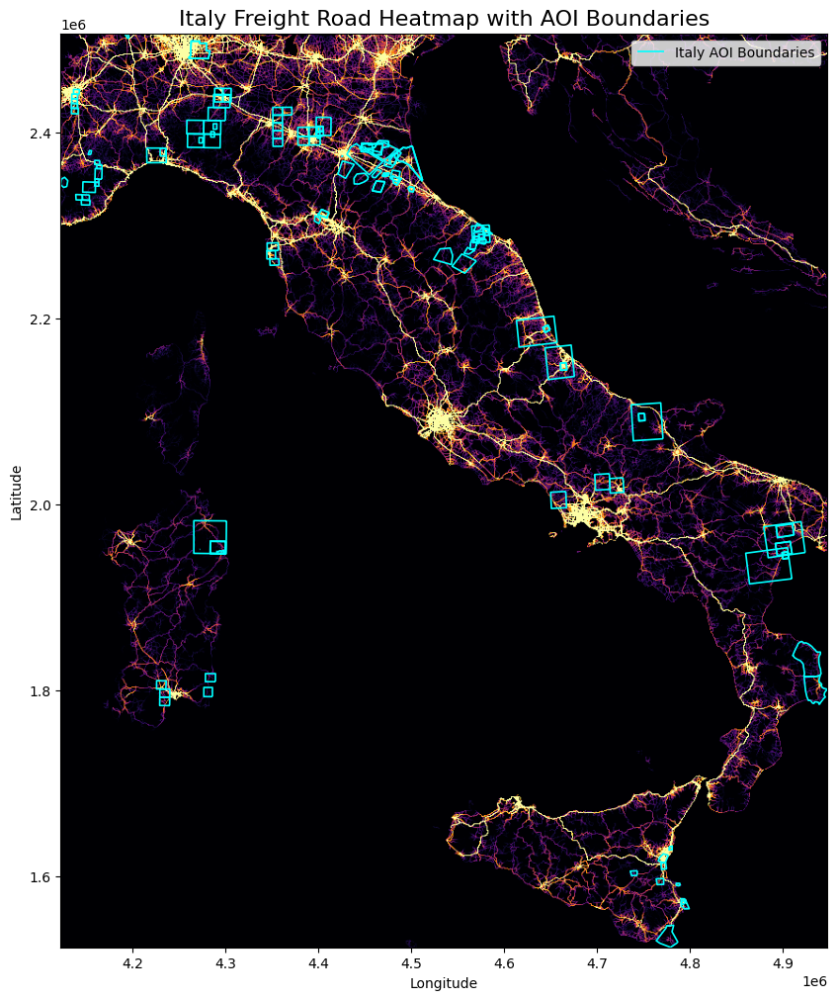

In [ ]:
# 🚀 File paths
tif_file_path = "/content/HARCI_EU_Download_Unzipped/ci_tra01.tif"  # Freight road raster
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"  # Italy AOI SHP folder

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load Raster Data
with rasterio.open(tif_file_path) as src:
    print(f"📄 Original CRS: {src.crs}")  # Should be EPSG:3035

    # Read raster data
    data = src.read(1)
    data_masked = np.ma.masked_where(data == src.nodata, data)

# ✅ Normalize & Transform Raster Data
data_boosted = np.where(np.isnan(data_masked), 0, data_masked)
data_boosted = np.where(data_boosted < 0, 0, data_boosted)  # Ensure non-negative values
data_boosted = np.log1p(data_boosted)  # Log transformation

# Normalize between 5th and 99th percentile
valid_values = data_boosted[~np.isnan(data_boosted)]
data_min, data_max = np.percentile(valid_values, [5, 99])
data_boosted = np.clip((data_boosted - data_min) / (data_max - data_min), 0, 1)

# ✅ Load & Merge Only SHP Files Matching "area"
italy_shp_files = [
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)  # ✅ Only SHP files with "area" in name
]

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3035)
    gdfs = [gpd.read_file(shp).to_crs(epsg=3035) for shp in italy_shp_files]
    italy_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Compute AOI Bounding Box
if italy_gdf is not None:
    xmin, ymin, xmax, ymax = italy_gdf.total_bounds  # ✅ Restrict zoom to AOI boundary
    print(f"📐 AOI Bounding Box: ({xmin}, {ymin}, {xmax}, {ymax})")
else:
    with rasterio.open(tif_file_path) as src:
        xmin, xmax = src.bounds.left, src.bounds.right
        ymin, ymax = src.bounds.bottom, src.bounds.top

# ✅ Plot Freight Road Heatmap with Italy AOI Boundaries
fig, ax = plt.subplots(figsize=(12, 12))

# Show raster heatmap
show(data_boosted, transform=src.transform, ax=ax, cmap="inferno", alpha=1.0)

# ✅ Plot AOI Boundaries (as lines only, no filled polygons)
if italy_gdf is not None:
    italy_gdf.boundary.plot(ax=ax, color="cyan", linewidth=1.2, alpha=1, label="Italy AOI Boundaries")

# ✅ Restrict plot zoom to AOI bounding box
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# ✅ Set labels and title
ax.set_title("Italy Freight Road Heatmap with AOI Boundaries", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.legend()

# ✅ Save the plot
save_path = "plot_images/italy"
os.makedirs(save_path, exist_ok=True)
plt.savefig(os.path.join(save_path, "italy_aoi_heatmap_filtered.png"), dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

📄 Original CRS: IGNF:ETRS89LAEA
✅ Found 123 AOI SHP files for Italy.
📐 AOI Bounding Box: (4122492.521452794, 1523349.844177997, 4948153.381645555, 2506469.770438795)
✅ Extracted 327 Coal Plant Locations.


<ipython-input-20-ad4987c7e1c5>:100: UserWarning: Glyph 128663 (\N{AUTOMOBILE}) missing from font(s) DejaVu Sans.
  plt.savefig(os.path.join(save_path, "italy_aoi_heatmap_coal.png"), dpi=300, bbox_inches='tight')
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128663 (\N{AUTOMOBILE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


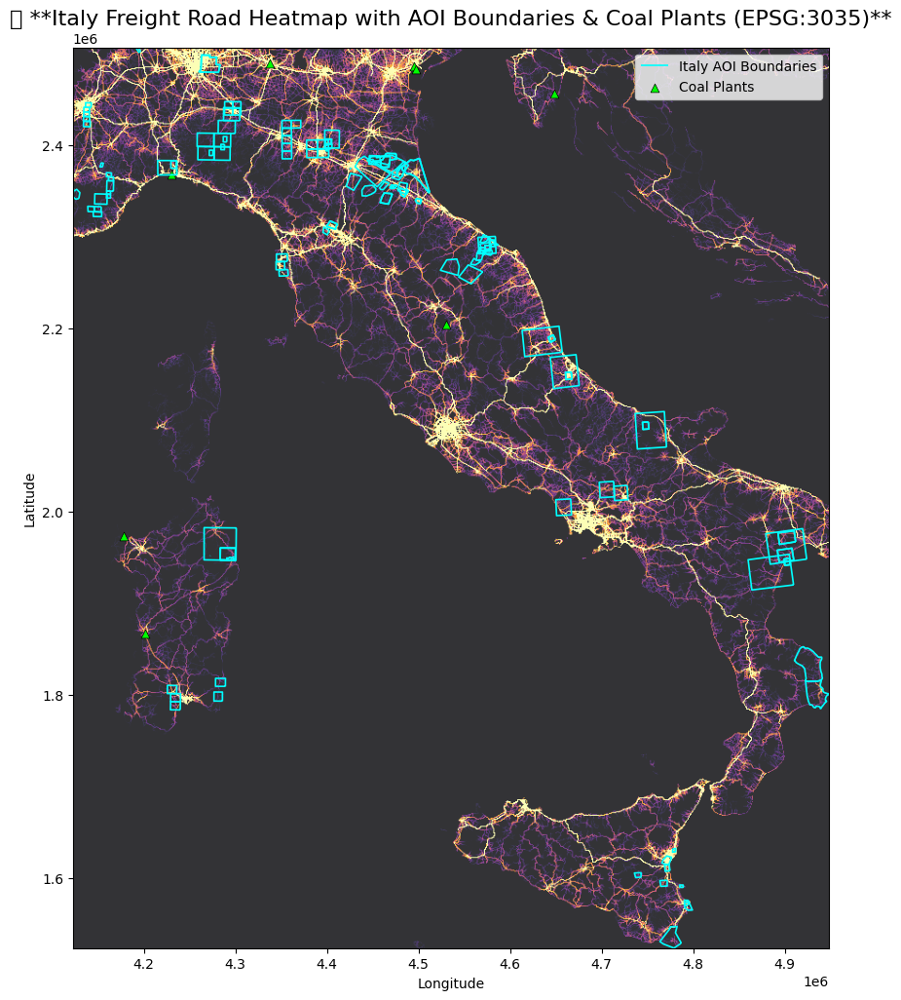

In [ ]:
# 🚀 File paths
freight_tif_path = "/content/HARCI_EU_Download_Unzipped/ci_tra01.tif"  # Freight road raster
coal_tif_path = "/content/HARCI_EU_Download_Unzipped/ci_ene01.tif"  # Coal plant raster
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"  # Italy AOI SHP folder

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load Freight Road Raster Data
with rasterio.open(freight_tif_path) as src:
    print(f"📄 Original CRS: {src.crs}")  # Should be EPSG:3035

    # Read raster data
    data = src.read(1)
    data_masked = np.ma.masked_where(data == src.nodata, data)
    transform = src.transform  # Affine transformation

# ✅ Normalize & Transform Raster Data
data_boosted = np.where(np.isnan(data_masked), 0, data_masked)
data_boosted = np.where(data_boosted < 0, 0, data_boosted)  # Ensure non-negative values
data_boosted = np.log1p(data_boosted)  # Log transformation

# Normalize between 5th and 99th percentile
valid_values = data_boosted[~np.isnan(data_boosted)]
data_min, data_max = np.percentile(valid_values, [5, 99])
data_boosted = np.clip((data_boosted - data_min) / (data_max - data_min), 0, 1)

# ✅ Load & Merge Only SHP Files Matching "area"
italy_shp_files = [
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)  # ✅ Only SHP files with "area" in name
]

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3035)
    gdfs = [gpd.read_file(shp).to_crs(epsg=3035) for shp in italy_shp_files]
    italy_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Compute AOI Bounding Box
if italy_gdf is not None:
    xmin, ymin, xmax, ymax = italy_gdf.total_bounds  # ✅ Restrict zoom to AOI boundary
    print(f"📐 AOI Bounding Box: ({xmin}, {ymin}, {xmax}, {ymax})")
else:
    with rasterio.open(freight_tif_path) as src:
        xmin, xmax = src.bounds.left, src.bounds.right
        ymin, ymax = src.bounds.bottom, src.bounds.top

# ✅ Load Coal Plant Raster Data & Extract Locations
with rasterio.open(coal_tif_path) as src:
    coal_data = src.read(1)  # Read first band
    nodata_value = src.nodata  # Get the NoData value

# Mask NoData values and find non-zero locations (indicating coal plant presence)
valid_coal_pixels = np.where((coal_data != nodata_value) & (coal_data > 0))

# Convert pixel locations to real-world coordinates (EPSG:3035)
coal_x_coords, coal_y_coords = rasterio.transform.xy(transform, valid_coal_pixels[0], valid_coal_pixels[1])

# Convert to structured format for visualization
coal_plant_locations = list(zip(coal_x_coords, coal_y_coords))
print(f"✅ Extracted {len(coal_plant_locations)} Coal Plant Locations.")

# ✅ Plot Freight Road Heatmap with Italy AOI Boundaries and Coal Plants
fig, ax = plt.subplots(figsize=(12, 12))

# Show raster heatmap
show(data_boosted, transform=transform, ax=ax, cmap="inferno", alpha=0.8)

# ✅ Plot AOI Boundaries (as lines only, no filled polygons)
if italy_gdf is not None:
    italy_gdf.boundary.plot(ax=ax, color="cyan", linewidth=1.2, alpha=1, label="Italy AOI Boundaries")

# ✅ Overlay Coal Plant Locations as Scatter Points
ax.scatter(
    [p[0] for p in coal_plant_locations],  # X coordinates
    [p[1] for p in coal_plant_locations],  # Y coordinates
    color="lime", marker="^", s=40, edgecolor="black", linewidth=0.5,
    label="Coal Plants"
)

# ✅ Restrict plot zoom to AOI bounding box
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# ✅ Set labels and title
ax.set_title("Italy Freight Road Heatmap with AOI Boundaries & Coal Plants", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.legend()

# ✅ Save the plot
save_path = "plot_images/italy"
os.makedirs(save_path, exist_ok=True)
plt.savefig(os.path.join(save_path, "italy_aoi_heatmap_coal.png"), dpi=300, bbox_inches='tight')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

📄 Original CRS: IGNF:ETRS89LAEA
✅ Found 123 AOI SHP files for Italy.
📐 AOI Bounding Box: (4122492.521452794, 1523349.844177997, 4948153.381645555, 2506469.770438795)
✅ Extracted 327 Coal Plants.
✅ Extracted 1654 Gas Plants.
✅ Extracted 288 Oil Plants.
✅ Extracted 56 Nuclear Plants.
✅ Extracted 122 Biomass_Geothermal Plants.
✅ Extracted 3718 Hydro Plants.
✅ Extracted 132 Solar Plants.
✅ Extracted 1171 Wind Plants.


<ipython-input-21-4982846017bd>:144: UserWarning: Glyph 128663 (\N{AUTOMOBILE}) missing from font(s) DejaVu Sans.
  plt.savefig(os.path.join(save_path, "italy_aoi_heatmap_energy.png"), dpi=300, bbox_inches='tight')
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128663 (\N{AUTOMOBILE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


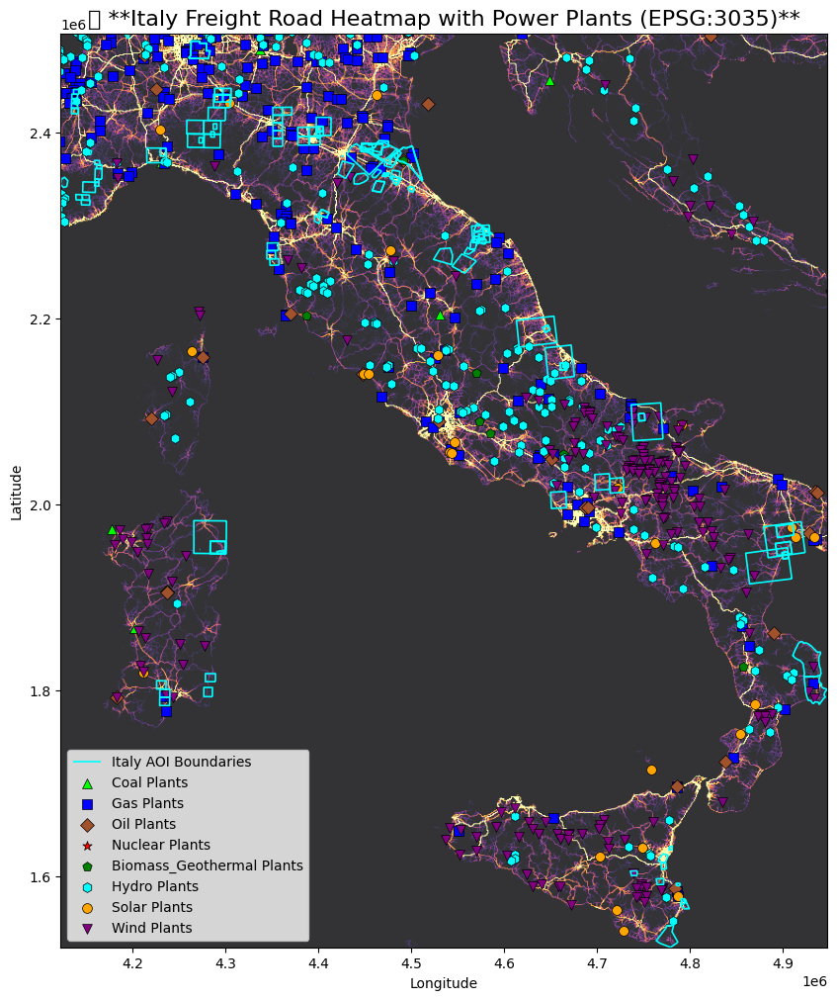

In [ ]:
# 🚀 File Paths
freight_tif_path = "/content/HARCI_EU_Download_Unzipped/ci_tra01.tif"  # Freight road raster
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"  # Italy AOI SHP folder

# ✅ Energy Plant TIF Files
energy_tif_paths = {
    "Coal": "/content/HARCI_EU_Download_Unzipped/ci_ene01.tif",
    "Gas": "/content/HARCI_EU_Download_Unzipped/ci_ene02.tif",
    "Oil": "/content/HARCI_EU_Download_Unzipped/ci_ene03.tif",
    "Nuclear": "/content/HARCI_EU_Download_Unzipped/ci_ene04.tif",
    "Biomass_Geothermal": "/content/HARCI_EU_Download_Unzipped/ci_ene05.tif",
    "Hydro": "/content/HARCI_EU_Download_Unzipped/ci_ene06.tif",
    "Solar": "/content/HARCI_EU_Download_Unzipped/ci_ene07.tif",
    "Wind": "/content/HARCI_EU_Download_Unzipped/ci_ene08.tif",
}

# ✅ Marker Colors & Shapes for Each Energy Type
ENERGY_COLORS = {
    "Coal": "lime",
    "Gas": "blue",
    "Oil": "sienna",
    "Nuclear": "red",
    "Biomass_Geothermal": "green",
    "Hydro": "cyan",
    "Solar": "orange",
    "Wind": "purple",
}

ENERGY_SHAPES = {
    "Coal": "^",  # Triangle
    "Gas": "s",   # Square
    "Oil": "D",   # Diamond
    "Nuclear": "*",  # Star
    "Biomass_Geothermal": "p",  # Pentagon
    "Hydro": "h",  # Hexagon
    "Solar": "o",  # Circle
    "Wind": "v",  # Downward Triangle
}

ENERGY_SIZE = 50  # Marker size

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load Freight Road Raster Data
with rasterio.open(freight_tif_path) as src:
    print(f"📄 Original CRS: {src.crs}")  # Should be EPSG:3035

    # Read raster data
    data = src.read(1)
    data_masked = np.ma.masked_where(data == src.nodata, data)
    transform = src.transform  # Affine transformation

# ✅ Normalize & Transform Raster Data
data_boosted = np.where(np.isnan(data_masked), 0, data_masked)
data_boosted = np.where(data_boosted < 0, 0, data_boosted)  # Ensure non-negative values
data_boosted = np.log1p(data_boosted)  # Log transformation

# Normalize between 5th and 99th percentile
valid_values = data_boosted[~np.isnan(data_boosted)]
data_min, data_max = np.percentile(valid_values, [5, 99])
data_boosted = np.clip((data_boosted - data_min) / (data_max - data_min), 0, 1)

# ✅ Load & Merge Only SHP Files Matching "area"
italy_shp_files = [
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)  # ✅ Only SHP files with "area" in name
]

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3035)
    gdfs = [gpd.read_file(shp).to_crs(epsg=3035) for shp in italy_shp_files]
    italy_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Compute AOI Bounding Box
if italy_gdf is not None:
    xmin, ymin, xmax, ymax = italy_gdf.total_bounds  # ✅ Restrict zoom to AOI boundary
    print(f"📐 AOI Bounding Box: ({xmin}, {ymin}, {xmax}, {ymax})")
else:
    with rasterio.open(freight_tif_path) as src:
        xmin, xmax = src.bounds.left, src.bounds.right
        ymin, ymax = src.bounds.bottom, src.bounds.top

# ✅ Extract Power Plant Locations from Each Energy Raster
energy_locations = {}

for energy_type, tif_path in energy_tif_paths.items():
    if not os.path.exists(tif_path):
        print(f"⚠️ {energy_type} TIF file not found. Skipping...")
        continue

    with rasterio.open(tif_path) as src:
        plant_data = src.read(1)  # Read first band
        nodata_value = src.nodata  # Get NoData value

    # Mask NoData values and find non-zero locations
    valid_pixels = np.where((plant_data != nodata_value) & (plant_data > 0))

    # Convert pixel locations to real-world coordinates (EPSG:3035)
    x_coords, y_coords = rasterio.transform.xy(transform, valid_pixels[0], valid_pixels[1])

    # Store locations
    energy_locations[energy_type] = list(zip(x_coords, y_coords))
    print(f"✅ Extracted {len(energy_locations[energy_type])} {energy_type} Plants.")

# ✅ Plot Freight Road Heatmap with Italy AOI Boundaries & Power Plants
fig, ax = plt.subplots(figsize=(12, 12))

# Show raster heatmap
show(data_boosted, transform=transform, ax=ax, cmap="inferno", alpha=0.8)

# ✅ Plot AOI Boundaries (as lines only, no filled polygons)
if italy_gdf is not None:
    italy_gdf.boundary.plot(ax=ax, color="cyan", linewidth=1.2, alpha=1, label="Italy AOI Boundaries")

# ✅ Overlay Power Plant Locations as Scatter Points
for energy_type, locations in energy_locations.items():
    ax.scatter(
        [p[0] for p in locations],  # X coordinates
        [p[1] for p in locations],  # Y coordinates
        color=ENERGY_COLORS[energy_type], marker=ENERGY_SHAPES[energy_type], s=ENERGY_SIZE,
        edgecolor="black", linewidth=0.5, label=f"{energy_type} Plants"
    )

# ✅ Restrict plot zoom to AOI bounding box
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# ✅ Set labels and title
ax.set_title("🚗 **Italy Freight Road Heatmap with Power Plants (EPSG:3035)**", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.legend()

# ✅ Save the plot
save_path = "plot_images/italy"
os.makedirs(save_path, exist_ok=True)
plt.savefig(os.path.join(save_path, "italy_aoi_heatmap_energy.png"), dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

✅ Found 123 AOI SHP files for Italy.


<ipython-input-22-71be7cad7d08>:46: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = plt.cm.get_cmap("Set1", num_ids)  # Use 'Set1' for better color separation
<ipython-input-22-71be7cad7d08>:80: UserWarning: Glyph 128205 (\N{ROUND PUSHPIN}) missing from font(s) DejaVu Sans.
  plt.savefig(os.path.join(save_path, "italy_aoi_emsr_basemap_colab.png"), dpi=300, bbox_inches='tight')
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128205 (\N{ROUND PUSHPIN}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


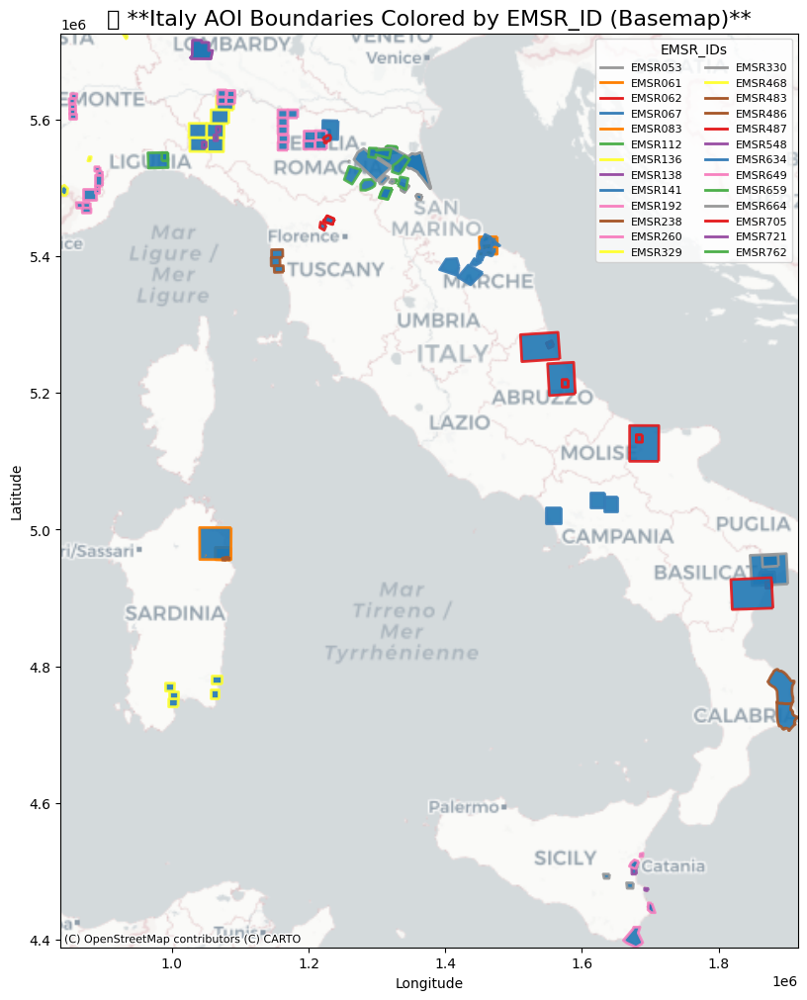

In [ ]:


# 🚀 File Paths
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Extract EMSR_ID from Filenames
EMSR_PATTERN = re.compile(r"(EMSR\d+)")  # Matches 'EMSR' followed by numbers

# ✅ Load AOI Shapefiles & Extract EMSR_ID
italy_shp_files = [
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)
]

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load all SHP files and extract EMSR_ID
    gdf_list = []
    emsr_ids = []

    for shp in italy_shp_files:
        gdf = gpd.read_file(shp).to_crs(epsg=3857)  # Convert to Web Mercator for basemap compatibility

        # Extract EMSR_ID from filename
        match = EMSR_PATTERN.search(shp)
        emsr_id = match.group(1) if match else "Unknown"

        gdf["EMSR_ID"] = emsr_id  # Assign EMSR_ID as a new column
        gdf_list.append(gdf)
        emsr_ids.append(emsr_id)

    # Combine all AOI SHP files into one GeoDataFrame
    italy_gdf = gpd.GeoDataFrame(pd.concat(gdf_list, ignore_index=True))

# ✅ Assign Colors Based on EMSR_IDs
unique_emsr_ids = sorted(set(emsr_ids))
num_ids = len(unique_emsr_ids)

# Improved colormap: Use "Set1" or "tab20b" for better color differentiation
colormap = plt.cm.get_cmap("Set1", num_ids)  # Use 'Set1' for better color separation

# Shuffle colors to **ensure nearby EMSR_IDs get different colors**
color_list = [colormap(i / max(num_ids - 1, 1)) for i in range(num_ids)]
random.shuffle(color_list)  # Shuffle colors for visual distinction
emsr_color_map = {emsr_id: color_list[i] for i, emsr_id in enumerate(unique_emsr_ids)}

# ✅ Plot AOI Boundaries on a Basemap of Italy
fig, ax = plt.subplots(figsize=(12, 12))

# Set basemap limits (Italy bounding box in Web Mercator)
xmin, ymin, xmax, ymax = italy_gdf.total_bounds
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# ✅ Add a **Colab-Compatible Basemap**
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, zoom=6)  # Light basemap

# ✅ Plot each EMSR_ID with its assigned color
for emsr_id, color in emsr_color_map.items():
    italy_gdf[italy_gdf["EMSR_ID"] == emsr_id].plot(ax=ax, edgecolor=color, linewidth=2, label=emsr_id, alpha=0.9)

# ✅ Add Legend Mapping EMSR_IDs to Colors
legend_patches = [plt.Line2D([0], [0], color=color, linewidth=2, label=emsr_id) for emsr_id, color in emsr_color_map.items()]
ax.legend(handles=legend_patches, title="EMSR_IDs", loc="upper right", fontsize=8, ncol=2)

# ✅ Set Labels and Title
ax.set_title("📍 **Italy AOI Boundaries Colored by EMSR_ID (Basemap)**", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# ✅ Save the Plot
save_path = "plot_images/italy"
os.makedirs(save_path, exist_ok=True)
plt.savefig(os.path.join(save_path, "italy_aoi_emsr_basemap_colab.png"), dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

✅ Found 123 AOI SHP files for Italy.
✅ Centroid X Range: 842598.1229661563 1897810.410507652
✅ Centroid Y Range: 4402939.7039782815 5722015.3597829295


<ipython-input-143-1fdb1fb8a2cd>:80: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


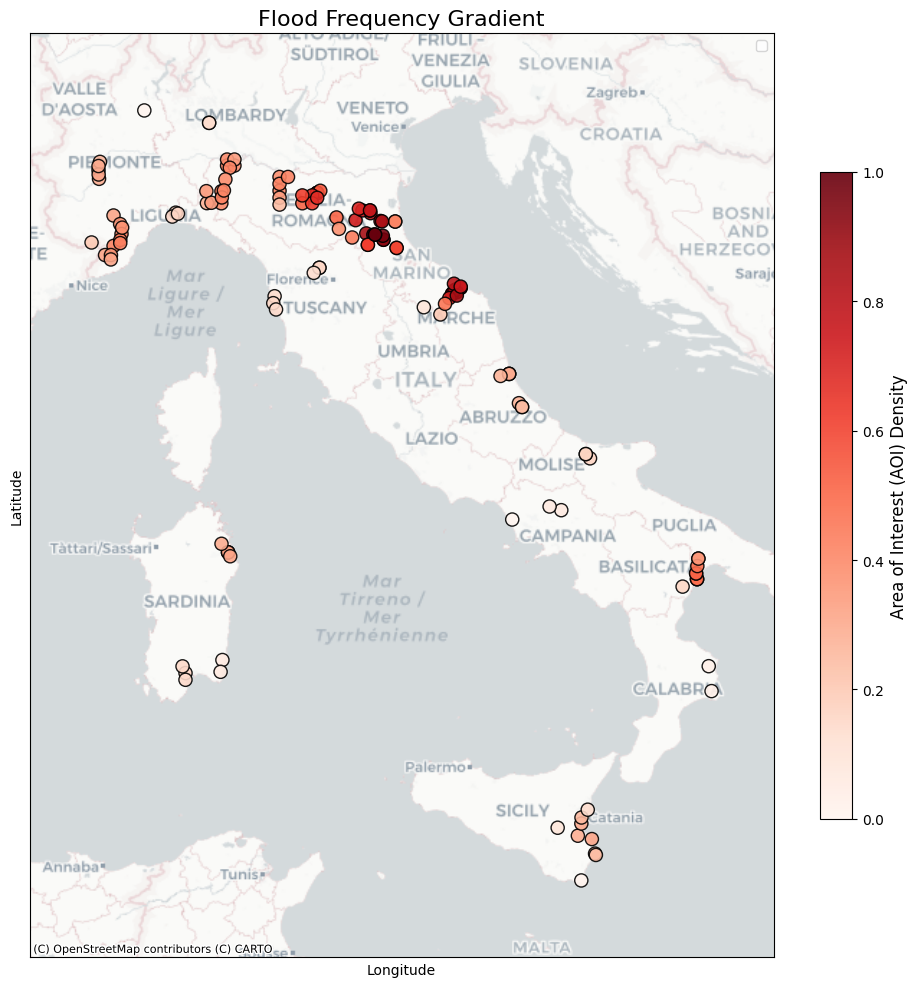

In [ ]:

# 🚀 File Paths
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load AOI Shapefiles & Extract Centroids
italy_shp_files = [
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)
]

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3035 initially)
    gdf_list = [gpd.read_file(shp).to_crs(epsg=3035) for shp in italy_shp_files]
    italy_gdf = gpd.GeoDataFrame(pd.concat(gdf_list, ignore_index=True))

# ✅ Compute AOI Centroids and Reproject to EPSG:3857 (Web Mercator for Basemap)
if italy_gdf is not None and not italy_gdf.empty:
    italy_gdf["centroid"] = italy_gdf.geometry.centroid
    # Convert centroids to EPSG:3857
    italy_gdf = italy_gdf.set_geometry("centroid").to_crs(epsg=3857)

    centroid_x = italy_gdf.geometry.x
    centroid_y = italy_gdf.geometry.y

    print("✅ Centroid X Range:", centroid_x.min(), centroid_x.max())
    print("✅ Centroid Y Range:", centroid_y.min(), centroid_y.max())

else:
    centroid_x, centroid_y = [], []
    print("⚠️ No valid AOI centroids found!")

# ✅ Create Heatmap of AOI Density
fig, ax = plt.subplots(figsize=(12, 12))

# If we have data, set manual x/y limits
if len(centroid_x) > 0:
    x_min, x_max = centroid_x.min(), centroid_x.max()
    y_min, y_max = centroid_y.min(), centroid_y.max()

    # Add some padding
    pad_x = (x_max - x_min) * 0.1
    pad_y = (y_max - y_min) * 0.1

    ax.set_xlim(x_min - pad_x, x_max + pad_x)
    ax.set_ylim(y_min - pad_y, y_max + pad_y)

    # Add basemap
    ctx.add_basemap(ax, crs="EPSG:3857", source=ctx.providers.CartoDB.Positron)

    # Plot density heatmap
    xy = np.vstack([centroid_x, centroid_y])
    kde_values = gaussian_kde(xy, bw_method=0.1)(xy)
    # Normalize
    kde_values = (kde_values - kde_values.min()) / (kde_values.max() - kde_values.min())

    sc = ax.scatter(centroid_x, centroid_y, c=kde_values, cmap="Reds", alpha=0.9, edgecolor="black", s=90)
    cbar = plt.colorbar(sc, ax=ax, shrink=0.7)
    cbar.set_label("Area of Interest (AOI) Density", fontsize=12)

else:
    print("⚠️ No AOI centroid data to plot!")

# ✅ Set Labels & Title
ax.set_title("Flood Frequency Gradient", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# ✅ Save the Plot
save_path = "plot_images/italy"
os.makedirs(save_path, exist_ok=True)
plt.savefig(os.path.join(save_path, "italy_aoi_density_heatmap_manual_zoom.png"), dpi=300, bbox_inches='tight')
ax.legend()
ax.set_xticks([])
ax.set_yticks([])
plt.show()

✅ Found 123 AOI SHP files for Italy.
✅ Found 25 AOIs in the Bologna region.
✅ Coal: 0 power plants in Bologna AOI.
✅ Gas: 8 power plants in Bologna AOI.
✅ Oil: 2 power plants in Bologna AOI.
✅ Nuclear: 0 power plants in Bologna AOI.
✅ Biomass_Geothermal: 2 power plants in Bologna AOI.
✅ Hydro: 0 power plants in Bologna AOI.
✅ Solar: 0 power plants in Bologna AOI.
✅ Wind: 0 power plants in Bologna AOI.
✅ Metal Industry: 12 industries in Bologna AOI.
✅ Mineral Industry: 8 industries in Bologna AOI.
✅ Chemical Industry: 10 industries in Bologna AOI.
✅ Refineries: 0 industries in Bologna AOI.
✅ Water & Waste Treatment: 35 industries in Bologna AOI.


<ipython-input-24-d98fee8b9192>:138: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  ax.scatter(
<ipython-input-24-d98fee8b9192>:166: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


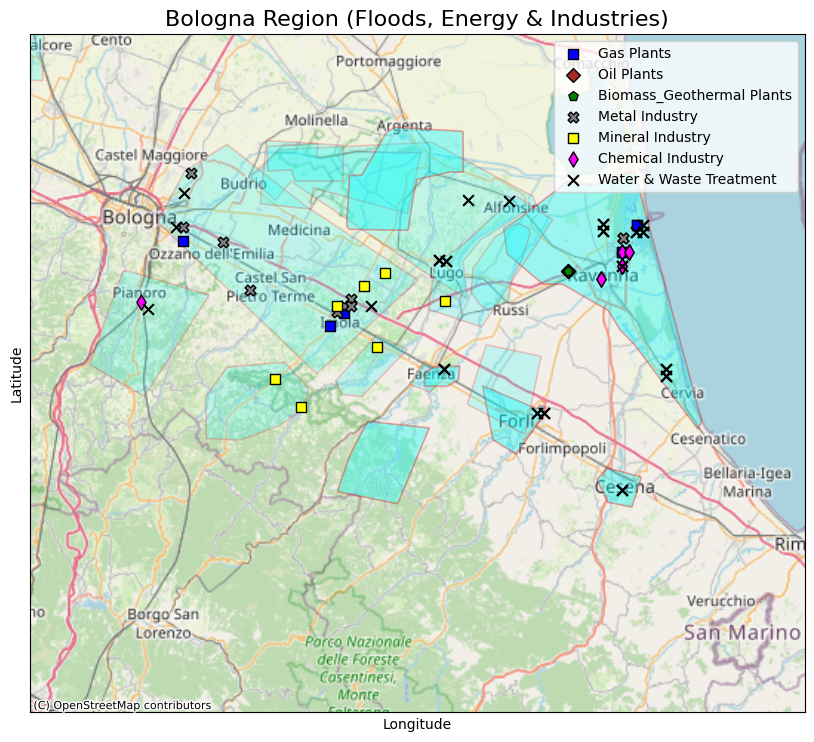

In [ ]:


# 🚀 File paths
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"  # AOI SHP folder
energy_tif_paths = {
    "Coal": "/content/HARCI_EU_Download_Unzipped/ci_ene01.tif",
    "Gas": "/content/HARCI_EU_Download_Unzipped/ci_ene02.tif",
    "Oil": "/content/HARCI_EU_Download_Unzipped/ci_ene03.tif",
    "Nuclear": "/content/HARCI_EU_Download_Unzipped/ci_ene04.tif",
    "Biomass_Geothermal": "/content/HARCI_EU_Download_Unzipped/ci_ene05.tif",
    "Hydro": "/content/HARCI_EU_Download_Unzipped/ci_ene06.tif",
    "Solar": "/content/HARCI_EU_Download_Unzipped/ci_ene07.tif",
    "Wind": "/content/HARCI_EU_Download_Unzipped/ci_ene08.tif"
}

industry_tif_paths = {
    "Metal Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind01.tif",
    "Mineral Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind02.tif",
    "Chemical Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind03.tif",
    "Refineries": "/content/HARCI_EU_Download_Unzipped/ci_ind04.tif",
    "Water & Waste Treatment": "/content/HARCI_EU_Download_Unzipped/ci_ind05.tif"
}

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load & Merge Only SHP Files Matching "area"
italy_shp_files = [
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)
]

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3857 for basemap)
    gdfs = [gpd.read_file(shp).to_crs(epsg=3857) for shp in italy_shp_files]
    italy_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Define Bounding Box for Bologna & Nearby AOI Hotspots
bologna_bounds = {
    "xmin": 1240000, "xmax": 1400000,  # Longitude range
    "ymin": 5440000, "ymax": 5580000   # Latitude range
}

# ✅ Filter AOIs in the Bologna Region
bologna_gdf = italy_gdf.cx[
    bologna_bounds["xmin"]:bologna_bounds["xmax"],
    bologna_bounds["ymin"]:bologna_bounds["ymax"]
]

if bologna_gdf.empty:
    print("⚠️ No AOIs found in the Bologna bounding box!")
else:
    print(f"✅ Found {len(bologna_gdf)} AOIs in the Bologna region.")

# ✅ Load Energy & Industry Locations from TIF Files (Only within Flood-Affected AOIs)
ENERGY_COLORS = {
    "Coal": "black", "Gas": "blue", "Oil": "brown",
    "Nuclear": "red", "Biomass_Geothermal": "green",
    "Hydro": "cyan", "Solar": "orange", "Wind": "purple"
}
ENERGY_SHAPES = {
    "Coal": "o", "Gas": "s", "Oil": "D",
    "Nuclear": "*", "Biomass_Geothermal": "p",
    "Hydro": "H", "Solar": "^", "Wind": "v"
}

INDUSTRY_COLORS = {
    "Metal Industry": "gray", "Mineral Industry": "yellow",
    "Chemical Industry": "magenta", "Refineries": "brown",
    "Water & Waste Treatment": "black"
}
INDUSTRY_SHAPES = {
    "Metal Industry": "X", "Mineral Industry": "s",
    "Chemical Industry": "d", "Refineries": "P",
    "Water & Waste Treatment": "x"
}

energy_points = {key: [] for key in energy_tif_paths.keys()}
industry_points = {key: [] for key in industry_tif_paths.keys()}

# Function to extract valid points from TIF and filter by AOI
def extract_points_from_tif(tif_path, aoi_gdf):
    with rasterio.open(tif_path) as src:
        data = src.read(1)
        transform = src.transform
        nodata_value = src.nodata

        # Mask NoData and find non-zero values
        valid_pixels = np.where((data != nodata_value) & (data > 0))
        x_coords, y_coords = rasterio.transform.xy(transform, valid_pixels[0], valid_pixels[1])

        # Convert to GeoDataFrame
        points_gdf = gpd.GeoDataFrame(geometry=gpd.points_from_xy(x_coords, y_coords), crs=src.crs)
        points_gdf = points_gdf.to_crs(epsg=3857)  # Convert to match AOI CRS

        # Keep only points within AOI flood boundaries
        points_gdf = gpd.sjoin(points_gdf, aoi_gdf, predicate="within")

        return points_gdf.geometry.tolist()

# Extract energy plants within AOI flood areas
for energy_type, tif_path in energy_tif_paths.items():
    energy_points[energy_type] = extract_points_from_tif(tif_path, bologna_gdf)
    print(f"✅ {energy_type}: {len(energy_points[energy_type])} power plants in Bologna AOI.")

# Extract industry locations within AOI flood areas
for industry_type, tif_path in industry_tif_paths.items():
    industry_points[industry_type] = extract_points_from_tif(tif_path, bologna_gdf)
    print(f"✅ {industry_type}: {len(industry_points[industry_type])} industries in Bologna AOI.")

# ✅ Plot Bologna AOI Map with Energy Plants & Industries
fig, ax = plt.subplots(figsize=(10, 10))

# Highlight AOI regions with a transparent blue shade
bologna_gdf.plot(ax=ax, color="cyan", alpha=0.2, edgecolor="red", linewidth=1.2, label="Bologna AOI Boundaries")

# Plot Energy Plants
for energy_type, points in energy_points.items():
    if points:
        x_vals = [p.x for p in points]
        y_vals = [p.y for p in points]
        ax.scatter(
            x_vals, y_vals, color=ENERGY_COLORS[energy_type],
            marker=ENERGY_SHAPES[energy_type], s=50,
            edgecolor="black" if ENERGY_SHAPES[energy_type] != "o" else None,  # Avoid edgecolor for circular markers
            label=f"{energy_type} Plants"
            )

# Plot Industry Locations
for industry_type, points in industry_points.items():
    if points:
        x_vals = [p.x for p in points]
        y_vals = [p.y for p in points]
        ax.scatter(
            x_vals, y_vals, color=INDUSTRY_COLORS[industry_type],
            marker=INDUSTRY_SHAPES[industry_type], s=60,
            edgecolor="black" if INDUSTRY_SHAPES[industry_type] != "o" else None,
            label=f"{industry_type}"
            )


# Add Basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)


# ✅ Set Zoom Limits to Bologna
ax.set_xlim(bologna_bounds["xmin"], bologna_bounds["xmax"])
ax.set_ylim(bologna_bounds["ymin"], bologna_bounds["ymax"])

# ✅ Format & Save the Plot
ax.set_title("Emilia-Romangna Region (Floods, Energy & Industries)", fontsize=16)

# ✅ Prevent Scientific Notation in Axis Labels
ax.set_xticks([])
ax.set_yticks([])



# ✅ Label Axes
ax.legend()

# Save the plot
save_path = "plot_images/italy_bologna"
os.makedirs(save_path, exist_ok=True)
plt.savefig(os.path.join(save_path, "bologna_aoi_energy_industry_zoom.png"), dpi=300, bbox_inches="tight")

# Show the plot
plt.show()

✅ Found 123 AOI SHP files for Italy.
✅ Found 25 AOIs in the Bologna region.
✅ Coal: 0 power plants in Bologna AOI.
✅ Gas: 8 power plants in Bologna AOI.
✅ Oil: 2 power plants in Bologna AOI.
✅ Nuclear: 0 power plants in Bologna AOI.
✅ Biomass_Geothermal: 2 power plants in Bologna AOI.
✅ Hydro: 0 power plants in Bologna AOI.
✅ Solar: 0 power plants in Bologna AOI.
✅ Wind: 0 power plants in Bologna AOI.
✅ Metal Industry: 12 industries in Bologna AOI.
✅ Mineral Industry: 8 industries in Bologna AOI.
✅ Chemical Industry: 10 industries in Bologna AOI.
✅ Refineries: 0 industries in Bologna AOI.
✅ Water & Waste Treatment: 35 industries in Bologna AOI.


<ipython-input-149-7a779c9f3375>:160: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


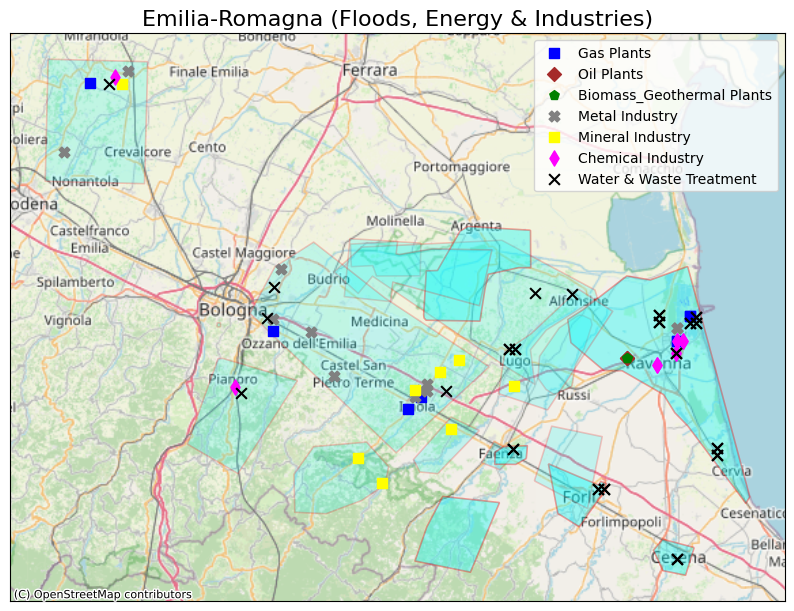

In [ ]:
import os
import re
import rasterio
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
import pandas as pd

# 🚀 File paths
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"  # AOI SHP folder
energy_tif_paths = {
    "Coal": "/content/HARCI_EU_Download_Unzipped/ci_ene01.tif",
    "Gas": "/content/HARCI_EU_Download_Unzipped/ci_ene02.tif",
    "Oil": "/content/HARCI_EU_Download_Unzipped/ci_ene03.tif",
    "Nuclear": "/content/HARCI_EU_Download_Unzipped/ci_ene04.tif",
    "Biomass_Geothermal": "/content/HARCI_EU_Download_Unzipped/ci_ene05.tif",
    "Hydro": "/content/HARCI_EU_Download_Unzipped/ci_ene06.tif",
    "Solar": "/content/HARCI_EU_Download_Unzipped/ci_ene07.tif",
    "Wind": "/content/HARCI_EU_Download_Unzipped/ci_ene08.tif"
}

industry_tif_paths = {
    "Metal Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind01.tif",
    "Mineral Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind02.tif",
    "Chemical Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind03.tif",
    "Refineries": "/content/HARCI_EU_Download_Unzipped/ci_ind04.tif",
    "Water & Waste Treatment": "/content/HARCI_EU_Download_Unzipped/ci_ind05.tif"
}

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load & Merge Only SHP Files Matching "area"
italy_shp_files = list({
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)
})  # Use set() to avoid duplicates

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3857 for basemap)
    gdfs = []
    for shp in italy_shp_files:
        gdf = gpd.read_file(shp)
        if gdf.crs is not None and gdf.crs.to_epsg() != 3857:
            gdf = gdf.to_crs(epsg=3857)  # Convert to EPSG:3857
        gdfs.append(gdf)

    italy_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Define Bounding Box for Bologna & Nearby AOI Hotspots
bologna_bounds = {
    "xmin": 1240000, "xmax": 1400000,  # Longitude range
    "ymin": 5440000, "ymax": 5580000   # Latitude range
}

# ✅ Filter AOIs in the Bologna Region
bologna_gdf = italy_gdf.cx[
    bologna_bounds["xmin"]:bologna_bounds["xmax"],
    bologna_bounds["ymin"]:bologna_bounds["ymax"]
]

if bologna_gdf.empty:
    print("⚠️ No AOIs found in the Bologna bounding box!")
else:
    print(f"✅ Found {len(bologna_gdf)} AOIs in the Bologna region.")

# ✅ Load Energy & Industry Locations from TIF Files (Only within Flood-Affected AOIs)
ENERGY_COLORS = {
    "Coal": "black", "Gas": "blue", "Oil": "brown",
    "Nuclear": "red", "Biomass_Geothermal": "green",
    "Hydro": "cyan", "Solar": "orange", "Wind": "purple"
}
ENERGY_SHAPES = {
    "Coal": "o", "Gas": "s", "Oil": "D",
    "Nuclear": "*", "Biomass_Geothermal": "p",
    "Hydro": "H", "Solar": "^", "Wind": "v"
}

INDUSTRY_COLORS = {
    "Metal Industry": "gray", "Mineral Industry": "yellow",
    "Chemical Industry": "magenta", "Refineries": "brown",
    "Water & Waste Treatment": "black"
}
INDUSTRY_SHAPES = {
    "Metal Industry": "X", "Mineral Industry": "s",
    "Chemical Industry": "d", "Refineries": "P",
    "Water & Waste Treatment": "x"
}

energy_points = {key: [] for key in energy_tif_paths.keys()}
industry_points = {key: [] for key in industry_tif_paths.keys()}

# Function to extract valid points from TIF and filter by AOI
def extract_points_from_tif(tif_path, aoi_gdf):
    with rasterio.open(tif_path) as src:
        data = src.read(1)
        transform = src.transform
        nodata_value = src.nodata

        # Mask NoData and find non-zero values
        valid_pixels = np.where((data != nodata_value) & (data > 0))
        x_coords, y_coords = rasterio.transform.xy(transform, valid_pixels[0], valid_pixels[1])

        # Convert to GeoDataFrame
        points_gdf = gpd.GeoDataFrame(geometry=gpd.points_from_xy(x_coords, y_coords), crs=src.crs)

        # Convert CRS if necessary
        if points_gdf.crs.to_epsg() != 3857:
            points_gdf = points_gdf.to_crs(epsg=3857)

        # Keep only points within AOI flood boundaries
        points_gdf = gpd.sjoin(points_gdf, aoi_gdf, predicate="within")

        return points_gdf.geometry.tolist()

# Extract energy plants within AOI flood areas
for energy_type, tif_path in energy_tif_paths.items():
    energy_points[energy_type] = extract_points_from_tif(tif_path, bologna_gdf)
    print(f"✅ {energy_type}: {len(energy_points[energy_type])} power plants in Bologna AOI.")

# Extract industry locations within AOI flood areas
for industry_type, tif_path in industry_tif_paths.items():
    industry_points[industry_type] = extract_points_from_tif(tif_path, bologna_gdf)
    print(f"✅ {industry_type}: {len(industry_points[industry_type])} industries in Bologna AOI.")

# ✅ Plot Bologna AOI Map with Energy Plants & Industries
fig, ax = plt.subplots(figsize=(10, 10))

# Highlight AOI regions with a transparent blue shade
bologna_gdf.plot(ax=ax, color="cyan", alpha=0.2, edgecolor="red", linewidth=1.2, label="Bologna AOI Boundaries")

# Plot Energy Plants
for energy_type, points in energy_points.items():
    if points:
        x_vals = [p.x for p in points]
        y_vals = [p.y for p in points]
        ax.scatter(x_vals, y_vals, color=ENERGY_COLORS[energy_type], marker=ENERGY_SHAPES[energy_type], s=50, label=f"{energy_type} Plants")

# Plot Industry Locations
for industry_type, points in industry_points.items():
    if points:
        x_vals = [p.x for p in points]
        y_vals = [p.y for p in points]
        ax.scatter(x_vals, y_vals, color=INDUSTRY_COLORS[industry_type], marker=INDUSTRY_SHAPES[industry_type], s=60, label=f"{industry_type}")

# Add Basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# ✅ Label & Save Plot
ax.set_title("Emilia-Romagna (Floods, Energy & Industries)", fontsize=16)
ax.set_xticks([])
ax.set_yticks([])
ax.legend()
plt.show()


✅ Found 123 AOI SHP files for Italy.
✅ Found 25 AOIs in the Bologna region.
✅ Found 79 SHP files for category: event
✅ Found 29 SHP files for category: facilitiesA
✅ Found 9 SHP files for category: facilitiesL
✅ Found 66 SHP files for category: settlements
✅ Found 48 SHP files for category: facilities
✅ Found 1 SHP files for category: facilitiesP


<ipython-input-25-92403152ac3e>:119: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend(title="Category Types", loc="upper right", fontsize=10)
<ipython-input-25-92403152ac3e>:119: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(title="Category Types", loc="upper right", fontsize=10)


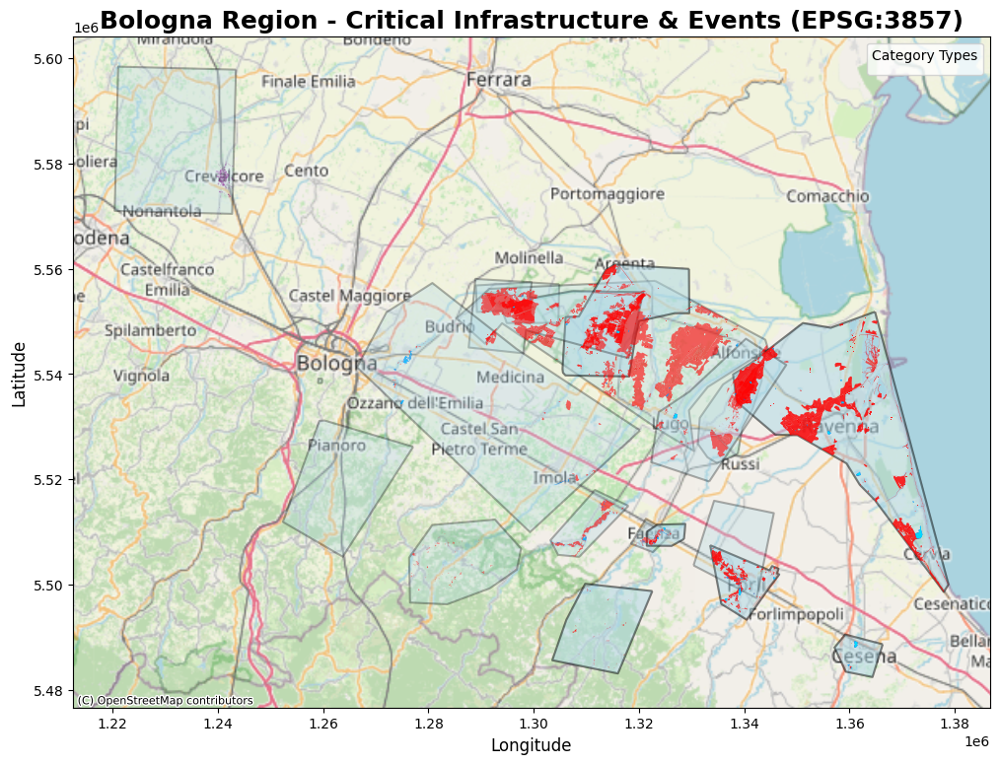

In [ ]:


# 🚀 File paths
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"

# ✅ Categories to process
categories = ["event", "facilitiesA", "facilitiesL", "settlements", "facilities", "facilitiesP"]

# ✅ Define Colors for Each Category
CATEGORY_COLORS = {
    "event": "red",               # 🚨 High-risk event areas
    "facilitiesA": "blue",        # 🏥 Critical infrastructure
    "facilitiesL": "blue",
    "settlements": "purple",      # 🏘️ Populated zones
    "facilities": "cyan",         # 🏗️ General facilities
    "facilitiesP": "cyan"
}

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load & Merge Only SHP Files Matching "area"
italy_shp_files = list({
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)
})  # Use set() to avoid duplicates

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3857 for basemap)
    gdfs = []
    for shp in italy_shp_files:
        gdf = gpd.read_file(shp)
        if gdf.crs is not None and gdf.crs.to_epsg() != 3857:
            gdf = gdf.to_crs(epsg=3857)  # Convert to EPSG:3857
        gdfs.append(gdf)

    italy_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Define Bounding Box for Bologna Region
bologna_bounds = {
    "xmin": 1240000, "xmax": 1400000,  # Longitude range
    "ymin": 5440000, "ymax": 5580000   # Latitude range
}

# ✅ Filter AOIs in the Bologna Region
bologna_gdf = italy_gdf.cx[
    bologna_bounds["xmin"]:bologna_bounds["xmax"],
    bologna_bounds["ymin"]:bologna_bounds["ymax"]
]

if bologna_gdf.empty:
    print("⚠️ No AOIs found in the Bologna bounding box!")
else:
    print(f"✅ Found {len(bologna_gdf)} AOIs in the Bologna region.")

# ✅ Process & Load SHP Files for Selected Categories (ONLY MULTIPOLYGONS)
category_gdfs = {}

for category in categories:
    category_pattern = re.compile(rf".*{category}.*\.shp$", re.IGNORECASE)

    # Find matching SHP files
    category_files = list({
        os.path.join(root, file)
        for root, _, files in os.walk(italy_shp_folder)
        for file in files if category_pattern.search(file)
    })  # Use set() to avoid duplicates

    if category_files:
        print(f"✅ Found {len(category_files)} SHP files for category: {category}")

        # Load & Merge category SHP files
        gdfs = []
        for shp in category_files:
            gdf = gpd.read_file(shp)

            # ✅ Filter ONLY Multipolygons
            gdf = gdf[gdf.geometry.type.isin(["Polygon", "MultiPolygon"])]

            # ✅ Convert CRS to EPSG:3857
            if gdf.crs is not None and gdf.crs.to_epsg() != 3857:
                gdf = gdf.to_crs(epsg=3857)

            gdfs.append(gdf)

        if gdfs:
            category_gdfs[category] = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))
    else:
        print(f"⚠️ No SHP files found for category: {category}")



# ✅ Plot Bologna AOI Map with Categories
fig, ax = plt.subplots(figsize=(12, 10))

# 🔹 **Plot AOI boundaries (light blue for contrast)**
bologna_gdf.plot(ax=ax, color="lightblue", alpha=0.3, edgecolor="black", linewidth=1.5, label="Bologna AOI (Flood Zone)")

# 🔹 **Plot Category Layers**
for category, gdf in category_gdfs.items():
    if not gdf.empty:
        gdf.cx[bologna_bounds["xmin"]:bologna_bounds["xmax"], bologna_bounds["ymin"]:bologna_bounds["ymax"]].plot(
            ax=ax, color=CATEGORY_COLORS[category], alpha=0.6, label=f"{category} Impacted Areas"
        )

# ✅ **Add Basemap for Context**
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# ✅ **Improved Title & Axis Labels for Client Understanding**
ax.set_title("Bologna Region - Critical Infrastructure & Events (EPSG:3857)", fontsize=18, fontweight="bold")
ax.set_xlabel("Longitude", fontsize=12)
ax.set_ylabel("Latitude", fontsize=12)

# ✅ **Legend with Improved Readability**
ax.legend(title="Category Types", loc="upper right", fontsize=10)

# ✅ **Save & Show Plot**
plt.savefig("bologna_critical_infra.png", dpi=300, bbox_inches="tight")
plt.show()

✅ Found 123 AOI SHP files for Italy.
✅ Found 9 AOIs in the Marche region.
✅ Coal: 0 power plants in Marche AOI.
✅ Gas: 0 power plants in Marche AOI.
✅ Oil: 0 power plants in Marche AOI.
✅ Nuclear: 0 power plants in Marche AOI.
✅ Biomass_Geothermal: 0 power plants in Marche AOI.
✅ Hydro: 2 power plants in Marche AOI.
✅ Solar: 0 power plants in Marche AOI.
✅ Wind: 0 power plants in Marche AOI.
✅ Metal Industry: 9 industries in Marche AOI.
✅ Mineral Industry: 4 industries in Marche AOI.
✅ Chemical Industry: 0 industries in Marche AOI.
✅ Refineries: 0 industries in Marche AOI.
✅ Water & Waste Treatment: 5 industries in Marche AOI.


<ipython-input-26-edfe98ba2ac4>:151: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


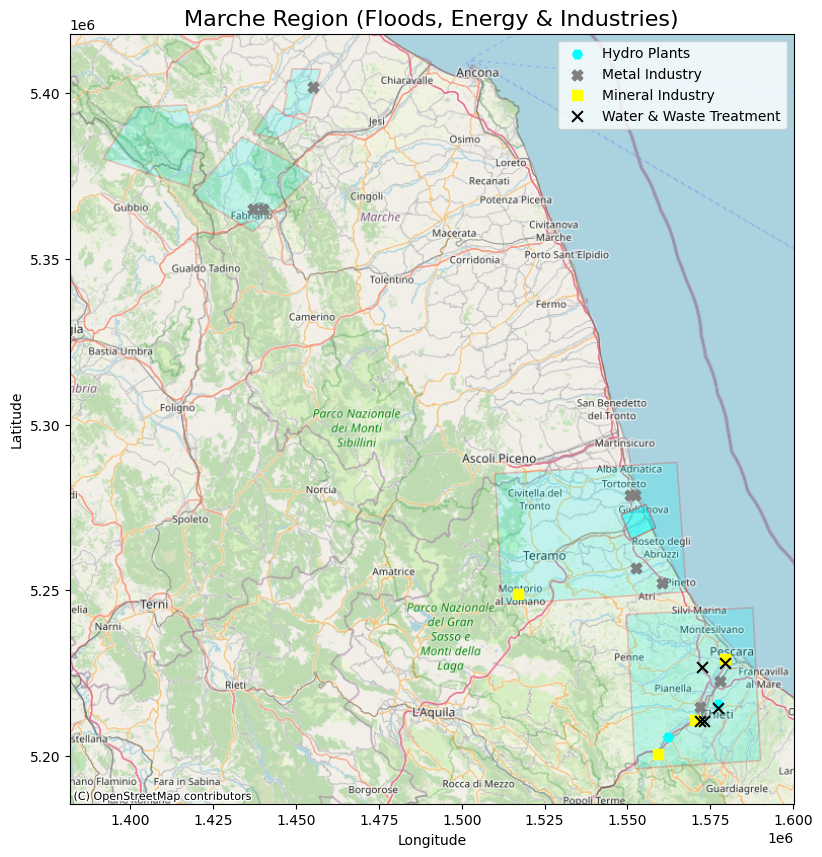

In [ ]:
# 🚀 File paths
italy_shp_folder = "/content/Copernicus_Downloads_Unzipped/Italy_Flood_SHP_Zip_Unzipped"  # AOI SHP folder
energy_tif_paths = {
    "Coal": "/content/HARCI_EU_Download_Unzipped/ci_ene01.tif",
    "Gas": "/content/HARCI_EU_Download_Unzipped/ci_ene02.tif",
    "Oil": "/content/HARCI_EU_Download_Unzipped/ci_ene03.tif",
    "Nuclear": "/content/HARCI_EU_Download_Unzipped/ci_ene04.tif",
    "Biomass_Geothermal": "/content/HARCI_EU_Download_Unzipped/ci_ene05.tif",
    "Hydro": "/content/HARCI_EU_Download_Unzipped/ci_ene06.tif",
    "Solar": "/content/HARCI_EU_Download_Unzipped/ci_ene07.tif",
    "Wind": "/content/HARCI_EU_Download_Unzipped/ci_ene08.tif"
}

industry_tif_paths = {
    "Metal Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind01.tif",
    "Mineral Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind02.tif",
    "Chemical Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind03.tif",
    "Refineries": "/content/HARCI_EU_Download_Unzipped/ci_ind04.tif",
    "Water & Waste Treatment": "/content/HARCI_EU_Download_Unzipped/ci_ind05.tif"
}

# ✅ AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r".*area.*\.shp$", re.IGNORECASE)

# ✅ Load & Merge Only SHP Files Matching "area"
italy_shp_files = list({
    os.path.join(root, file)
    for root, _, files in os.walk(italy_shp_folder)
    for file in files if AOI_PATTERN.search(file)
})  # Use set() to avoid duplicates

if not italy_shp_files:
    print("⚠️ No AOI SHP files found for Italy!")
    italy_gdf = None
else:
    print(f"✅ Found {len(italy_shp_files)} AOI SHP files for Italy.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3857 for basemap)
    gdfs = []
    for shp in italy_shp_files:
        gdf = gpd.read_file(shp)
        if gdf.crs is not None and gdf.crs.to_epsg() != 3857:
            gdf = gdf.to_crs(epsg=3857)  # Convert to EPSG:3857
        gdfs.append(gdf)

    italy_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Define Bounding Box for Marche Region
marche_bounds = {
    "xmin": 1.3e6, "xmax": 1.55e6,  # Longitude range
    "ymin": 5.1e6, "ymax": 5.4e6   # Latitude range
}

# ✅ Filter AOIs in the Marche Region
marche_gdf = italy_gdf.cx[
    marche_bounds["xmin"]:marche_bounds["xmax"],
    marche_bounds["ymin"]:marche_bounds["ymax"]
]

if marche_gdf.empty:
    print("⚠️ No AOIs found in the Marche bounding box!")
else:
    print(f"✅ Found {len(marche_gdf)} AOIs in the Marche region.")

# ✅ Load Energy & Industry Locations from TIF Files (Only within Flood-Affected AOIs)
ENERGY_COLORS = {
    "Coal": "black", "Gas": "blue", "Oil": "brown",
    "Nuclear": "red", "Biomass_Geothermal": "green",
    "Hydro": "cyan", "Solar": "orange", "Wind": "purple"
}
ENERGY_SHAPES = {
    "Coal": "o", "Gas": "s", "Oil": "D",
    "Nuclear": "*", "Biomass_Geothermal": "p",
    "Hydro": "H", "Solar": "^", "Wind": "v"
}

INDUSTRY_COLORS = {
    "Metal Industry": "gray", "Mineral Industry": "yellow",
    "Chemical Industry": "magenta", "Refineries": "brown",
    "Water & Waste Treatment": "black"
}
INDUSTRY_SHAPES = {
    "Metal Industry": "X", "Mineral Industry": "s",
    "Chemical Industry": "d", "Refineries": "P",
    "Water & Waste Treatment": "x"
}

energy_points = {key: [] for key in energy_tif_paths.keys()}
industry_points = {key: [] for key in industry_tif_paths.keys()}

# Function to extract valid points from TIF and filter by AOI
def extract_points_from_tif(tif_path, aoi_gdf):
    with rasterio.open(tif_path) as src:
        data = src.read(1)
        transform = src.transform
        nodata_value = src.nodata

        # Mask NoData and find non-zero values
        valid_pixels = np.where((data != nodata_value) & (data > 0))
        x_coords, y_coords = rasterio.transform.xy(transform, valid_pixels[0], valid_pixels[1])

        # Convert to GeoDataFrame
        points_gdf = gpd.GeoDataFrame(geometry=gpd.points_from_xy(x_coords, y_coords), crs=src.crs)

        # Convert CRS if necessary
        if points_gdf.crs.to_epsg() != 3857:
            points_gdf = points_gdf.to_crs(epsg=3857)

        # Keep only points within AOI flood boundaries
        points_gdf = gpd.sjoin(points_gdf, aoi_gdf, predicate="within")

        return points_gdf.geometry.tolist()

# Extract energy plants within AOI flood areas
for energy_type, tif_path in energy_tif_paths.items():
    energy_points[energy_type] = extract_points_from_tif(tif_path, marche_gdf)
    print(f"✅ {energy_type}: {len(energy_points[energy_type])} power plants in Marche AOI.")

# Extract industry locations within AOI flood areas
for industry_type, tif_path in industry_tif_paths.items():
    industry_points[industry_type] = extract_points_from_tif(tif_path, marche_gdf)
    print(f"✅ {industry_type}: {len(industry_points[industry_type])} industries in Marche AOI.")

# ✅ Plot Marche AOI Map with Energy Plants & Industries
fig, ax = plt.subplots(figsize=(10, 10))

# Highlight AOI regions with a transparent blue shade
marche_gdf.plot(ax=ax, color="cyan", alpha=0.2, edgecolor="red", linewidth=1.2, label="Marche AOI Boundaries")

# Plot Energy Plants
for energy_type, points in energy_points.items():
    if points:
        x_vals = [p.x for p in points]
        y_vals = [p.y for p in points]
        ax.scatter(x_vals, y_vals, color=ENERGY_COLORS[energy_type], marker=ENERGY_SHAPES[energy_type], s=50, label=f"{energy_type} Plants")

# Plot Industry Locations
for industry_type, points in industry_points.items():
    if points:
        x_vals = [p.x for p in points]
        y_vals = [p.y for p in points]
        ax.scatter(x_vals, y_vals, color=INDUSTRY_COLORS[industry_type], marker=INDUSTRY_SHAPES[industry_type], s=60, label=f"{industry_type}")

# Add Basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# ✅ Label & Save Plot
ax.set_title("Marche Region (Floods, Energy & Industries)", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.legend()
plt.show()

In [ ]:
#Load data
Italy_floods_H = pd.read_csv('/content/drive/MyDrive/Business Challenge II - Team 2/data/flood/combined_shapefile_data.csv')


<ipython-input-27-1f0bb1577cdb>:2: DtypeWarning: Columns (3,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,38,40,43,53) have mixed types. Specify dtype option on import or set low_memory=False.
  Italy_floods_H = pd.read_csv('/content/drive/MyDrive/Business Challenge II - Team 2/data/flood/combined_shapefile_data.csv')


Seeing what kinda of columns are in the csv to use for our analysis

In [ ]:
Italy_floods_H.columns

Index(['obj_type', 'name', 'info', 'simplified', 'damage_gra', 'det_method',
       'notation', 'or_src_id', 'dmg_src_id', 'cd_value', 'geometry',
       'EMSR_ID', 'Country', 'Event_Type', 'Source_File', 'src_date',
       'src_info', 'ext_scale', 'nam', 'ext_date', 'txt', 'subtype',
       'admin_lev', 'settl_type', 'functional', 'source_nam', 'event_type',
       'obj_desc', 'act_id', 'settl_acc', 'change_sta', 'grading', 'note',
       'oga', 'cpyrt_note', 'fcsubtype', 'src_name', 'objectid', 'fcode',
       'acc', 'nam_info', 'shape_Leng', 'shape_Area', 'SBTYPdes', 'intrp',
       'evnt', 'imp_ass', 'evnt_type', 'popul', 'type', 'fuc', 'flood_type',
       'fun', 'fucdesc', 'File_Group'],
      dtype='object')

seeing the unique counts for obj_types

In [ ]:
#Italy_floods['damage_gra'].value_counts()
Italy_floods_H['obj_type'].value_counts()

,count
obj_type,
995-Unclassified,83935
11-Residential Buildings,9217
12-Non-residential Buildings,6283
24-Other Civil Engineering Works,3894
"22-Pipelines, Communication and Electricity Lines",708
"215-Harbours, waterways, dams and other waterworks",178
23-Complex Constructions on Industrial Sites,93


In [ ]:
Italy_floods_H['txt'].isna().sum()

108503

This show the what time of damage grading is being applied to obj_type

In [ ]:
Italy_floods_H['damage_gra'].value_counts()

,count
damage_gra,
No visible damage,76371
Possibly damaged,21912
Damaged,5960
Not Analysed,380
Destroyed,35


 Filtering to the floods is Emilia Romagna because of the partnership Eoliann has in that region and it is a reagion with some of the most frequent floods

In [ ]:
EmiliaRom_floods = Italy_floods_H[Italy_floods_H['EMSR_ID'].isin(['EMSR067', 'EMSR136', 'EMSR138', 'EMSR487', 'EMSR659', 'EMSR762'])]


In [ ]:
EmiliaRom_floods

,obj_type,name,info,simplified,damage_gra,det_method,notation,or_src_id,dmg_src_id,cd_value,...,evnt,imp_ass,evnt_type,popul,type,fuc,flood_type,fun,fucdesc,File_Group
2129,11-Residential Buildings,Unknown,997-Not Applicable,NaN,Possibly damaged,Photo-interpretation,Building point,994.0,3.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_builtUpP_r1.shp
2130,12-Non-residential Buildings,Unknown,1251-Industrial buildings,NaN,Possibly damaged,Photo-interpretation,Building point,997.0,3.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_builtUpP_r1.shp
2131,12-Non-residential Buildings,Unknown,1251-Industrial buildings,NaN,Possibly damaged,Photo-interpretation,Building point,994.0,3.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_builtUpP_r1.shp
2132,11-Residential Buildings,Unknown,997-Not Applicable,NaN,Possibly damaged,Photo-interpretation,Building point,994.0,3.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_builtUpP_r1.shp
2133,11-Residential Buildings,Unknown,997-Not Applicable,NaN,Possibly damaged,Photo-interpretation,Building point,994.0,3.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_builtUpP_r1.shp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
186175,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,01BOMPORTO_02GRADING_01DETAIL_10000_settlement...
186874,24-Other Civil Engineering Works,Tiro a segno nazionale,2412-Other sport and recreation constructions,Sport and recreation constructions,Possibly damaged,Photo-interpretation,Not Applicable,994.0,3.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_facilitiesA.shp
186875,24-Other Civil Engineering Works,Parco Gatti,2412-Other sport and recreation constructions,Sport and recreation constructions,Possibly damaged,Photo-interpretation,Not Applicable,994.0,3.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_facilitiesA.shp
186876,"215-Harbours, waterways, dams and other waterw...",Depuratore di Formellino,21512-Settling Basin,Water or Aquatic infrastructure,Possibly damaged,Photo-interpretation,Not Applicable,994.0,3.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_facilitiesA.shp


In [ ]:
#drop columns with all nan
EmiliaRom_floods = EmiliaRom_floods.dropna(axis=1, how='all')

In [ ]:
# Now seeing what columns where dropped after filtering out NaN values
EmiliaRom_floods.columns

Index(['obj_type', 'name', 'info', 'simplified', 'damage_gra', 'det_method',
       'notation', 'or_src_id', 'dmg_src_id', 'cd_value', 'geometry',
       'EMSR_ID', 'Country', 'Event_Type', 'Source_File', 'src_date',
       'src_info', 'ext_scale', 'nam', 'ext_date', 'txt', 'subtype',
       'admin_lev', 'settl_type', 'functional', 'source_nam', 'act_id',
       'settl_acc', 'change_sta', 'grading', 'File_Group'],
      dtype='object')

In [ ]:
#change in obj_type
EmiliaRom_floods['obj_type'].value_counts()

,count
obj_type,
995-Unclassified,963
11-Residential Buildings,960
12-Non-residential Buildings,325
24-Other Civil Engineering Works,13
23-Complex Constructions on Industrial Sites,9
"215-Harbours, waterways, dams and other waterworks",5


In [ ]:
#change in damage grade
EmiliaRom_floods['damage_gra'].value_counts()

,count
damage_gra,
Possibly damaged,1275
Damaged,988
Destroyed,12


In [ ]:
#count nan in damage_gra
EmiliaRom_floods['damage_gra'].isna().sum()

11099

In [ ]:
# Remove rows with NaN in 'damage_gra'
EmiliaRom_floods.dropna(subset=['damage_gra'], inplace=True)

<ipython-input-39-d4ee0f36cbd0>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  EmiliaRom_floods.dropna(subset=['damage_gra'], inplace=True)


In [ ]:
# Define the mapping
damage_mapping = {
    'Possibly damaged': 1,
    'Damaged': 2,
    'Destroyed': 3
}

# Apply the mapping to the 'damage_gra' column
EmiliaRom_floods['damage_gra_numeric'] = EmiliaRom_floods['damage_gra'].replace(damage_mapping)

<ipython-input-40-f10183f8243a>:9: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  EmiliaRom_floods['damage_gra_numeric'] = EmiliaRom_floods['damage_gra'].replace(damage_mapping)
<ipython-input-40-f10183f8243a>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  EmiliaRom_floods['damage_gra_numeric'] = EmiliaRom_floods['damage_gra'].replace(damage_mapping)


In [ ]:
EmiliaRom_floods['damage_gra_numeric'] = EmiliaRom_floods['damage_gra_numeric'].astype(int)

<ipython-input-41-37646dbd3d99>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  EmiliaRom_floods['damage_gra_numeric'] = EmiliaRom_floods['damage_gra_numeric'].astype(int)


<ipython-input-155-6fae4359c739>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  EmiliaRom_floods['obj_type'] = EmiliaRom_floods['obj_type'].replace(rename_dict)
<ipython-input-155-6fae4359c739>:48: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  g.axes.flat[0].set_yticklabels(mean_damage['obj_type'].unique())


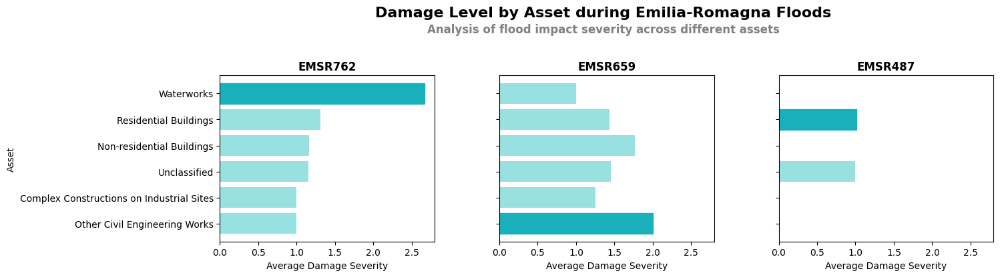

In [ ]:
# Mapping for renaming obj_type values
rename_dict = {
    '995-Unclassified': 'Unclassified',
    '23-Complex Constructions on Industrial Sites': 'Complex Constructions on Industrial Sites',
    '24-Other Civil Engineering Works': 'Other Civil Engineering Works',
    '11-Residential Buildings': 'Residential Buildings',
    '12-Non-residential Buildings': 'Non-residential Buildings',
    'Harbours, waterways, dams and other waterworks': 'Waterworks'
}

# Apply renaming to obj_type
EmiliaRom_floods['obj_type'] = EmiliaRom_floods['obj_type'].replace(rename_dict)

# Sort values for better visualization
mean_damage = EmiliaRom_floods.groupby(['EMSR_ID', 'obj_type'])['damage_gra_numeric'].mean().reset_index()
mean_damage = mean_damage.sort_values(by='damage_gra_numeric', ascending=False)

# Define colors
highlight_color = "#19b0bb"
other_bars_color = "#99e0e0"

# Create a facet grid for plotting
g = sns.FacetGrid(mean_damage, col='EMSR_ID', col_wrap=3, height=4, sharex=True, sharey=True, despine=False)

# Function to plot bars and highlight the max one
def highlight_max(data, **kwargs):
    ax = plt.gca()  # Get current axis
    data = data.sort_values(by="damage_gra_numeric", ascending=True)  # Keep order readable

    # Find max row
    max_idx = data['damage_gra_numeric'].idxmax()

    # Plot all bars in lighter blue
    bars = ax.barh(data['obj_type'], data['damage_gra_numeric'], color=other_bars_color)

    # Highlight max bar in `#19b0bb`
    bars[data.index.get_loc(max_idx)].set_color(highlight_color)

    # Hide y-axis labels except for the first facet
    if ax != g.axes.flat[0]:
        ax.set_yticklabels([])
        ax.set_ylabel("")

# Apply function to each facet
g.map_dataframe(highlight_max)

# Ensure only the first facet shows full y-axis labels
g.axes.flat[0].set_yticklabels(mean_damage['obj_type'].unique())

# Improve alignment and readability
g.set_axis_labels("Average Damage Severity", "Asset")  # Change "Object Type" to "Asset"
g.set_titles(col_template="{col_name}", size=12, weight='bold')  # Removes "Region:"

# Adjust layout to move graphs lower and avoid subtitle overlap
plt.subplots_adjust(top=0.72, hspace=0.6, wspace=0.3)

# Add title & subtitle
plt.suptitle("Damage Level by Asset during Emilia-Romagna Floods", fontsize=16, fontweight='bold', color='black', y=0.98)
plt.figtext(0.5, 0.88, "Analysis of flood impact severity across different assets",
            ha="center", fontsize=12, fontweight='bold', color='grey')
plt.show()


The above figure shows how different floods impacted the Emilia-Romagna region. As you can see Water Infrastructure, Civil Engineering Works, and Residential Buildings were impacted the most so we Eoliann should focus its information on those who sublease the Residential Buildings, Government officials who a incharge of Water Ifrastructure, and finally those who own and operate Civil engineering based plants.

So we are going to do an analysis on settlement types so I am going to reload the data without the previous bins

In [ ]:
EmiliaRom_floods_txt = Italy_floods_H[Italy_floods_H['EMSR_ID'].isin(['EMSR067', 'EMSR136', 'EMSR138', 'EMSR487', 'EMSR659', 'EMSR762'])]

In [ ]:
EmiliaRom_floods_txt['txt'].value_counts()

,count
txt,
yes,5559
NotApplicable,1342
Not Applicable,551
real,515
forest,335
representation,307
residential,242
Unk,172
"Aree prev. occup.da colture agrarie, con spazi nat.",101


In [ ]:
#count values in grading
EmiliaRom_floods_txt['grading'].value_counts()

,count
grading,
Null,6089
Unknown,2150
Possibly Affected,680
Not Applicable,340
Highly Affected,104
Moderately Damaged,17
Negligible to slight damage,14
Highly Damaged,8
Moderately Affected,8


Now we can assign bins to the new damage grading

In [ ]:
# Define the damage severity mapping
damage_severity_mapping = {
    'Null': 0,
    'Unknown': 0,
    'Possibly Affected': 1,
    'Not Applicable': 0,
    'Highly Affected': 3,
    'Moderately Damaged': 2,
    'Negligible to slight damage': 1,
    'Highly Damaged': 3,
    'Moderately Affected': 2,
    'Completely Destroyed': 0
}

# Apply the mapping to create a new column 'damage_severity_numeric' in the DataFrame
EmiliaRom_floods_txt['grading_numeric'] = EmiliaRom_floods_txt['grading'].replace(damage_severity_mapping)

# Check the result to verify the new column
EmiliaRom_floods_txt[['grading', 'grading_numeric']].head()


<ipython-input-46-06e52b0312ea>:16: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  EmiliaRom_floods_txt['grading_numeric'] = EmiliaRom_floods_txt['grading'].replace(damage_severity_mapping)
<ipython-input-46-06e52b0312ea>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  EmiliaRom_floods_txt['grading_numeric'] = EmiliaRom_floods_txt['grading'].replace(damage_severity_mapping)


,grading,grading_numeric
2129,NaN,NaN
2130,NaN,NaN
2131,NaN,NaN
2132,NaN,NaN
2133,NaN,NaN


In [ ]:
#Remove row when grading_numeric is nan
EmiliaRom_floods_txt = EmiliaRom_floods_txt.dropna(subset=['grading_numeric'])
#Remove row when grading_numeric is = 0 so we could only focus on what is being damaged
EmiliaRom_floods_txt = EmiliaRom_floods_txt[EmiliaRom_floods_txt['grading_numeric'] != 0]

In [ ]:
EmiliaRom_floods_txt['grading_numeric'] = EmiliaRom_floods_txt['grading_numeric'].astype(int)
EmiliaRom_floods_txt['grading_numeric']

,grading_numeric
13588,2
13589,2
13590,2
13591,2
13592,2
...,...
186116,1
186153,1
186154,1
186157,1


   Now showing another potential client

  This is another area with a large frequency of floods

In [ ]:
Marche_floods = Italy_floods_H[Italy_floods_H['EMSR_ID'].isin(['EMSR634', 'EMSR083', 'EMSR060'])]

We are going to do the same EDA's as before

In [ ]:
Marche_floods

,obj_type,name,info,simplified,damage_gra,det_method,notation,or_src_id,dmg_src_id,cd_value,...,evnt,imp_ass,evnt_type,popul,type,fuc,flood_type,fun,fucdesc,File_Group
18,12-Non-residential Buildings,Unknown,997-Not Applicable,NaN,Possibly damaged,Photo-interpretation,Building point,1.0,2.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI07_GRA_PRODUCT_builtUpP_r1.shp
19,12-Non-residential Buildings,Unknown,997-Not Applicable,NaN,Possibly damaged,Photo-interpretation,Building point,1.0,2.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI07_GRA_PRODUCT_builtUpP_r1.shp
20,12-Non-residential Buildings,Unknown,997-Not Applicable,NaN,Possibly damaged,Photo-interpretation,Building point,1.0,2.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI07_GRA_PRODUCT_builtUpP_r1.shp
21,12-Non-residential Buildings,Unknown,997-Not Applicable,NaN,Possibly damaged,Photo-interpretation,Building point,1.0,2.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI07_GRA_PRODUCT_builtUpP_r1.shp
22,12-Non-residential Buildings,Unknown,997-Not Applicable,NaN,Possibly damaged,Photo-interpretation,Building point,1.0,2.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI07_GRA_PRODUCT_builtUpP_r1.shp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177159,995-Unclassified,Unknown,997-Not Applicable,NaN,No visible damage,Photo-interpretation,Building point,994.0,2.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_builtUpP_r1.shp
177160,995-Unclassified,Unknown,997-Not Applicable,NaN,No visible damage,Photo-interpretation,Building point,994.0,2.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_builtUpP_r1.shp
177161,995-Unclassified,Unknown,997-Not Applicable,NaN,No visible damage,Photo-interpretation,Building point,994.0,2.0,Not Applicable,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AOI02_GRA_PRODUCT_builtUpP_r1.shp
178443,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,01SENIGALLIA_02GRADING_03DETAIL_12000_settleme...


In [ ]:
#drop columns with all nan
Marche_floods = Marche_floods.dropna(axis=1, how='all')

In [ ]:
Marche_floods.columns

Index(['obj_type', 'name', 'info', 'damage_gra', 'det_method', 'notation',
       'or_src_id', 'dmg_src_id', 'cd_value', 'geometry', 'EMSR_ID', 'Country',
       'Event_Type', 'Source_File', 'src_date', 'src_info', 'ext_scale', 'nam',
       'ext_date', 'txt', 'subtype', 'admin_lev', 'settl_type', 'functional',
       'source_nam', 'act_id', 'settl_acc', 'File_Group'],
      dtype='object')

In [ ]:
# Remove rows with NaN in 'damage_gra'
Marche_floods.dropna(subset=['damage_gra'], inplace=True)

<ipython-input-53-0c7b29c2f7cc>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Marche_floods.dropna(subset=['damage_gra'], inplace=True)


In [ ]:
Marche_floods['damage_gra'].value_counts()

,count
damage_gra,
No visible damage,12319
Possibly damaged,2182
Damaged,494
Destroyed,4


In [ ]:
# Define the mapping
damage_mapping = {
    'No visible damage' : 0,
    'Possibly damaged': 1,
    'Damaged': 2,
    'Destroyed': 3
}

# Apply the mapping to the 'damage_gra' column
Marche_floods['damage_gra_numeric'] = Marche_floods['damage_gra'].replace(damage_mapping)

<ipython-input-55-807daaf49124>:10: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  Marche_floods['damage_gra_numeric'] = Marche_floods['damage_gra'].replace(damage_mapping)
<ipython-input-55-807daaf49124>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Marche_floods['damage_gra_numeric'] = Marche_floods['damage_gra'].replace(damage_mapping)


In [ ]:
Marche_floods['damage_gra_numeric'] = Marche_floods['damage_gra_numeric'].astype(int)

<ipython-input-56-86974500c45b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Marche_floods['damage_gra_numeric'] = Marche_floods['damage_gra_numeric'].astype(int)


In [ ]:
#Summarize damage gra mean by assets
Marche_floods.groupby('obj_type')['damage_gra_numeric'].mean().sort_values(ascending=False)

,damage_gra_numeric
obj_type,
24-Other Civil Engineering Works,2.000000
12-Non-residential Buildings,0.586454
11-Residential Buildings,0.193582
995-Unclassified,0.166416
"22-Pipelines, Communication and Electricity Lines",0.000000


<ipython-input-58-e962144e8a2c>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Marche_floods['obj_type'] = Marche_floods['obj_type'].replace(rename_dict)
<ipython-input-58-e962144e8a2c>:18: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  Marche_floods_filtered['txt'] = Marche_floods_filtered['txt'].replace({'Agriculture': 'Agricultural', 'Agricultural': 'Agricultural'})
<ipython-input-58-e962144e8a2c>:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a 

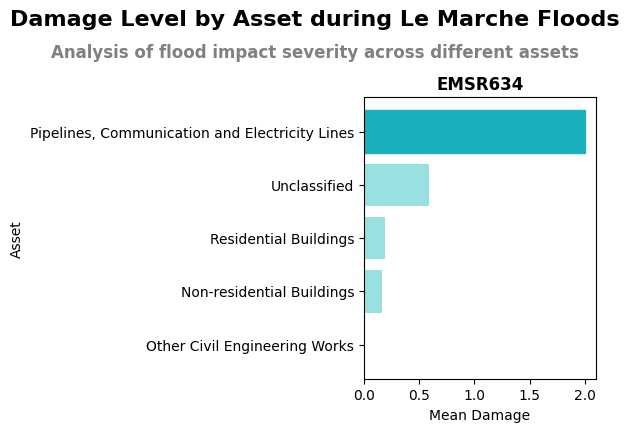

In [ ]:
# Mapping for renaming obj_type values
rename_dict = {
    '995-Unclassified': 'Unclassified',
    '23-Complex Constructions on Industrial Sites': 'Complex Constructions on Industrial Sites',
    '24-Other Civil Engineering Works': 'Other Civil Engineering Works',
    '11-Residential Buildings': 'Residential Buildings',
    '12-Non-residential Buildings': 'Non-residential Buildings',
    '215-Harbours, waterways, dams and other waterworks': 'Harbours, waterways, dams and other waterworks',
    '22-Pipelines, Communication and Electricity Lines': 'Pipelines, Communication and Electricity Lines'
}

# Ensure 'Marche_floods' dataset is used here
# Apply renaming to obj_type in Marche_floods dataset
Marche_floods['obj_type'] = Marche_floods['obj_type'].replace(rename_dict)

# Filter for the relevant data (only EMSR_IDs from Le Marche area, excluding 'Not Applicable' or 'Ukn')
Marche_floods_filtered = Marche_floods[~Marche_floods['txt'].isin(['Not Applicable', 'Ukn', 'Yes'])]
Marche_floods_filtered['txt'] = Marche_floods_filtered['txt'].replace({'Agriculture': 'Agricultural', 'Agricultural': 'Agricultural'})

# Sort values for better visualization
mean_damage = Marche_floods_filtered.groupby(['EMSR_ID', 'obj_type'])['damage_gra_numeric'].mean().reset_index()
mean_damage = mean_damage.sort_values(by='damage_gra_numeric', ascending=False)

# Define colors for the plot
highlight_color = "#19b0bb"
other_bars_color = "#99e0e0"

# Create a facet grid for plotting based on EMSR_IDs
g = sns.FacetGrid(mean_damage, col='EMSR_ID', col_wrap=3, height=4, sharex=True, sharey=True, despine=False)

# Function to plot bars and highlight the max one
def highlight_max(data, **kwargs):
    ax = plt.gca()  # Get current axis
    data = data.sort_values(by="damage_gra_numeric", ascending=True)  # Keep order readable

    # Find max row
    max_idx = data['damage_gra_numeric'].idxmax()

    # Plot all bars in lighter blue
    bars = ax.barh(data['obj_type'], data['damage_gra_numeric'], color=other_bars_color)

    # Highlight max bar in `#19b0bb`
    bars[data.index.get_loc(max_idx)].set_color(highlight_color)

    # Hide y-axis labels except for the first facet
    if ax != g.axes.flat[0]:
        ax.set_yticklabels([])  # Hide y-axis labels for all but the first facet
        ax.set_ylabel("")  # Remove label for non-first facets

# Apply function to each facet
g.map_dataframe(highlight_max)

# Ensure only the first facet shows full y-axis labels
g.axes.flat[0].set_yticklabels(mean_damage['obj_type'].unique())

# Improve alignment and readability
g.set_axis_labels("Mean Damage", "Asset")  # Change "Object Type" to "Asset"
g.set_titles(col_template="{col_name}", size=12, weight='bold')  # Removes "Region:"

# Adjust layout to move graphs lower and avoid subtitle overlap
plt.subplots_adjust(top=0.8, hspace=0.2, wspace=0.3)  # Increased top spacing

# Add title & subtitle with centering
plt.suptitle("Damage Level by Asset during Le Marche Floods",
             fontsize=16, fontweight='bold', color='black',
             y=1.02, x=0.25, ha='center')  # Added ha='center' for title

plt.figtext(0.25, 0.9, "Analysis of flood impact severity across different assets",  # Adjusted y position
            ha="center", fontsize=12, fontweight='bold', color='grey')


# Show plot
plt.show()


The above figure shows how different floods impacted the Emilia-Romagna region. As you can see Pipeline, Communication and Electicy Lines are the assets that are damaged the most. Based on this we would recommend targetting Telecommunication company that own telephone lines in the area and the Governing body that maintain the pipelines in the area.

IMPORT HANZE DATA

In [ ]:
#Load data
HANZE = pd.read_csv('/content/drive/MyDrive/Business Challenge II - Team 2/data/HANZE/cleaned_HANZE_events.csv')


In [ ]:
HANZE.columns

Index(['Year', 'Country', 'Start date', 'End date', 'Type', 'Flood source',
       'Regions affected (v2010)', 'Regions affected (v2021)', 'Area flooded',
       'Fatalities', 'Persons affected', 'Losses (nominal value)',
       'Losses (original currency)', 'Losses (2020 euro)', 'Cause', 'Notes',
       'References', 'Changes'],
      dtype='object')

In [ ]:
unique_losses = HANZE['Losses (2020 euro)'].unique()

# Print the unique values
print("Unique values in 'Losses (2020 euro)':")
print(unique_losses)

Unique values in 'Losses (2020 euro)':
[           nan 1.35599700e+06 2.85473100e+07 1.15663580e+07
 9.85640676e+08 1.28292350e+07 6.35075800e+06 3.39054210e+08
 2.10252152e+08 8.75634310e+07 2.93837017e+08 1.40736294e+09
 4.62519800e+06 3.96131225e+08 1.00987401e+08 9.77297400e+06
 6.32882200e+06 1.02858172e+08 1.46999500e+07 1.63904438e+08
 5.04208270e+07 2.93998990e+07 1.28263970e+07 4.24265400e+06
 4.09512500e+06 3.21255509e+08 1.62263681e+08 3.38891200e+06
 4.49448940e+07 6.28111900e+06 2.52978411e+08 1.48113824e+08
 7.94728769e+08 1.30133830e+07 9.72905810e+07 6.74257100e+06
 1.38663120e+09 1.16144230e+09 9.88999148e+08 1.08626740e+07
 1.07788042e+08 2.58691301e+08 8.08410320e+07 3.21509198e+08
 1.82188545e+08 1.60754599e+08 2.44346990e+08 6.35781600e+06
 9.00690627e+08 2.31908070e+09 4.53274860e+07 3.27081892e+08
 3.63424300e+06 3.01123012e+08 2.62975725e+08 4.60000000e+07
 2.17000000e+08 1.02681461e+09 4.13086340e+07 1.59333301e+08
 1.34292136e+08 9.20121529e+09 4.98433066e+08 

In [ ]:
# Calculate the percentage of null values
percent_null = HANZE['Losses (2020 euro)'].isnull().sum() / len(HANZE) * 100

# Print the percentage
print(f"Percentage of null values in 'Losses (2020 euro)': {percent_null:.2f}%")

Percentage of null values in 'Losses (2020 euro)': 41.88%


In [ ]:
HANZE_filtered = HANZE[['Area flooded', 'Losses (2020 euro)']]
HANZE_filtered.head() # To see the output, run the code.

,Area flooded,Losses (2020 euro)
0,101.0,NaN
1,15.0,1355997.0
2,24.0,NaN
3,139.0,28547310.0
4,NaN,NaN


In [ ]:
Italy_floods_H.columns

Index(['obj_type', 'name', 'info', 'simplified', 'damage_gra', 'det_method',
       'notation', 'or_src_id', 'dmg_src_id', 'cd_value', 'geometry',
       'EMSR_ID', 'Country', 'Event_Type', 'Source_File', 'src_date',
       'src_info', 'ext_scale', 'nam', 'ext_date', 'txt', 'subtype',
       'admin_lev', 'settl_type', 'functional', 'source_nam', 'event_type',
       'obj_desc', 'act_id', 'settl_acc', 'change_sta', 'grading', 'note',
       'oga', 'cpyrt_note', 'fcsubtype', 'src_name', 'objectid', 'fcode',
       'acc', 'nam_info', 'shape_Leng', 'shape_Area', 'SBTYPdes', 'intrp',
       'evnt', 'imp_ass', 'evnt_type', 'popul', 'type', 'fuc', 'flood_type',
       'fun', 'fucdesc', 'File_Group'],
      dtype='object')

Now we are going to merge the HANZE data to the Italy flood data and see if the is a match to assign a financial grade to damage

In [ ]:
# Ensure both 'Start date' and 'ext_date' are in datetime format
HANZE['Start date'] = pd.to_datetime(HANZE['Start date'])
Italy_floods_H['ext_date'] = pd.to_datetime(Italy_floods_H['ext_date'], errors='coerce')

# Drop rows with invalid dates in 'ext_date'
Italy_floods_H = Italy_floods_H.dropna(subset=['ext_date'])

# Left merge by start date and Country
merged_df = pd.merge(Italy_floods_H, HANZE,
                     how='left',  # Changed to 'left'
                     left_on=['ext_date', 'Country'],
                     right_on=['Start date', 'Country'])

# Filter for matching values (non-null in HANZE columns)
matching_values = merged_df[merged_df['Start date'].notnull()]

# Print the number of matching rows
print(f"Number of matching rows: {len(matching_values)}")

# Print the matching values (you can adjust which columns to print)
print(matching_values[['ext_date', 'Country', 'Area flooded', 'Losses (2020 euro)']])

<ipython-input-65-5e64c56d08fa>:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  Italy_floods_H['ext_date'] = pd.to_datetime(Italy_floods_H['ext_date'], errors='coerce')


Number of matching rows: 0
Empty DataFrame
Columns: [ext_date, Country, Area flooded, Losses (2020 euro)]
Index: []


Nothing matched so we there would be no insights to draw combining HANZE data

# STORMS

In [ ]:
storm_df = pd.read_csv('/content/drive/MyDrive/Business Challenge II - Team 2/data/storms/storms_combined.csv')

<ipython-input-76-0b573eaf4bb4>:1: DtypeWarning: Columns (29) have mixed types. Specify dtype option on import or set low_memory=False.
  storm_df = pd.read_csv('/content/drive/MyDrive/Business Challenge II - Team 2/data/storms/storms_combined.csv')


In [ ]:
damage = {
    'No visible damage': 'No Damage',
    'Not Affected': 'No Damage',
    'None': 'No Damage',
    'Not affected': 'No Damage',
    'Possibly Affected': 'Low Damage',
    'Negligible to slight damage': 'Low Damage',
    '2': 'Moderate Damage',
    '3': 'High Damage',
    '4': 'Very High Damage',
    '5': 'Destroyed',
    'Possibly damaged': 'Moderate Damage',
    'Moderately Damaged': 'Moderate Damage',
    'Moderately Affected': 'Moderate Damage',
    'Moderate damage': 'Moderate Damage',
    'Damaged': 'High Damage',
    'Highly Affected': 'High Damage',
    'High damage': 'High Damage',
    'Highly Damaged': 'High Damage',
    'Destroyed': 'Destroyed',
    'Completely Destroyed': 'Destroyed',
    'Very high damage': 'Very High Damage',
    'Totally Affected': 'High Damage',
    'Potentially Affected': 'Moderate Damage',
    'Affected': 'Moderate Damage',
    'Other': 'Other',
    'Unknown': 'Other',
    'Not Analysed': 'Other',
    'Unk': 'Other',
    '1': 'Other',
    '-128': 'Other'
}

storm_df['normalized_damage'] = storm_df['damage_gra'].map(damage)

damage_num = {
    'No Damage': 0,
    'Low Damage': 1,
    'Moderate Damage': 2,
    'High Damage': 3,
    'Very High Damage': 4,
    'Destroyed': 5,
    'Other': np.nan
}

storm_df['normalized_num_damage'] = storm_df['normalized_damage'].map(damage_num)



obj_type_mapping = {
    '3-Forests and Semi-natural Areas': 'Natural Areas',
    '362229': 'Natural Areas',
    '2-Agricultural Areas': 'Agricultural Areas',
    'Agriculture': 'Agricultural Areas',
    '211-Highways, Streets and Roads': 'Transportation',
    'AP030 - Road': 'Transportation',
    '212-Railways': 'Transportation',
    'AN010 - Railway': 'Transportation',
    '22-Pipelines, Communication and Electricity Lines': 'Utilities',
    'AQ040 - Bridge': 'Transportation',
    '215-Harbours, waterways, dams and other waterworks': 'Water Infrastructure',
    'BH140 - River': 'Water Infrastructure',
    'BH130 - Reservoir': 'Water Infrastructure',
    'BI020 - Dam': 'Water Infrastructure',
    'BB005 - Harbour': 'Water Infrastructure',
    'river': 'Water Infrastructure',
    '11-Residential Buildings': 'Residential',
    'Residential': 'Residential',
    'AL020 - Built Up Area': 'Residential',
    'AL021 - Building Block': 'Residential',
    'AL015 - Building': 'Residential',
    '12-Non-residential Buildings': 'Non-residential Buildings',
    'Industrial': 'Non-residential Buildings',
    'Commercial': 'Non-residential Buildings',
    'Medical': 'Non-residential Buildings',
    'Religious': 'Non-residential Buildings',
    'Institutional': 'Non-residential Buildings',
    'Educational': 'Non-residential Buildings',
    'AC000 - Processing Facility': 'Industrial',
    'AD010 - Power Station': 'Utilities',
    'AD030 - Power Substation': 'Utilities',
    'AM010 - Storage Depot': 'Industrial',
    'AM070 - Storage Tank': 'Industrial',
    'AM070 - StorageTank': 'Industrial',
    'AA012 - Quarry': 'Industrial',
    'AA010 - Extraction Mine': 'Industrial',
    '4-Wetlands': 'Natural Areas',
    'Green Area': 'Natural Areas',
    '24-Other Civil Engineering Works': 'Other Infrastructure',
    '23-Complex Constructions on Industrial Sites': 'Industrial',
    'Sports Ground': 'Recreational',
    'Recreational': 'Recreational',
    'AK040 - Sports Ground': 'Recreational',
    '213-Airfield': 'Transportation',
    'GB055 - Runway': 'Transportation',
    'GB005 - Aerodrome': 'Transportation',
    'GB030 - Helipad': 'Transportation',
    'AQ130 - Tunnel': 'Transportation',
    '214-Bridges, Elevated Highways, Tunnels and Subways': 'Transportation',
    'Urbanized Multi-functional': 'Other',
    'Cemetery': 'Other',
    'Transportation': 'Transportation',
    'Military': 'Other',
    'SU001 - Military Site': 'Other',
    'restaurant': 'Non-residential Buildings',
    'AN060 - Railway Yard': 'Transportation',
    'Stadium': 'Recreational'
}

# Create a new column with normalized categories
storm_df['normalized_obj_type'] = storm_df['obj_type'].map(obj_type_mapping)

Here I am just looking at what columns are in the storm csv

In [ ]:
storm_df.columns

Index(['src_date', 'ext_scale', 'nam', 'ext_date', 'txt', 'src_info', 'act_id',
       'change_sta', 'grading', 'road_type', 'functional', 'source_nam',
       'admin_lev', 'subtype', 'geometry', 'EMSR_ID', 'Country', 'Event_Type',
       'Source_File', 'obj_type', 'name', 'info', 'simplified', 'damage_gra',
       'det_method', 'notation', 'or_src_id', 'dmg_src_id', 'cd_value', 'real',
       'normalized_damage', 'normalized_num_damage', 'normalized_obj_type'],
      dtype='object')

Lets see which storm is the most dangerous

<ipython-input-79-2e30fda7517d>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='normalized_num_damage', y='normalized_obj_type', data=avg_damage_by_type, palette=colors)


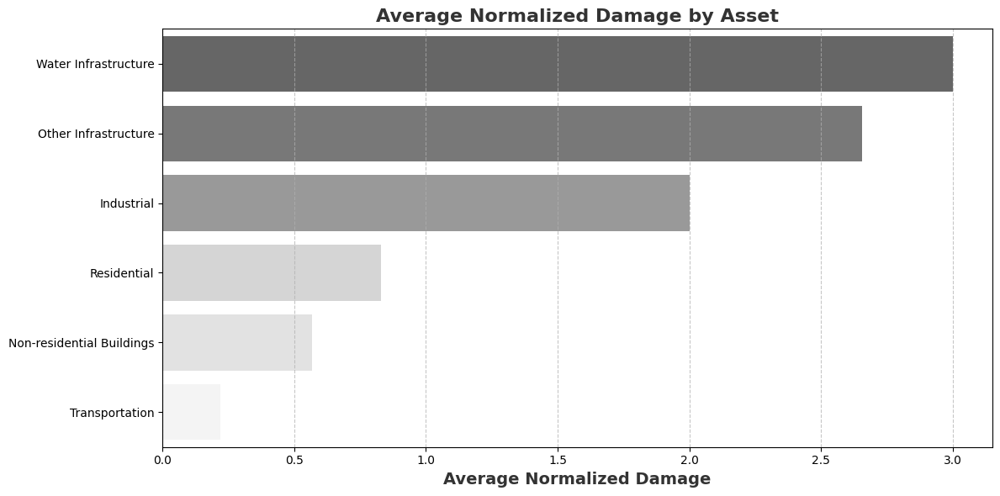

In [ ]:
# Finding average damage for each asset type
avg_damage_by_type = storm_df.groupby('normalized_obj_type')['normalized_num_damage'].mean().reset_index()

# Sorting the dataframe by 'normalized_num_damage' in descending order
avg_damage_by_type = avg_damage_by_type.sort_values('normalized_num_damage', ascending=False)

# Creating a color gradient to show the severity of the damage
cmap = plt.get_cmap('gray_r')
colors = [cmap(x / 5) for x in avg_damage_by_type['normalized_num_damage']]

plt.figure(figsize=(12, 6))

sns.barplot(x='normalized_num_damage', y='normalized_obj_type', data=avg_damage_by_type, palette=colors)

# Title and labels
plt.title('Average Normalized Damage by Asset', fontsize=16, fontweight='bold', color='#333333', ha='center')  # Title centered, bold, dark color
plt.xlabel('Average Normalized Damage', fontsize=14, fontweight='bold', color='#333333')  # Bold x-label
plt.ylabel('')  # Removing the y-label because it looked ugly


plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()



What is the storm that had the highest average damage

In [ ]:
avg_damage_by_emsr = storm_df.groupby('EMSR_ID')['normalized_num_damage'].mean().reset_index()

In [ ]:
avg_damage_by_emsr = avg_damage_by_emsr.sort_values('normalized_num_damage', ascending=False)

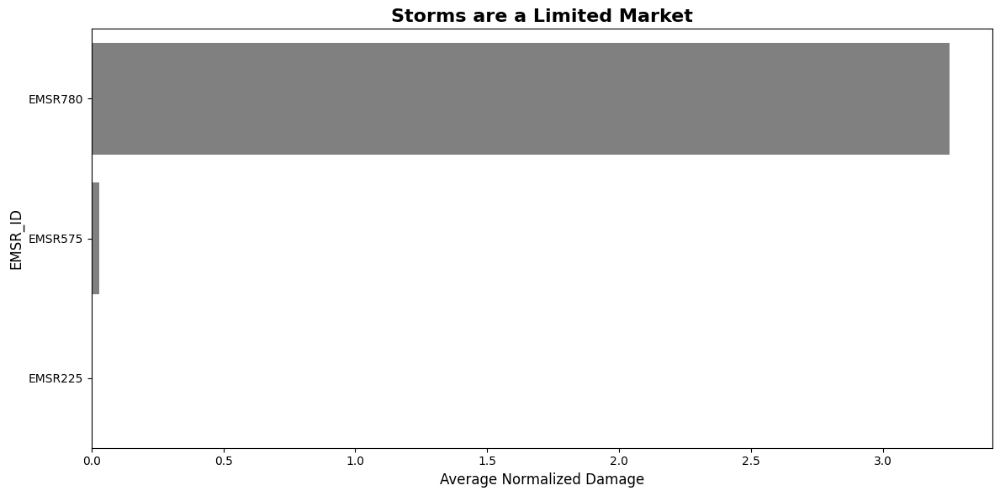

In [ ]:
#Now plotting the top 3 storms by average damage
top_3_avg_damage = avg_damage_by_emsr.nlargest(3, 'normalized_num_damage')



plt.figure(figsize=(12, 6))

sns.barplot(x='normalized_num_damage', y='EMSR_ID', data=top_3_avg_damage, color='gray')

# Title and labels
plt.title('Storms are a Limited Market', fontsize=16, fontweight='bold')
plt.xlabel('Average Normalized Damage', fontsize=12)
plt.ylabel('EMSR_ID', fontsize=12)
plt.tight_layout()
plt.show()


As you can see from this ESMR780 outclassed every other storm. Looking in to copernicus EMSR 780 is link to a storm in Mayotte

The following is looking to see how many assets there are in the storm data

In [ ]:

water_infrastructure_df = storm_df[storm_df['normalized_obj_type'] == 'Water Infrastructure']
water_infrastructure_count = len(water_infrastructure_df)
print(f"Number of Water Infrastructure: {water_infrastructure_count}")

Number of Water Infrastructure: 1


Lets see where it is

In [ ]:
industrial_emsr_ids = storm_df[storm_df['normalized_obj_type'] == 'Water Infrastructure']['EMSR_ID'].unique()
print(industrial_emsr_ids)

['EMSR780']


In [ ]:
# Filter for Other Infrastructure
other_infrastructure_df = storm_df[storm_df['normalized_obj_type'] == 'Other Infrastructure']

# Get the count
other_infrastructure_count = len(other_infrastructure_df)

# Print the count
print(f"Number of Other Infrastructure: {other_infrastructure_count}")

Number of Other Infrastructure: 26


Lets see where they are

In [ ]:
other_emsr_ids = storm_df[storm_df['normalized_obj_type'] == 'Other Infrastructure']['EMSR_ID'].unique()
print(other_emsr_ids)

['EMSR780']


It seem that the storm in mayotte france caused alot of damage  lets see if all the industrial facilities are in that storm


In [ ]:
industrial_count = storm_df['normalized_obj_type'].value_counts()['Industrial']
print(f"Number of Industrial: {industrial_count}")

Number of Industrial: 2


In [ ]:
industrial_emsr_ids = storm_df[storm_df['normalized_obj_type'] == 'Industrial']['EMSR_ID'].unique()
print(industrial_emsr_ids)

['EMSR780']


It is in that storm so let us now see how much of each asset was affected by the storm

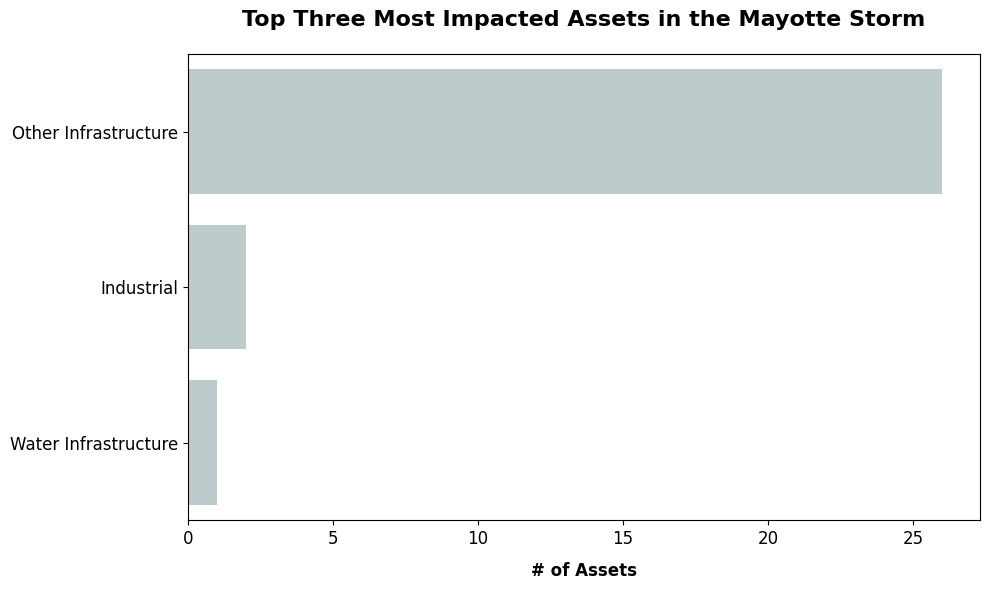

In [ ]:
# First start by looking a the top three impacted assets

# Filter the dataframe for EMSR780
filtered_df = storm_df[storm_df['EMSR_ID'] == 'EMSR780']

# Define the first category of object types
category_1 = ['Industrial', 'Other Infrastructure', 'Water Infrastructure']

# Filter data for category 1
filtered_df_cat1 = filtered_df[filtered_df['normalized_obj_type'].isin(category_1)]

# Create the sideways bar plot for category 1
plt.figure(figsize=(10, 6))

# Create the bar plot with horizontal bars and custom color
sns.countplot(y='normalized_obj_type', data=filtered_df_cat1, order=filtered_df_cat1['normalized_obj_type'].value_counts().index, color='#bacdcf')

# Apply CRAP principles
plt.title('Top Three Most Impacted Assets in the Mayotte Storm', fontsize=16, weight='bold', color='black', pad=20)
plt.xlabel('# of Assets', fontsize=12, weight='bold', color='black', labelpad=10)
plt.ylabel('')
plt.xticks(fontsize=12, color='black')
plt.yticks(fontsize=12, color='black')

# Adjust the labels for better alignment and spacing
plt.tight_layout()

plt.show()




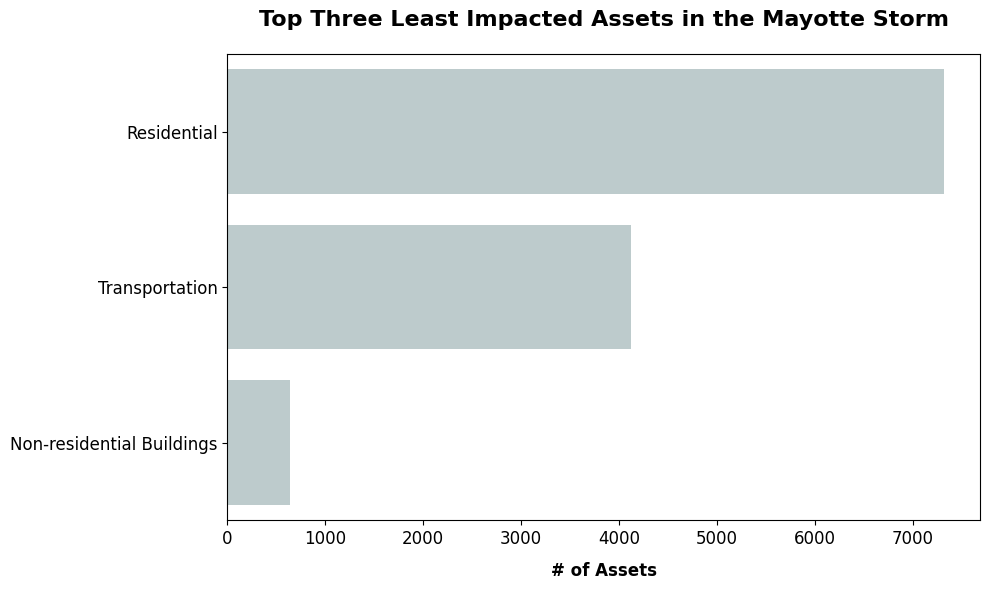

In [ ]:
# Define the second category of object types
category_2 = ['Transportation', 'Residential', 'Non-residential Buildings']
filtered_df_cat2 = filtered_df[filtered_df['normalized_obj_type'].isin(category_2)]


plt.figure(figsize=(10, 6))


sns.countplot(y='normalized_obj_type', data=filtered_df_cat2, order=filtered_df_cat2['normalized_obj_type'].value_counts().index, color='#bacdcf')
plt.title('Top Three Least Impacted Assets in the Mayotte Storm', fontsize=16, weight='bold', color='black', pad=20)
plt.xlabel('# of Assets', fontsize=12, weight='bold', color='black', labelpad=10)
plt.ylabel('')
plt.xticks(fontsize=12, color='black')
plt.yticks(fontsize=12, color='black')
plt.tight_layout()
plt.show()


The Mayottee Storm appears to have caused significant damage. Let's examine which asset was most affected on average.


<ipython-input-91-fa4dfc21edaf>:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='normalized_num_damage', y='normalized_obj_type', data=avg_damage_by_type, palette=colors)


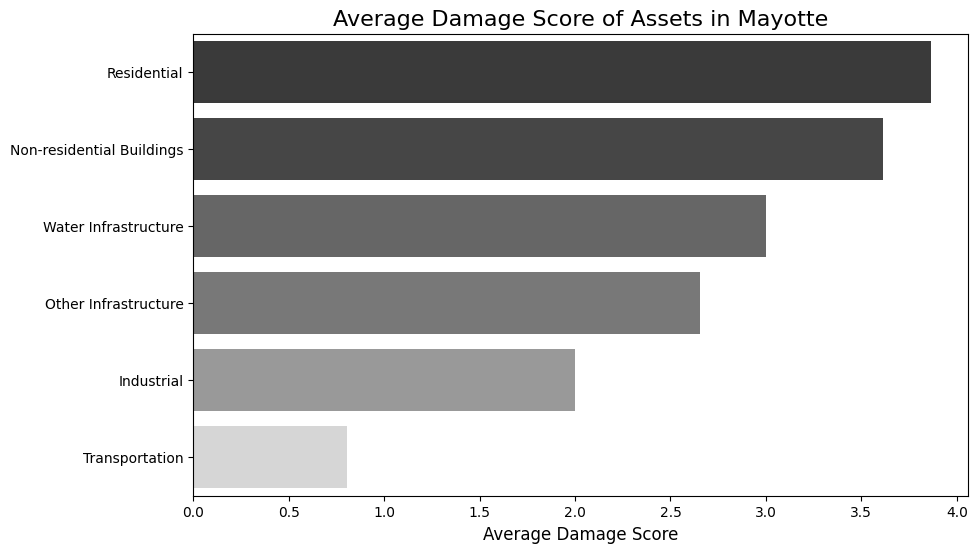

In [ ]:
# Filtering to the mayottee story
filtered_df = storm_df[storm_df['EMSR_ID'] == 'EMSR780']

# Calculate the average damage score for each normalized_obj_type
avg_damage_by_type = filtered_df.groupby('normalized_obj_type')['normalized_num_damage'].mean().reset_index()

# Sort the dataframe by average damage score in descending order
avg_damage_by_type = avg_damage_by_type.sort_values('normalized_num_damage', ascending=False)

# Create a colormap for the gradient
cmap = plt.get_cmap('gray_r')  # Reversed gray colormap (darker for higher values)
colors = [cmap(x / 5) for x in avg_damage_by_type['normalized_num_damage']]  # Normalize to 0-5 range

# Create the sideways bar plot
plt.figure(figsize=(10, 6))  # Adjust figure size as needed
sns.barplot(x='normalized_num_damage', y='normalized_obj_type', data=avg_damage_by_type, palette=colors)

# Set title and labels
plt.title('Average Damage Score of Assets in Mayotte', fontsize=16)
plt.xlabel('Average Damage Score', fontsize=12)
plt.ylabel('')  # Remove the "Normalized Object Type" label

# Show the plot
plt.show()


It seems that Building and other facilities were impacted the most lets make a map of the storm to better view what has happened.

## MAP

✅ Found 7 AOI SHP files for France.
✅ France Bounding Box: [ 5026555.90005438 -1452195.55484807  5041616.45021886 -1428704.97192703]
✅ Found 7 AOI SHP files for France.
✅ France AOI Bounding Box: [ 5026555.90005438 -1452195.55484807  5041616.45021886 -1428704.97192703]
✅ Found 7 AOIs in the filtered France bounding box.
✅ Coal: 0 power plants in France AOI.
✅ Gas: 0 power plants in France AOI.
✅ Oil: 0 power plants in France AOI.
✅ Nuclear: 0 power plants in France AOI.
✅ Biomass_Geothermal: 0 power plants in France AOI.
✅ Hydro: 0 power plants in France AOI.
✅ Solar: 0 power plants in France AOI.
✅ Wind: 0 power plants in France AOI.
✅ Metal Industry: 0 industries in France AOI.
✅ Mineral Industry: 0 industries in France AOI.
✅ Chemical Industry: 0 industries in France AOI.
✅ Refineries: 0 industries in France AOI.
✅ Water & Waste Treatment: 0 industries in France AOI.


<ipython-input-92-f1ddd7d61a44>:166: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
<ipython-input-92-f1ddd7d61a44>:166: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


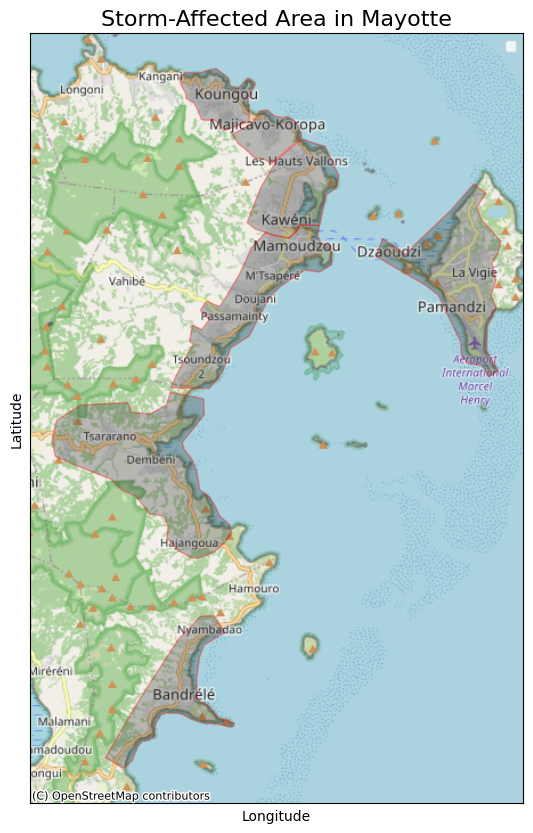

In [ ]:
# The below Plots the area where the storms hit
# File paths
france_shp_folder = "/content/drive/MyDrive/Business Challenge II - Team 2/data/storms/France"  # AOI SHP folder
energy_tif_paths = {
    "Coal": "/content/HARCI_EU_Download_Unzipped/ci_ene01.tif",
    "Gas": "/content/HARCI_EU_Download_Unzipped/ci_ene02.tif",
    "Oil": "/content/HARCI_EU_Download_Unzipped/ci_ene03.tif",
    "Nuclear": "/content/HARCI_EU_Download_Unzipped/ci_ene04.tif",
    "Biomass_Geothermal": "/content/HARCI_EU_Download_Unzipped/ci_ene05.tif",
    "Hydro": "/content/HARCI_EU_Download_Unzipped/ci_ene06.tif",
    "Solar": "/content/HARCI_EU_Download_Unzipped/ci_ene07.tif",
    "Wind": "/content/HARCI_EU_Download_Unzipped/ci_ene08.tif"
}

industry_tif_paths = {
    "Metal Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind01.tif",
    "Mineral Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind02.tif",
    "Chemical Industry": "/content/HARCI_EU_Download_Unzipped/ci_ind03.tif",
    "Refineries": "/content/HARCI_EU_Download_Unzipped/ci_ind04.tif",
    "Water & Waste Treatment": "/content/HARCI_EU_Download_Unzipped/ci_ind05.tif"
}

# AOI File Matching Regex (Case-Insensitive "area" in filename)
AOI_PATTERN = re.compile(r"area.*\.shp$", re.IGNORECASE)

# Load & Merge Only SHP Files Matching "area"
france_shp_files = list({
    os.path.join(root, file)
    for root, _, files in os.walk(france_shp_folder)
    for file in files if AOI_PATTERN.search(file)
})

if not france_shp_files:
    print("⚠️ No AOI SHP files found for France!")
    france_gdf = None
else:
    print(f"✅ Found {len(france_shp_files)} AOI SHP files for France.")

    # Load and merge all AOI SHP files
    gdfs = []
    for shp in france_shp_files:
        gdf = gpd.read_file(shp)
        if gdf.crs is not None and gdf.crs.to_epsg() != 3857:
            gdf = gdf.to_crs(epsg=3857)  # Convert to EPSG:3857
        gdfs.append(gdf)

    france_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ 1. Get Correct Bounding Box for France AOIs
france_bounds = france_gdf.total_bounds
print("✅ France Bounding Box:", france_bounds)

# ✅ 2. Create France Bounding Box Geometry
france_bbox = box(*france_bounds)
france_polygon = gpd.GeoDataFrame(geometry=[france_bbox], crs=france_gdf.crs)

# ✅ 3. Filter AOIs that intersect the France bounding box
france_aoi = france_gdf[france_gdf.geometry.intersects(france_polygon.geometry.iloc[0])]

if len(france_aoi) == 0:
    print("⚠️ No AOIs found in the France bounding box!")
else:
    print(f"✅ Found {len(france_aoi)} AOI SHP files for France.")

# ✅ 4. Define Bounding Box for France AOI
france_aoi_bounds = france_aoi.total_bounds  # Get total bounds for the filtered AOI
print("✅ France AOI Bounding Box:", france_aoi_bounds)

# ✅ 5. Filter AOIs in the bounding box for the specific region of interest
france_filtered_gdf = france_gdf.cx[
    france_aoi_bounds[0]:france_aoi_bounds[2],
    france_aoi_bounds[1]:france_aoi_bounds[3]
]

if france_filtered_gdf.empty:
    print("⚠️ No AOIs found in the filtered bounding box!")
else:
    print(f"✅ Found {len(france_filtered_gdf)} AOIs in the filtered France bounding box.")

# ✅ Load Energy & Industry Locations from TIF Files
ENERGY_COLORS = {
    "Coal": "black", "Gas": "blue", "Oil": "brown",
    "Nuclear": "red", "Biomass_Geothermal": "green",
    "Hydro": "cyan", "Solar": "orange", "Wind": "purple"
}
ENERGY_SHAPES = {
    "Coal": "o", "Gas": "s", "Oil": "D",
    "Nuclear": "*", "Biomass_Geothermal": "p",
    "Hydro": "H", "Solar": "^", "Wind": "v"
}

INDUSTRY_COLORS = {
    "Metal Industry": "gray", "Mineral Industry": "yellow",
    "Chemical Industry": "magenta", "Refineries": "brown",
    "Water & Waste Treatment": "black"
}
INDUSTRY_SHAPES = {
    "Metal Industry": "X", "Mineral Industry": "s",
    "Chemical Industry": "d", "Refineries": "P",
    "Water & Waste Treatment": "x"
}

energy_points = {key: [] for key in energy_tif_paths.keys()}
industry_points = {key: [] for key in industry_tif_paths.keys()}

# Function to extract valid points from TIF and filter by AOI
def extract_points_from_tif(tif_path, aoi_gdf):
    with rasterio.open(tif_path) as src:
        data = src.read(1)
        transform = src.transform
        nodata_value = src.nodata

        # Mask NoData and find non-zero values
        valid_pixels = np.where((data != nodata_value) & (data > 0))
        x_coords, y_coords = rasterio.transform.xy(transform, valid_pixels[0], valid_pixels[1])


        points_gdf = gpd.GeoDataFrame(geometry=gpd.points_from_xy(x_coords, y_coords), crs=src.crs)

        # Converting file to CRS if necessary
        if points_gdf.crs.to_epsg() != 3857:
            points_gdf = points_gdf.to_crs(epsg=3857)

        # Keep only points within AOI flood boundaries
        points_gdf = gpd.sjoin(points_gdf, aoi_gdf, predicate="within")

        return points_gdf.geometry.tolist()

# Extract energy plants within AOI flood areas
for energy_type, tif_path in energy_tif_paths.items():
    energy_points[energy_type] = extract_points_from_tif(tif_path, france_filtered_gdf)
    print(f"✅ {energy_type}: {len(energy_points[energy_type])} power plants in France AOI.")

# Extract industry locations within AOI flood areas
for industry_type, tif_path in industry_tif_paths.items():
    industry_points[industry_type] = extract_points_from_tif(tif_path, france_filtered_gdf)
    print(f"✅ {industry_type}: {len(industry_points[industry_type])} industries in France AOI.")

# ✅ Plot France AOI Map with Energy Plants & Industries
fig, ax = plt.subplots(figsize=(10, 10))

# Highlight AOI regions with a dark grey shade
france_filtered_gdf.plot(ax=ax, color="#333333", alpha=0.3, edgecolor="red", linewidth=1.2, label="France AOI Boundaries")

# Plot Energy Plants
for energy_type, points in energy_points.items():
    if points:
        x_vals = [p.x for p in points]
        y_vals = [p.y for p in points]
        ax.scatter(x_vals, y_vals, color=ENERGY_COLORS[energy_type], marker=ENERGY_SHAPES[energy_type], s=50, label=f"{energy_type} Plants")

# Plot Industry Locations
for industry_type, points in industry_points.items():
    if points:
        x_vals = [p.x for p in points]
        y_vals = [p.y for p in points]
        ax.scatter(x_vals, y_vals, color=INDUSTRY_COLORS[industry_type], marker=INDUSTRY_SHAPES[industry_type], s=60, label=f"{industry_type}")

# Add Basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# ✅ Label & Save Plot
ax.set_title("Storm-Affected Area in Mayotte", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.legend()
ax.set_xticks([])
ax.set_yticks([])
plt.show()


✅ Found 7 AOI SHP files with 'area' or 'facilities' for France.
✅ Total bounds of all AOIs: [ 5028824.72319034 -1449672.97030209  5040116.64950989 -1429155.10973523]
✅ Found 29 AOIs in the region within the bounding box.


<ipython-input-93-62001337397f>:67: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
<ipython-input-93-62001337397f>:67: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


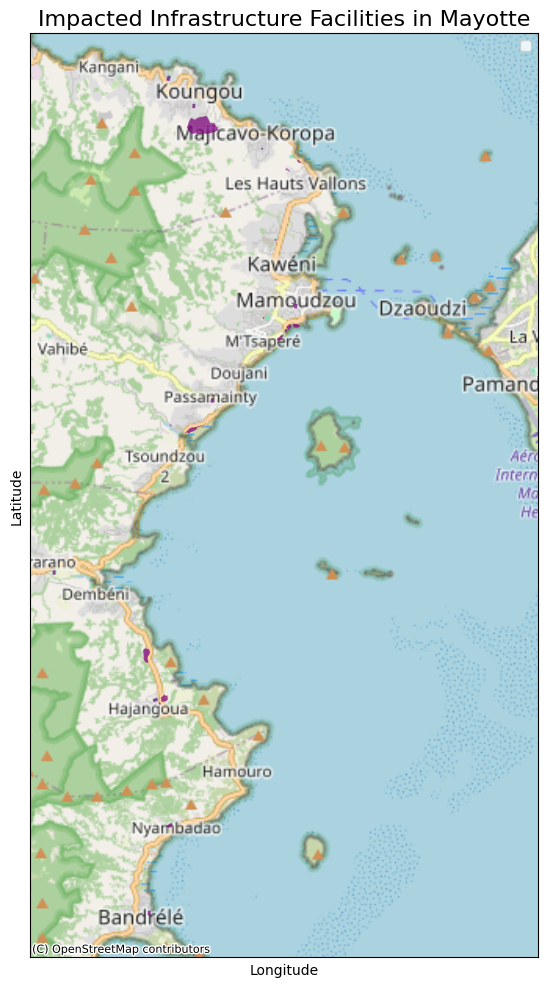

In [ ]:

# 🚀 File paths
france_shp_folder = "/content/drive/MyDrive/Business Challenge II - Team 2/data/storms/France"  # AOI SHP folder

# ✅ AOI File Matching Regex (Case-Insensitive "area" and "facilities" in filename)
AOI_FACILITY_PATTERN = re.compile(r"(facilities).*\.shp$", re.IGNORECASE)

# ✅ Load & Merge Only SHP Files Matching "area" or "facilities"
france_shp_files = list({
    os.path.join(root, file)
    for root, _, files in os.walk(france_shp_folder)
    for file in files if AOI_FACILITY_PATTERN.search(file)
})  # Use set() to avoid duplicates

if not france_shp_files:
    print("⚠️ No AOI SHP files with 'area' or 'facilities' found!")
    france_gdf = None
else:
    print(f"✅ Found {len(france_shp_files)} AOI SHP files with 'area' or 'facilities' for France.")

    # Load and merge all AOI SHP files (Ensure CRS is EPSG:3857 for basemap)
    gdfs = []
    for shp in france_shp_files:
        gdf = gpd.read_file(shp)
        if gdf.crs is not None and gdf.crs.to_epsg() != 3857:
            gdf = gdf.to_crs(epsg=3857)  # Convert to EPSG:3857
        gdfs.append(gdf)

    france_gdf = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

# ✅ Separate area and facilities shapefiles by file name pattern (NOT by geometry content)
france_area_gdf = france_gdf[france_gdf['geometry'].notnull()]
france_facility_gdf = france_gdf[france_gdf['geometry'].notnull()]

# ✅ Inspect the overall extent (bounding box) of the loaded SHP files
overall_bounds = france_gdf.total_bounds
print(f"✅ Total bounds of all AOIs: {overall_bounds}")

# ✅ Define the bounding box using the extent of the SHP files (in the same CRS)
xmin, ymin, xmax, ymax = overall_bounds

# ✅ Filter AOIs in the dynamically calculated bounding box
france_filtered_gdf = france_gdf.cx[
    xmin:xmax,
    ymin:ymax
]

if france_filtered_gdf.empty:
    print("⚠️ No AOIs found in the calculated bounding box!")
else:
    print(f"✅ Found {len(france_filtered_gdf)} AOIs in the region within the bounding box.")

# ✅ Plot France AOI Map with Energy Plants & Industries
fig, ax = plt.subplots(figsize=(12, 12))



# Plot Facilities with Purple Gradient (only the "facilit" ones)
france_facility_gdf.plot(ax=ax, color='purple', alpha=0.7, linewidth=2, label="Facilities")

# Add Basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# ✅ Label & Save Plot
ax.set_title("Impacted Infrastructure Facilities in Mayotte", fontsize=16)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.legend()
ax.set_xticks([])
ax.set_yticks([])
plt.show()


# References

OpenAI. (2025, February 27). ChatGPT. https://chat.openai.com

## Group 2 Memebers

Michael Holmes

Juan Diego Hernandez

Jose Eduardo Valle

Claudia Betbese

Isabel Garcia

Harsh Kammath